In [1]:
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px

import random
import matplotlib.colors as mcolors

import seaborn as sns
import numpy as np
import pandas as pd
import datetime
import geopandas as gpd
from mpl_toolkits.axes_grid1 import make_axes_locatable 

from sklearn.cluster import KMeans
from sklearn.utils import resample
from collections import Counter

from imblearn.under_sampling import NearMiss
from imblearn.over_sampling import SMOTENC
from scipy.stats import ttest_ind,chi2_contingency, ks_2samp, wasserstein_distance

import squarify  

In [2]:
def prueba_chi_cuadrada(contingency_table):
    chi2, p, dof, expected = chi2_contingency(contingency_table)
    print(f"\nChi-cuadrado: {chi2}") #A mayor valor se sugiere una posible asociación entre variables
    print(f"\np-value: {p}") #Un valor muy pequeño indica que es poco probable que la discrepancia entre las observaciones sea por
    # el azar, por lo que se rechaza la hipótesis nula de que no existe asociación entre variables.
    print(f"\nGrados de libertad: {dof}")
    print("\nTabla esperada:") #Valores esperados por la tabla de contingencia, en caso de que la hipótesis nula sea verdadera.
    print("\n",expected) #Resultados esperados
    
    #Cálculo del valor de Crámer para la prueba Chi cuadrada. 
    #0.1 -----> Valor de efecto pequeño
    #0.3 -----> Valor de efecto mediano
    #0.5 -----> Valor de efecto grande

    #Debe interpretarse en conjunto con el valor de chi2 y el p valor obtenido para decidir si existe relación de importancia
    #práctica y significancia estadística.
    
    # Indica la magnitud de asociación entre variables, para interpretarse acompañando al p value y determinar si existe
    # una importancia práctica de los resultados encontrados mediante el test de chi cuadrada como estadísticamente
    # significativos.
    k = min(contingency_table.shape)
    n = np.sum(contingency_table)
    n = np.sum(n)
    cramers_v = np.sqrt(chi2 / (n * (k - 1)))
    print(f"\nValor de Cramér: {cramers_v}")
    
    if( p < 0.05 and cramers_v >=0.25):
        print("\nEXISTE RELACIÓN ENTRE LAS VARIABLES")
    elif ( p < 0.05 and (0.090 < cramers_v < 0.25) ):
        print("\nEXISTE UNA ASOCIACIÓN PEQUEÑA ENTRE LAS VARIABLES")
    elif ( p >0.05):
        print("\nNO SE ENCONTRÓ UNA ASOCIACIÓN SIGNIFICATIVA ENTRE LAS VARIABLES")
    else:
        print("\n\LA ASOCIACIÓN ENTRE LAS VARIABLES ES SIGNIFICATIVA PERO MUY PEQUEÑA")

In [3]:
COVID = pd.read_csv("mexico_covid19.csv")

## **Preprocesamiento de datos y EDA**

In [4]:
COVID.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 263007 entries, 0 to 263006
Data columns (total 41 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   id                   263007 non-null  int64  
 1   FECHA_ARCHIVO        263007 non-null  object 
 2   ID_REGISTRO          263007 non-null  object 
 3   ENTIDAD_UM           263007 non-null  int64  
 4   ENTIDAD_RES          263007 non-null  int64  
 5   RESULTADO            263007 non-null  int64  
 6   DELAY                263007 non-null  int64  
 7   ENTIDAD_REGISTRO     263007 non-null  int64  
 8   ENTIDAD              263007 non-null  object 
 9   ABR_ENT              263007 non-null  object 
 10  FECHA_ACTUALIZACION  263007 non-null  object 
 11  ORIGEN               263007 non-null  int64  
 12  SECTOR               263007 non-null  int64  
 13  SEXO                 263007 non-null  int64  
 14  ENTIDAD_NAC          263007 non-null  int64  
 15  MUNICIPIO_RES    

In [5]:
pd.set_option('display.max_columns', None)
COVID.describe()

,id,ENTIDAD_UM,ENTIDAD_RES,RESULTADO,DELAY,ENTIDAD_REGISTRO,ORIGEN,SECTOR,SEXO,ENTIDAD_NAC,MUNICIPIO_RES,TIPO_PACIENTE,INTUBADO,NEUMONIA,EDAD,NACIONALIDAD,EMBARAZO,HABLA_LENGUA_INDIG,DIABETES,EPOC,ASMA,INMUSUPR,HIPERTENSION,OTRA_COM,CARDIOVASCULAR,OBESIDAD,RENAL_CRONICA,TABAQUISMO,OTRO_CASO,MIGRANTE,UCI
count,2.630070e+05,263007.000000,263007.000000,263007.000000,263007.0,263007.000000,263007.000000,263007.000000,263007.000000,263007.000000,263001.000000,263007.000000,263007.000000,263007.000000,263007.000000,263007.000000,263007.000000,263007.000000,263007.000000,263007.000000,263007.000000,263007.000000,263007.000000,263007.000000,263007.000000,263007.000000,263007.000000,263007.000000,263007.000000,263007.000000,263007.000000
mean,2.946176e+06,14.844601,15.127719,1.609672,0.0,15.092271,1.635789,9.601680,1.510682,19.691004,36.441401,1.236378,74.543362,1.842993,42.591627,1.007509,50.708825,4.579851,2.239712,2.320102,2.300711,2.359667,2.174185,2.453961,2.324980,2.184763,2.320231,2.268217,32.283764,98.593680,74.541012
std,2.212368e+06,8.001043,7.904314,0.487825,0.0,7.915406,0.481209,7.265468,0.499887,19.378113,48.117024,0.424858,40.379846,0.798979,16.903824,0.086330,47.494775,15.642049,5.958047,5.704424,5.682309,6.021830,5.745114,6.850231,5.796086,5.817362,5.722995,5.867586,45.350310,6.275497,40.384991
min,1.000000e+00,1.000000,1.000000,1.000000,0.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,8.689635e+05,9.000000,9.000000,1.000000,0.0,9.000000,1.000000,4.000000,1.000000,9.000000,7.000000,1.000000,97.000000,2.000000,31.000000,1.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,1.000000,99.000000,97.000000
50%,2.733242e+06,14.000000,15.000000,2.000000,0.0,15.000000,2.000000,12.000000,2.000000,15.000000,19.000000,1.000000,97.000000,2.000000,41.000000,1.000000,97.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,99.000000,97.000000
75%,4.789668e+06,21.000000,21.000000,2.000000,0.0,21.000000,2.000000,12.000000,2.000000,24.000000,48.000000,1.000000,97.000000,2.000000,53.000000,1.000000,97.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,99.000000,99.000000,97.000000
max,7.277125e+06,32.000000,32.000000,2.000000,0.0,32.000000,2.000000,99.000000,2.000000,99.000000,999.000000,2.000000,99.000000,99.000000,120.000000,2.000000,98.000000,99.000000,98.000000,98.000000,98.000000,98.000000,98.000000,98.000000,98.000000,98.000000,98.000000,98.000000,99.000000,99.000000,99.000000


In [6]:
#Nos deshacemos de las columnasque no nos proporcionan nada de información relevante para el análisis
pd.reset_option('display.max_columns')
COVID.drop(columns = ["DELAY", "ABR_ENT", "ENTIDAD_NAC","ID_REGISTRO"], inplace = True)

In [7]:
COVID_CATEGORIAS_INTERES = COVID[["NEUMONIA","DIABETES", "EPOC", "ASMA", "INMUSUPR", "HIPERTENSION", "OTRA_COM", "CARDIOVASCULAR", 
                   "OBESIDAD", "RENAL_CRONICA", "TABAQUISMO", "EMBARAZO","INTUBADO", "UCI"]]

In [8]:
#Se visualizan la cantidad de datos 1:SI, 2:NO, 99: No especificado, 98: Se ignora, 97: No aplica y se observa que son mínimos
conteos_df = pd.DataFrame()

for column in COVID_CATEGORIAS_INTERES.columns:
    conteos = COVID[column].value_counts().reset_index()
    conteos.columns = ['Valor', column]

    conteos_df = pd.concat([conteos_df, conteos.set_index('Valor')], axis=1)

conteos_df

,NEUMONIA,DIABETES,EPOC,ASMA,INMUSUPR,HIPERTENSION,OTRA_COM,CARDIOVASCULAR,OBESIDAD,RENAL_CRONICA,TABAQUISMO,EMBARAZO,INTUBADO,UCI
Valor,,,,,,,,,,,,,,
2,220341.0,227986.0,256889.0,252565.0,256916.0,217833.0,252034.0,255262.0,218287.0,256341.0,238296.0,126077.0,58247.0,57433.0
1,42652.0,34010.0,5187.0,9519.0,5053.0,44236.0,9629.0,6784.0,43758.0,5729.0,23729.0,2064.0,3884.0,4696.0
99,14.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,38.0,40.0
98,NaN,1011.0,931.0,923.0,1038.0,938.0,1344.0,961.0,962.0,937.0,982.0,556.0,NaN,NaN
97,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,134310.0,200838.0,200838.0


In [9]:
COVID =COVID[~COVID[COVID_CATEGORIAS_INTERES.columns].isin([98, 99]).any(axis=1)]
COVID.info()

<class 'pandas.core.frame.DataFrame'>
Index: 260372 entries, 0 to 263006
Data columns (total 37 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   id                   260372 non-null  int64  
 1   FECHA_ARCHIVO        260372 non-null  object 
 2   ENTIDAD_UM           260372 non-null  int64  
 3   ENTIDAD_RES          260372 non-null  int64  
 4   RESULTADO            260372 non-null  int64  
 5   ENTIDAD_REGISTRO     260372 non-null  int64  
 6   ENTIDAD              260372 non-null  object 
 7   FECHA_ACTUALIZACION  260372 non-null  object 
 8   ORIGEN               260372 non-null  int64  
 9   SECTOR               260372 non-null  int64  
 10  SEXO                 260372 non-null  int64  
 11  MUNICIPIO_RES        260366 non-null  float64
 12  TIPO_PACIENTE        260372 non-null  int64  
 13  FECHA_INGRESO        260372 non-null  object 
 14  FECHA_SINTOMAS       260372 non-null  object 
 15  FECHA_DEF            2

In [10]:
COVID.isna().sum()

id                     0
FECHA_ARCHIVO          0
ENTIDAD_UM             0
ENTIDAD_RES            0
RESULTADO              0
ENTIDAD_REGISTRO       0
ENTIDAD                0
FECHA_ACTUALIZACION    0
ORIGEN                 0
SECTOR                 0
SEXO                   0
MUNICIPIO_RES          6
TIPO_PACIENTE          0
FECHA_INGRESO          0
FECHA_SINTOMAS         0
FECHA_DEF              0
INTUBADO               0
NEUMONIA               0
EDAD                   0
NACIONALIDAD           0
EMBARAZO               0
HABLA_LENGUA_INDIG     0
DIABETES               0
EPOC                   0
ASMA                   0
INMUSUPR               0
HIPERTENSION           0
OTRA_COM               0
CARDIOVASCULAR         0
OBESIDAD               0
RENAL_CRONICA          0
TABAQUISMO             0
OTRO_CASO              0
MIGRANTE               0
PAIS_NACIONALIDAD      0
PAIS_ORIGEN            0
UCI                    0
dtype: int64

In [11]:
COVID['INTUBADO'] = COVID['INTUBADO'].replace(97, 2)
COVID['EMBARAZO'] = COVID['EMBARAZO'].replace(97, 2)
COVID['UCI'] = COVID['UCI'].replace(97, 2)

In [12]:
#Se visualizan la cantidad de datos 1:SI, 2:NO, 99: No especificado, 98: Se ignora, 97: No aplica y se observa que son mínimos
conteos_df = pd.DataFrame()

for column in COVID_CATEGORIAS_INTERES.columns:
    conteos = COVID[column].value_counts().reset_index()
    conteos.columns = ['Valor', column]
    conteos_df = pd.concat([conteos_df, conteos.set_index('Valor')], axis=1)

conteos_df

,NEUMONIA,DIABETES,EPOC,ASMA,INMUSUPR,HIPERTENSION,OTRA_COM,CARDIOVASCULAR,OBESIDAD,RENAL_CRONICA,TABAQUISMO,EMBARAZO,INTUBADO,UCI
Valor,,,,,,,,,,,,,,
2,218576,226733,255243,250914,255378,216529,250819,253669,217030,254706,236849,258313,256676,255820
1,41796,33639,5129,9458,4994,43843,9553,6703,43342,5666,23523,2059,3696,4552


In [13]:
COVID.info()

<class 'pandas.core.frame.DataFrame'>
Index: 260372 entries, 0 to 263006
Data columns (total 37 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   id                   260372 non-null  int64  
 1   FECHA_ARCHIVO        260372 non-null  object 
 2   ENTIDAD_UM           260372 non-null  int64  
 3   ENTIDAD_RES          260372 non-null  int64  
 4   RESULTADO            260372 non-null  int64  
 5   ENTIDAD_REGISTRO     260372 non-null  int64  
 6   ENTIDAD              260372 non-null  object 
 7   FECHA_ACTUALIZACION  260372 non-null  object 
 8   ORIGEN               260372 non-null  int64  
 9   SECTOR               260372 non-null  int64  
 10  SEXO                 260372 non-null  int64  
 11  MUNICIPIO_RES        260366 non-null  float64
 12  TIPO_PACIENTE        260372 non-null  int64  
 13  FECHA_INGRESO        260372 non-null  object 
 14  FECHA_SINTOMAS       260372 non-null  object 
 15  FECHA_DEF            2

In [14]:
COVID["FECHA_DEF"].replace("9999-99-99",np.nan, inplace=True)
COVID["FECHA_DEF"]=pd.to_datetime(COVID["FECHA_DEF"])
COVID["FECHA_DEF"] = COVID["FECHA_DEF"].dt.normalize()

In [15]:
#Creación de variable de si dicha persona falleció o no
COVID["DIFUNTO"]= pd.to_numeric(COVID["FECHA_DEF"])

In [16]:
COVID["DIFUNTO"] = np.where(COVID["DIFUNTO"] < 0, 0, 1)
COVID["DIFUNTO"].value_counts()

DIFUNTO
0    255962
1      4410
Name: count, dtype: int64

In [17]:
vivos = COVID["FECHA_DEF"].isna().sum()
vivos

255962

In [18]:
#La mayoría de las personas sobrevivieron o no contaron con fecha de defunción registrada
fallecidos = COVID["FECHA_DEF"].value_counts().sum()
fallecidos

4410

In [19]:
COVID

,id,FECHA_ARCHIVO,ENTIDAD_UM,ENTIDAD_RES,RESULTADO,ENTIDAD_REGISTRO,ENTIDAD,FECHA_ACTUALIZACION,ORIGEN,SECTOR,...,CARDIOVASCULAR,OBESIDAD,RENAL_CRONICA,TABAQUISMO,OTRO_CASO,MIGRANTE,PAIS_NACIONALIDAD,PAIS_ORIGEN,UCI,DIFUNTO
0,9269,2020-04-12,25,25,2,25,Sinaloa,2020-04-19,2,12,...,2,1,2,2,2,99,MÃ©xico,97,2,0
1,33333,2020-04-12,14,14,2,14,Jalisco,2020-04-19,1,4,...,2,1,2,1,99,99,MÃ©xico,97,2,0
2,35483,2020-04-12,8,8,1,8,Chihuahua,2020-04-19,1,4,...,2,2,2,2,99,99,MÃ©xico,97,2,0
3,7062,2020-04-12,9,15,1,9,Ciudad de Mexico,2020-04-19,2,4,...,2,1,2,2,99,99,MÃ©xico,97,2,0
4,23745,2020-04-12,9,9,2,9,Ciudad de Mexico,2020-04-19,1,4,...,2,2,2,2,99,99,MÃ©xico,97,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
263002,7094887,2020-06-03,32,32,1,32,Zacatecas,2020-06-03,2,12,...,2,2,2,2,1,99,MÃ©xico,99,2,0
263003,7053721,2020-06-03,12,12,1,12,Guerrero,2020-06-03,2,4,...,2,1,2,2,99,99,MÃ©xico,99,2,1
263004,7055429,2020-06-03,20,20,1,20,Oaxaca,2020-06-03,1,4,...,2,2,1,2,99,99,MÃ©xico,99,2,1
263005,7043768,2020-06-03,13,13,1,13,Hidalgo,2020-06-03,2,12,...,2,2,2,2,2,99,MÃ©xico,99,2,0


In [20]:
cantidad_muertos_dia = COVID.drop_duplicates().groupby('FECHA_DEF')['DIFUNTO'].sum().reset_index()

In [21]:
cantidad_muertos_dia

,FECHA_DEF,DIFUNTO
0,2020-01-11,1
1,2020-01-13,1
2,2020-01-29,1
3,2020-02-10,1
4,2020-02-20,1
...,...,...
81,2020-05-30,75
82,2020-05-31,52
83,2020-06-01,42
84,2020-06-02,5


C:\Users\marie\anaconda3\Lib\site-packages\_plotly_utils\basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



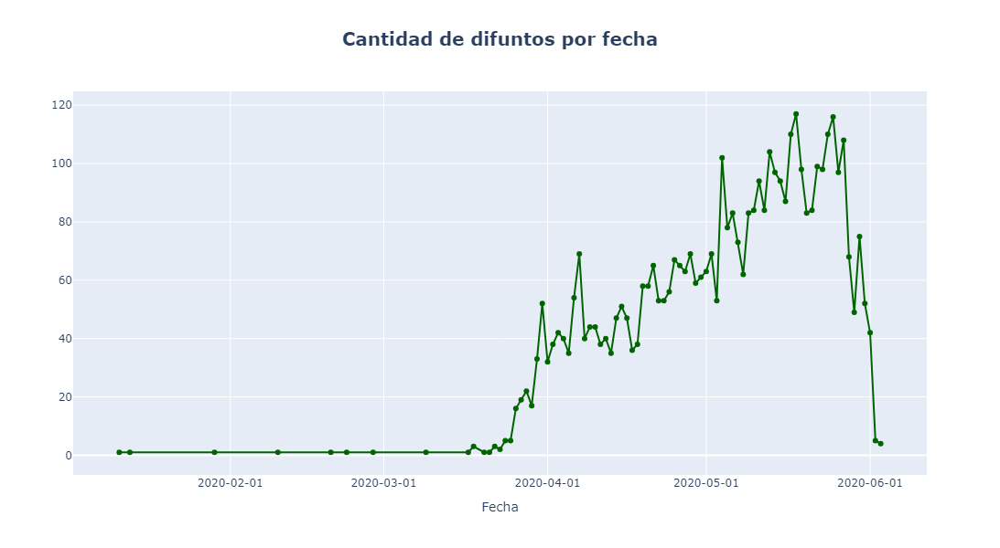

In [22]:
layout = go.Layout(
    title={
   'text': "<b>Cantidad de difuntos por fecha</b>",
        'font': {
            'size': 20,
        },
        'x': 0.5,
        'xanchor': 'center'
    },
    width=1000,  # Ancho de la imagen
    height=600,  # Alto de la imagen
    xaxis=dict(
        title='Fecha',
        tickformat='%Y-%m-%d'  # Formato de fecha sin hora
    ),
)
fig3 = go.Figure(layout = layout)
fig3.add_trace(go.Scatter(x=cantidad_muertos_dia["FECHA_DEF"],
                y=cantidad_muertos_dia["DIFUNTO"], marker_color = 'darkgreen',
                mode='lines+markers',
                name = "datos reales")) 

fig3.update_layout(xaxis_rangeslider_visible=False)
fig3.show()

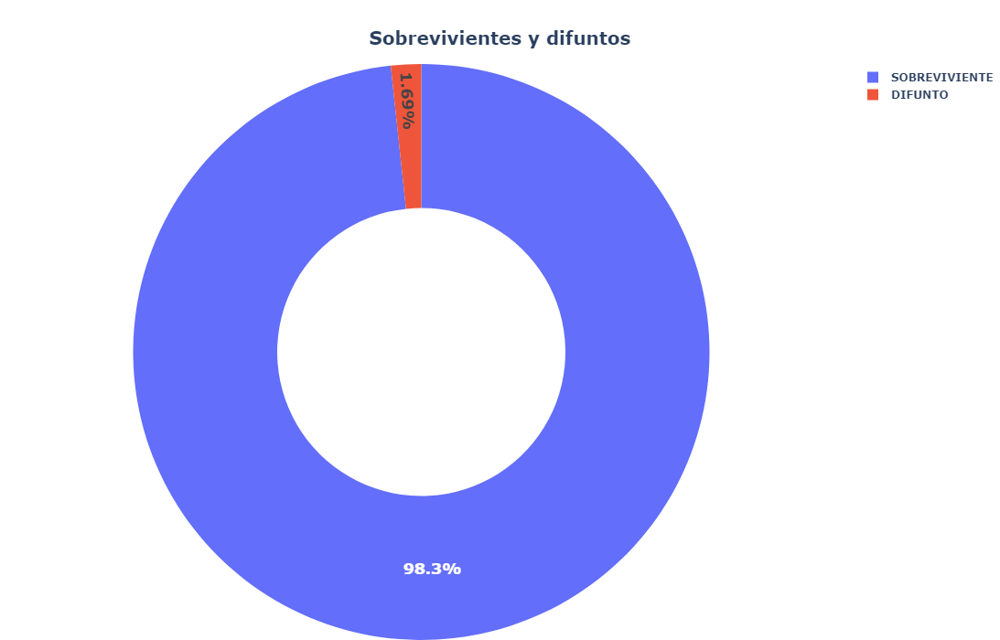

<Figure size 1400x800 with 0 Axes>

In [23]:
fig = plt.figure(figsize=(14,8))

fig = go.Figure(data=[go.Pie(labels=["<b>SOBREVIVIENTE</b>", "<b>DIFUNTO</b>"], values=COVID["DIFUNTO"].value_counts(), hole=.5)])

fig.update_traces(hoverinfo="label+percent+value", texttemplate="<b>%{percent}</b>",insidetextfont=dict(size=17))
fig.update_layout(
    width=700, 
    height=700,
     title={
   'text': "<b>Sobrevivientes y difuntos</b>",
        'font': {
            'size': 20,
        },
        'x': 0.5,
        'y': 0.95,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    margin=dict(t=70, l=5, r=5, b=0),
)

fig.show()

In [24]:
BDD_pob_Relativa = COVID["ENTIDAD"]
BDD_pob_Relativa = BDD_pob_Relativa.value_counts()
DF_pob_Relativa = BDD_pob_Relativa.to_frame(name = "PobRelativa").astype(np.int32)
pob_relativa_entidad = DF_pob_Relativa.sort_index()
pob_relativa_entidad.reset_index(inplace= True)

In [25]:
difuntos_ = COVID[COVID["DIFUNTO"]==1]
difuntos_ = difuntos_["ENTIDAD"].value_counts()
DF_difuntos = difuntos_.to_frame(name = "DIFUNTO").astype(np.int32)
difuntos = DF_difuntos.sort_index()
difuntos.reset_index(inplace= True)

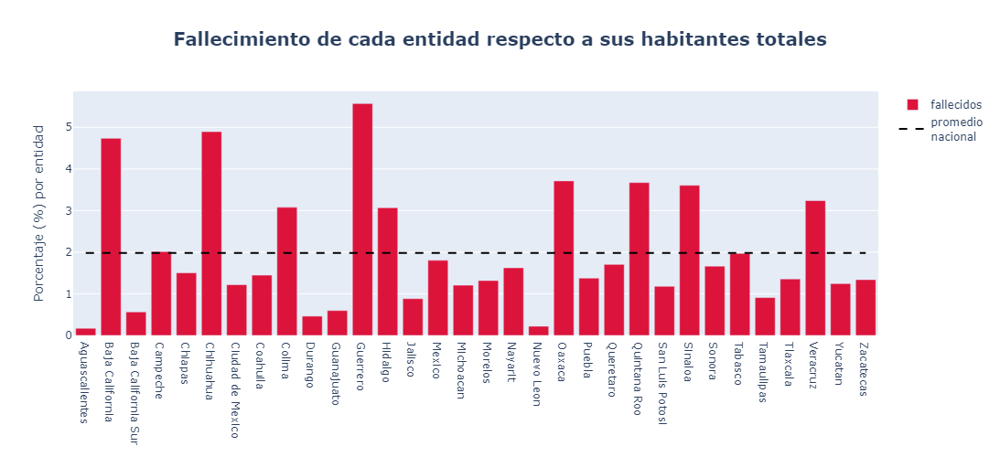

In [26]:
layout = go.Layout(
    title={
   'text': "<b>Fallecimiento de cada entidad respecto a sus habitantes totales</b>",
        'font': {
            'size': 20,
        },
        'x': 0.5,
        'xanchor': 'center'
    },
    barmode='relative',
    width=900,  # Ancho de la imagen
    height=500  # Alto de la imagen
)
fig = go.Figure(layout = layout)

fig.add_trace(go.Bar(x=difuntos["ENTIDAD"],
               y=( difuntos["DIFUNTO"] / pob_relativa_entidad["PobRelativa"] ) *100,
               marker_color = 'crimson',
               name = 'fallecidos'))

media = (( difuntos["DIFUNTO"] / pob_relativa_entidad["PobRelativa"] ) *100).mean()

fig.add_trace(go.Scatter(x=difuntos["ENTIDAD"], y=np.ones(32)*media,
                    mode='lines',
                    line = dict(dash = 'dash'),
                    marker_color = "black",
                     name = "promedio<br>nacional"))

fig.update_layout(xaxis_rangeslider_visible=False,yaxis_title="Porcentaje (%) por entidad",)
fig.show()

In [27]:
conmorbilidades = ["NEUMONIA","DIABETES", "EPOC", "ASMA", "INMUSUPR", "HIPERTENSION", "OTRA_COM", "CARDIOVASCULAR", 
                   "OBESIDAD", "RENAL_CRONICA", "TABAQUISMO", "EMBARAZO"]
filtro_conmorbilidades = COVID [ conmorbilidades + [ "DIFUNTO" ] ]
filtro_conmorbilidades

,NEUMONIA,DIABETES,EPOC,ASMA,INMUSUPR,HIPERTENSION,OTRA_COM,CARDIOVASCULAR,OBESIDAD,RENAL_CRONICA,TABAQUISMO,EMBARAZO,DIFUNTO
0,2,1,2,2,2,1,2,2,1,2,2,2,0
1,2,1,1,2,2,1,2,2,1,2,1,2,0
2,1,2,2,2,2,2,2,2,2,2,2,2,0
3,2,2,2,2,2,2,2,2,1,2,2,2,0
4,2,2,2,2,2,2,2,2,2,2,2,2,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
263002,2,2,2,2,2,2,2,2,2,2,2,2,0
263003,1,1,1,2,2,2,2,2,1,2,2,2,1
263004,2,1,2,2,2,1,2,2,2,1,2,2,1
263005,1,2,2,2,2,1,2,2,2,2,2,2,0


In [28]:
#Cantidad de personas que presentan tal o cual enfermedad, de los fallecidos
ENFERMEDADES_FALLECIDOS = filtro_conmorbilidades[filtro_conmorbilidades["DIFUNTO"] == 1].apply(lambda x: x.value_counts().get(1, 0))
ENFERMEDADES_FALLECIDOS = pd.DataFrame(ENFERMEDADES_FALLECIDOS[:len(ENFERMEDADES_FALLECIDOS)-1])
ENFERMEDADES_FALLECIDOS

,0
NEUMONIA,3125
DIABETES,1757
EPOC,317
ASMA,98
INMUSUPR,213
HIPERTENSION,1898
OTRA_COM,345
CARDIOVASCULAR,310
OBESIDAD,1096
RENAL_CRONICA,392


In [29]:
#Cantidad de personas que presentan tal o cual enfermedad, de los fallecidos
ENFERMEDADES_SOBREVIVIENTES = filtro_conmorbilidades[filtro_conmorbilidades["DIFUNTO"] == 0].apply(lambda x: x.value_counts().get(1, 0))
ENFERMEDADES_SOBREVIVIENTES = pd.DataFrame(ENFERMEDADES_SOBREVIVIENTES[:len(ENFERMEDADES_SOBREVIVIENTES)-1])
ENFERMEDADES_SOBREVIVIENTES

,0
NEUMONIA,38671
DIABETES,31882
EPOC,4812
ASMA,9360
INMUSUPR,4781
HIPERTENSION,41945
OTRA_COM,9208
CARDIOVASCULAR,6393
OBESIDAD,42246
RENAL_CRONICA,5274


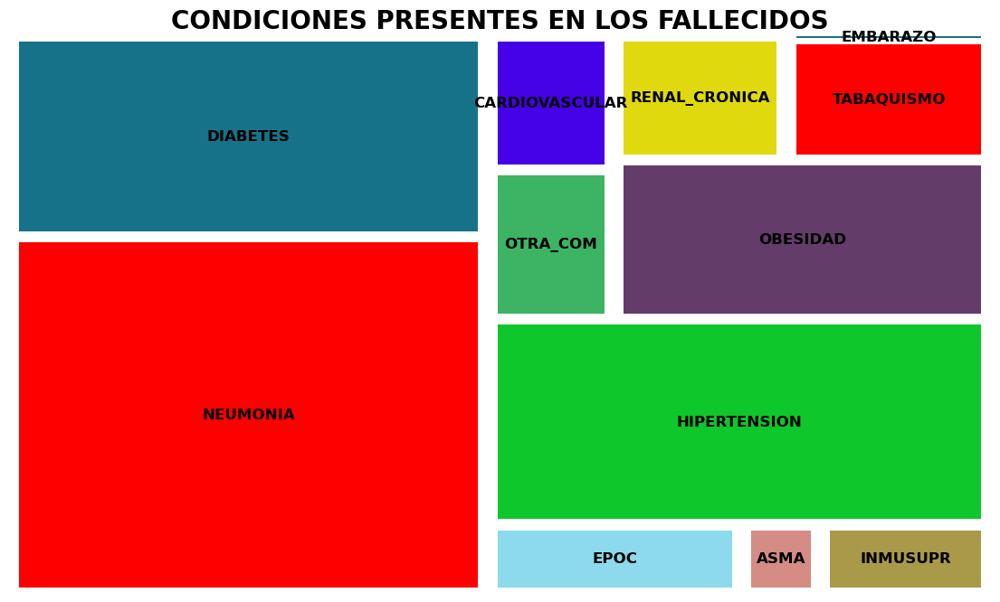

In [30]:
colors = ['red', '#167288', '#8cdaec',
          '#d48c84', '#a89a49', '#0ec72a', '#3cb464',
           '#4602e6','#643c6a','#e0d90d']

fig = plt.figure(figsize=(14,8))

squarify.plot(sizes=ENFERMEDADES_FALLECIDOS[0], 
              label=ENFERMEDADES_FALLECIDOS.index, 
              pad = 0.2, 
              text_kwargs = {'fontsize': 12, 'color': 'black', 'weight': 'bold'},
              color = colors)

plt.title("CONDICIONES PRESENTES EN LOS FALLECIDOS", fontsize = 20, weight = "bold")
plt.axis('off')
plt.show()

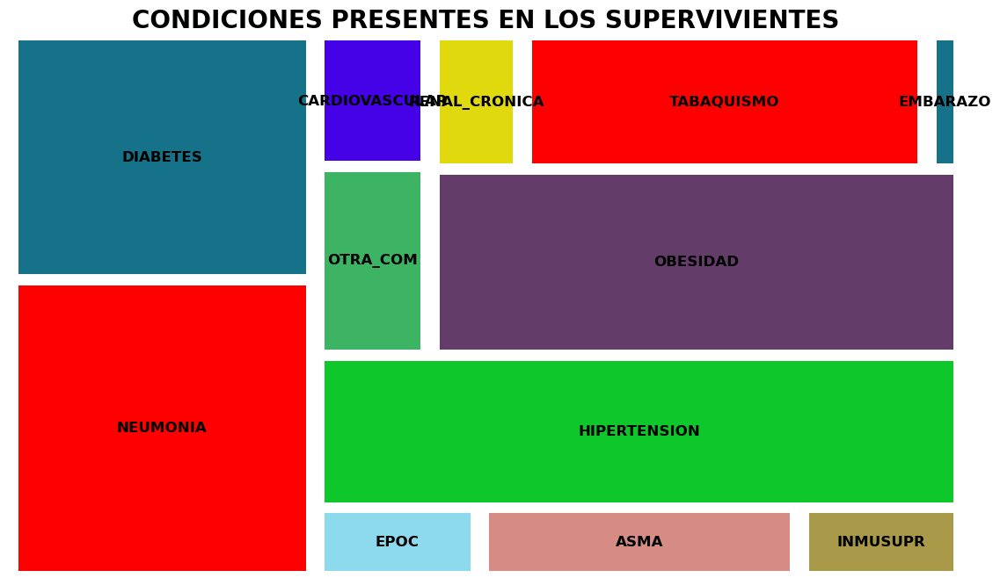

In [31]:
colors = ['red', '#167288', '#8cdaec',
          '#d48c84', '#a89a49', '#0ec72a', '#3cb464',
           '#4602e6','#643c6a','#e0d90d']

fig = plt.figure(figsize=(14,8))

squarify.plot(sizes=ENFERMEDADES_SOBREVIVIENTES[0], 
              label=ENFERMEDADES_SOBREVIVIENTES.index, 
              pad = 0.2, 
              text_kwargs = {'fontsize': 12, 'color': 'black', 'weight': 'bold'},
              color = colors)

plt.title("CONDICIONES PRESENTES EN LOS SUPERVIVIENTES", fontsize = 20, weight = "bold")
plt.axis('off')
plt.show()

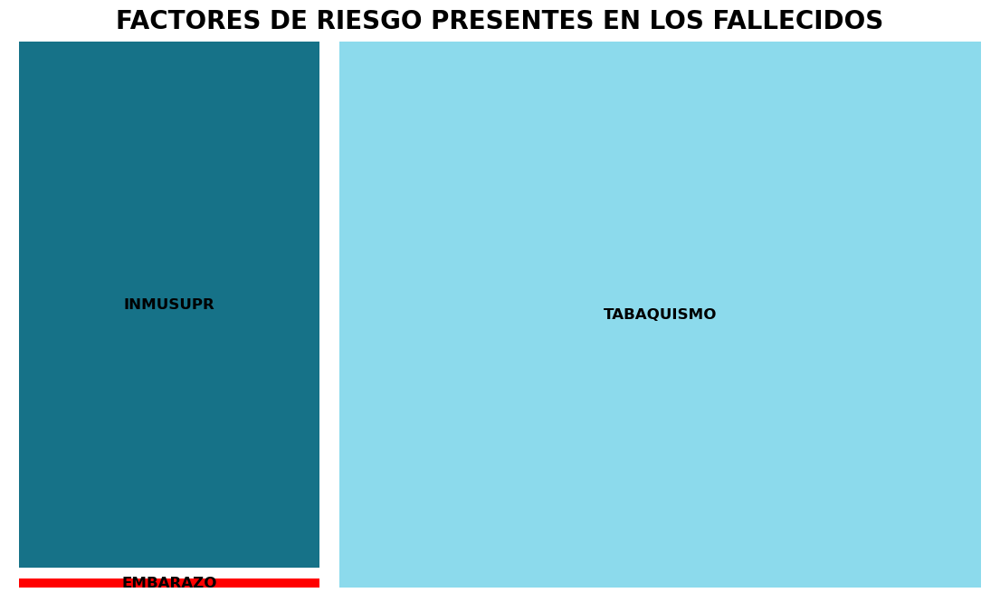

In [32]:
factores_riesgo =  ["EMBARAZO","INMUSUPR", "TABAQUISMO"]

filtro_factores_riesgo = COVID [ factores_riesgo + [ "DIFUNTO" ] ]

FACTORES_RIESGO_FALLECIDOS = filtro_factores_riesgo[filtro_factores_riesgo["DIFUNTO"] == 1].apply(lambda x: x.value_counts().get(1, 0))
FACTORES_RIESGO_FALLECIDOS = pd.DataFrame(FACTORES_RIESGO_FALLECIDOS[:len(FACTORES_RIESGO_FALLECIDOS)-1])

fig = plt.figure(figsize=(14,8))

squarify.plot(sizes=FACTORES_RIESGO_FALLECIDOS[0], 
              label=FACTORES_RIESGO_FALLECIDOS.index, 
              pad = 0.2, 
              text_kwargs = {'fontsize': 12, 'color': 'black', 'weight': 'bold'},
              color = colors)

plt.title("FACTORES DE RIESGO PRESENTES EN LOS FALLECIDOS", fontsize = 20, weight = "bold")
plt.axis('off')
plt.show()

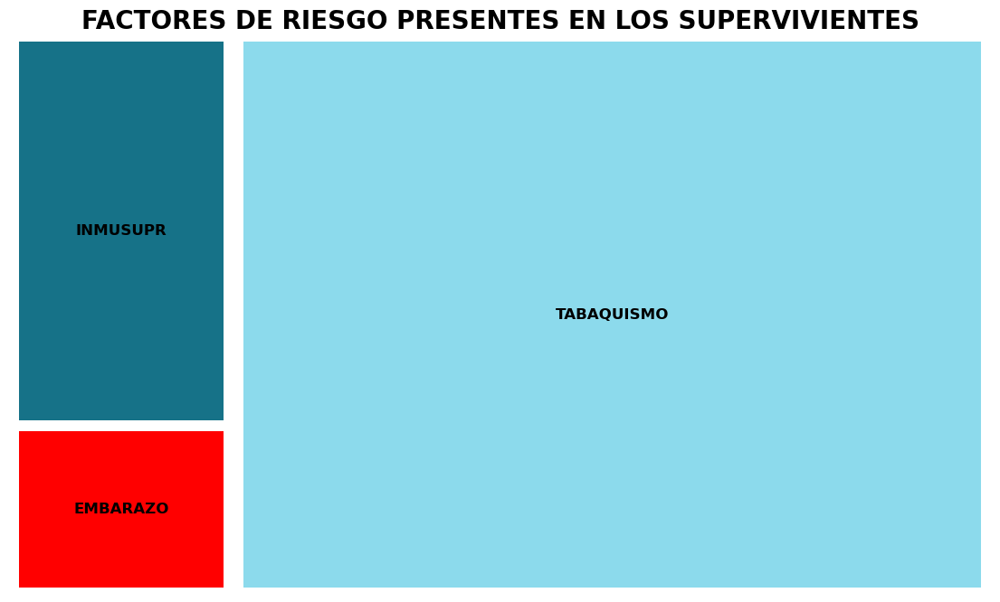

In [33]:
factores_riesgo =  ["EMBARAZO","INMUSUPR", "TABAQUISMO"]

filtro_factores_riesgo = COVID [ factores_riesgo + [ "DIFUNTO" ] ]

FACTORES_RIESGO_VIVOS = filtro_factores_riesgo[filtro_factores_riesgo["DIFUNTO"] == 0].apply(lambda x: x.value_counts().get(1, 0))
FACTORES_RIESGO_VIVOS = pd.DataFrame(FACTORES_RIESGO_VIVOS[:len(FACTORES_RIESGO_VIVOS)-1])

fig = plt.figure(figsize=(14,8))

squarify.plot(sizes=FACTORES_RIESGO_VIVOS[0], 
              label=FACTORES_RIESGO_VIVOS.index, 
              pad = 0.2, 
              text_kwargs = {'fontsize': 12, 'color': 'black', 'weight': 'bold'},
              color = colors)

plt.title("FACTORES DE RIESGO PRESENTES EN LOS SUPERVIVIENTES", fontsize = 20, weight = "bold")
plt.axis('off')
plt.show()

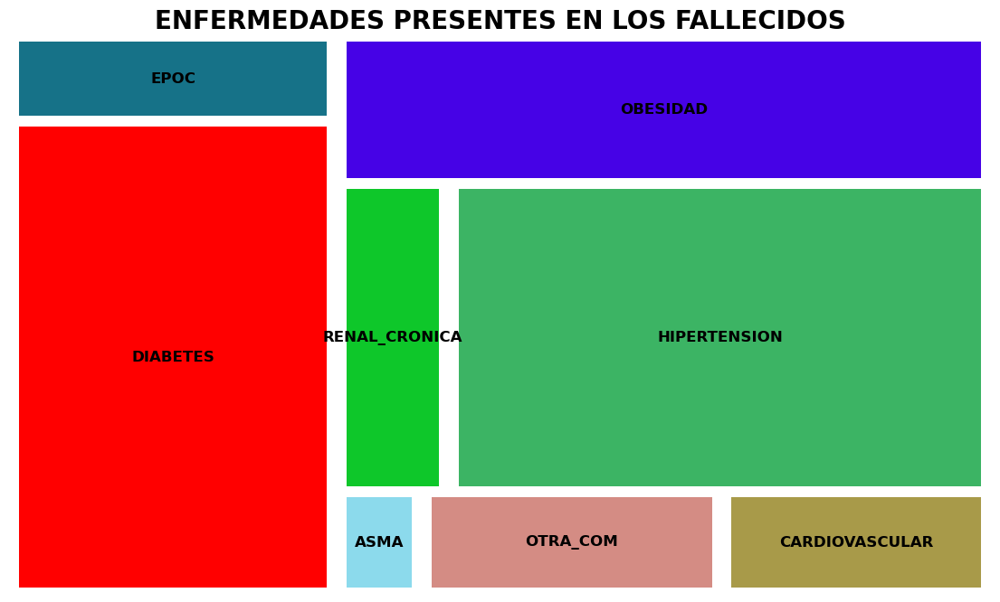

In [34]:
enfermedades =  ["DIABETES", "EPOC", "ASMA", "OTRA_COM", "CARDIOVASCULAR", "RENAL_CRONICA","HIPERTENSION", "OBESIDAD"]
filtro_enfermedades = COVID [ enfermedades + [ "DIFUNTO" ] ]

ENFERMEDADES_FALLECIDOS = filtro_enfermedades[filtro_enfermedades["DIFUNTO"] == 1].apply(lambda x: x.value_counts().get(1, 0))
ENFERMEDADES_FALLECIDOS = pd.DataFrame(ENFERMEDADES_FALLECIDOS[:len(ENFERMEDADES_FALLECIDOS)-1])

fig = plt.figure(figsize=(14,8))

squarify.plot(sizes=ENFERMEDADES_FALLECIDOS[0], 
              label=ENFERMEDADES_FALLECIDOS.index, 
              pad = 0.2, 
              text_kwargs = {'fontsize': 12, 'color': 'black', 'weight': 'bold'},
              color = colors)

plt.title("ENFERMEDADES PRESENTES EN LOS FALLECIDOS", fontsize = 20, weight = "bold")
plt.axis('off')
plt.show()

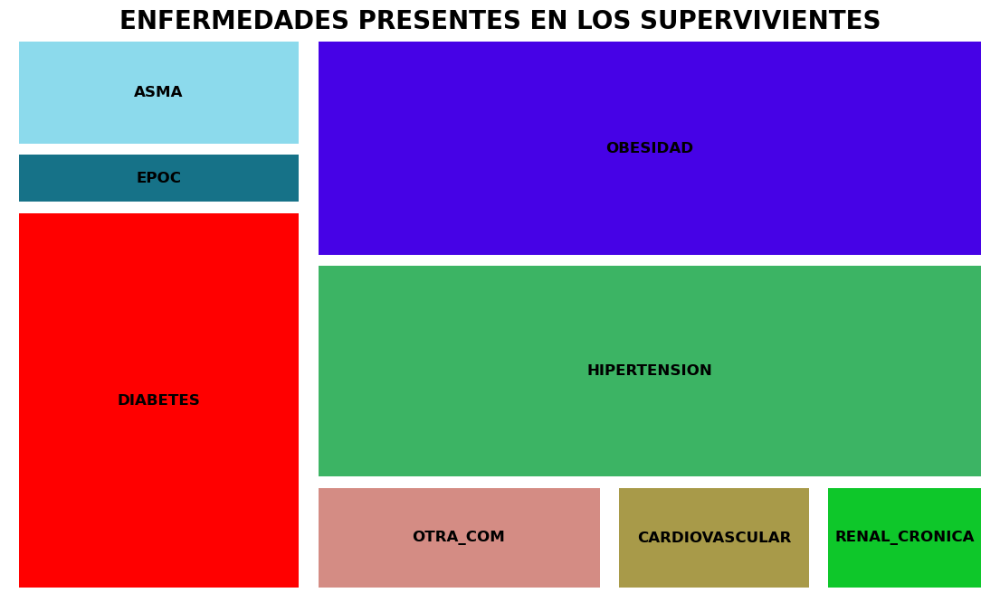

In [35]:
enfermedades =  ["DIABETES", "EPOC", "ASMA", "OTRA_COM", "CARDIOVASCULAR", "RENAL_CRONICA","HIPERTENSION", "OBESIDAD", ]
filtro_enfermedades = COVID [ enfermedades + [ "DIFUNTO" ] ]

ENFERMEDADES_VIVOS = filtro_enfermedades[filtro_enfermedades["DIFUNTO"] == 0].apply(lambda x: x.value_counts().get(1, 0))
ENFERMEDADES_VIVOS = pd.DataFrame(ENFERMEDADES_VIVOS[:len(ENFERMEDADES_VIVOS)-1])

fig = plt.figure(figsize=(14,8))

squarify.plot(sizes=ENFERMEDADES_VIVOS[0], 
              label=ENFERMEDADES_VIVOS.index, 
              pad = 0.2, 
              text_kwargs = {'fontsize': 12, 'color': 'black', 'weight': 'bold'},
              color = colors)

plt.title("ENFERMEDADES PRESENTES EN LOS SUPERVIVIENTES", fontsize = 20, weight = "bold")
plt.axis('off')
plt.show()

In [36]:
filtro_conmorbilidades_difuntos = filtro_conmorbilidades[filtro_conmorbilidades[ "DIFUNTO" ]==1 ]
filtro_conmorbilidades_difuntos

,NEUMONIA,DIABETES,EPOC,ASMA,INMUSUPR,HIPERTENSION,OTRA_COM,CARDIOVASCULAR,OBESIDAD,RENAL_CRONICA,TABAQUISMO,EMBARAZO,DIFUNTO
39,2,2,2,2,2,2,1,2,2,1,2,2,1
96,1,1,2,2,1,1,1,1,1,1,2,2,1
190,1,2,2,2,2,2,2,2,2,2,1,2,1
306,2,2,2,2,2,2,2,2,2,2,2,2,1
323,2,2,2,2,2,2,2,2,2,2,2,2,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
262982,2,1,1,2,2,1,2,2,1,2,2,2,1
262984,2,1,2,2,2,1,2,1,2,2,2,2,1
262996,2,2,2,2,2,2,2,2,2,2,2,2,1
263003,1,1,1,2,2,2,2,2,1,2,2,2,1


In [37]:
filtro_difuntos = filtro_conmorbilidades[filtro_conmorbilidades["DIFUNTO"]==1]
filtro_vivos = filtro_conmorbilidades[filtro_conmorbilidades["DIFUNTO"]==0]

In [38]:
cuenta_conmorbilidades_difuntos = filtro_difuntos.apply(lambda col: col.value_counts().reindex([1, 2], fill_value=0))
cuenta_conmorbilidades_difuntos

,NEUMONIA,DIABETES,EPOC,ASMA,INMUSUPR,HIPERTENSION,OTRA_COM,CARDIOVASCULAR,OBESIDAD,RENAL_CRONICA,TABAQUISMO,EMBARAZO,DIFUNTO
1,3125,1757,317,98,213,1898,345,310,1096,392,456,8,4410
2,1285,2653,4093,4312,4197,2512,4065,4100,3314,4018,3954,4402,0


In [39]:
cuenta_conmorbilidades_vivos = filtro_vivos.apply(lambda col: col.value_counts().reindex([1, 2], fill_value=0))
cuenta_conmorbilidades_vivos

,NEUMONIA,DIABETES,EPOC,ASMA,INMUSUPR,HIPERTENSION,OTRA_COM,CARDIOVASCULAR,OBESIDAD,RENAL_CRONICA,TABAQUISMO,EMBARAZO,DIFUNTO
1,38671,31882,4812,9360,4781,41945,9208,6393,42246,5274,23067,2051,0
2,217291,224080,251150,246602,251181,214017,246754,249569,213716,250688,232895,253911,0


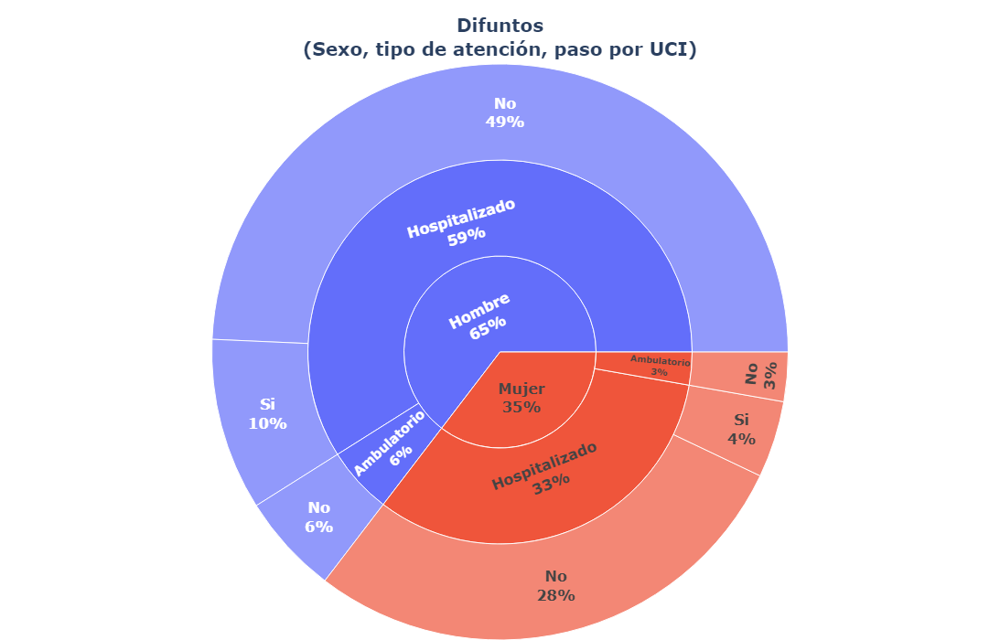

In [40]:
SUNBR = COVID[["DIFUNTO", "SEXO", "TIPO_PACIENTE", "UCI"]]
SUNBR = SUNBR[SUNBR["DIFUNTO"] == 1]
SUNBR.drop(columns=["DIFUNTO"], inplace=True)
nombres_columnas = SUNBR.columns
SUNBR.columns = list(range(len(SUNBR.columns)))

# Mapear los valores numéricos a texto para cada columna
mapa_parents = {1: 'Mujer', 2: 'Hombre',  99: 'No especificado'}
mapa_labels = {1: 'Ambulatorio', 2: 'Hospitalizado', 99: 'No especificado'}
mapa_ids = {1: 'Si', 2: 'No', 97: 'No aplica', 98: 'Se ignora', 99: 'No especificado'}

SUNBR[0] = SUNBR[0].map(mapa_parents)
SUNBR[1] = SUNBR[1].map(mapa_labels)
SUNBR[2] = SUNBR[2].map(mapa_ids)

SUNBR['count'] = 1
values = SUNBR.groupby([0,1,2]).size().reset_index(name='counts')

# Preparar listas para ids, labels, parents y values
ids = []
labels = []
parents = []
values_list = []

for i, filas in values.iterrows():
    col1 = filas[0]
    col2 = filas[1]
    col3 = filas[2]
    count = filas["counts"]

    if col1 not in ids:
        ids.append(col1)
        labels.append(col1)
        parents.append('')
        values_list.append(values[values[0] == col1]["counts"].sum())

    if f'{col1}-{col2}' not in ids:
        ids.append(f'{col1}-{col2}')
        labels.append(col2)
        parents.append(col1)
        values_list.append(values[(values[0] == col1) & (values[1] == col2)]["counts"].sum())

    ids.append(f'{col1}-{col2}-{col3}')
    labels.append(col3)
    parents.append(f'{col1}-{col2}')
    values_list.append(count)

fig = go.Figure()

fig.add_trace(go.Sunburst(
    ids=ids,
    labels=labels,
    parents=parents,
    values=values_list, 
    branchvalues='total', 
    textinfo = "label+percent entry",
    texttemplate="<b>%{label}</b><br><b>%{percentEntry}</b>",
    insidetextfont=dict(size=16)
))

fig.update_layout(
    width=700,
    height=700,
     title={
   'text': "<b>Difuntos<br>(Sexo, tipo de atención, paso por UCI)</b>",
        'font': {
            'size': 20,
        },
        'x': 0.5,
        'y': 0.95,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    margin=dict(t=70, l=0, r=0, b=0),
)

fig.show()

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\3027423012.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\3027423012.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\3027423012.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

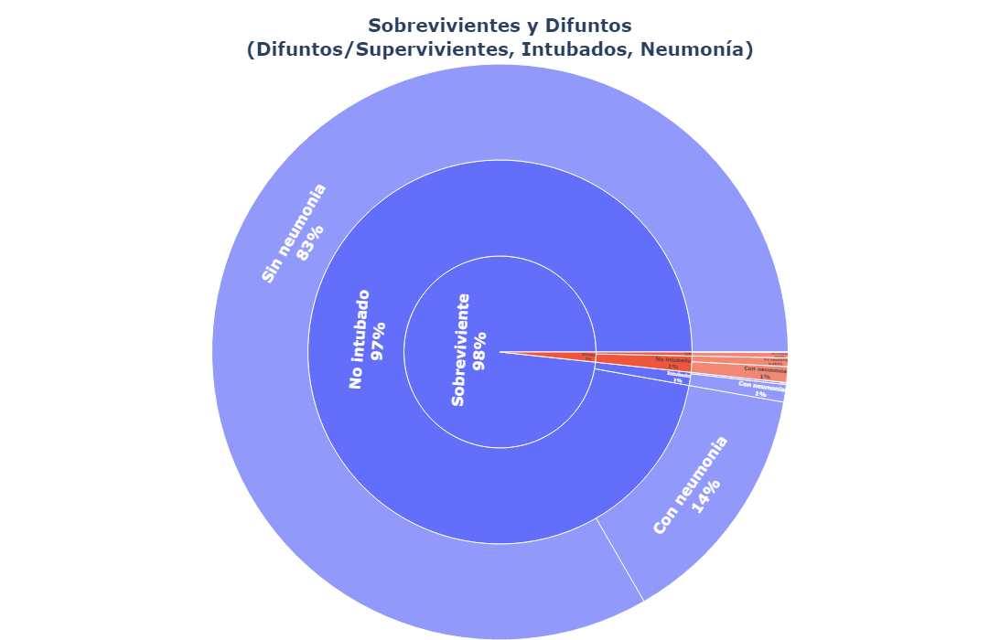

In [41]:
SUNBR = COVID[["DIFUNTO", "INTUBADO", "NEUMONIA"]]
nombres_columnas = SUNBR.columns
SUNBR.columns = list(range(len(SUNBR.columns)))

# Mapear los valores numéricos a texto para cada columna
mapa_parents = {1: 'Difunto', 0: 'Sobreviviente'}
mapa_labels = {1: 'Intubado', 2: 'No intubado', 97: 'No aplica', 98:'Se ignora', 99: 'No especificado'}
mapa_ids = {1: 'Con neumonia', 2: 'Sin neumonia', 97: 'No aplica', 98:'Se ignora', 99: 'No especificado'}


SUNBR[0] = SUNBR[0].map(mapa_parents)
SUNBR[1] = SUNBR[1].map(mapa_labels)
SUNBR[2] = SUNBR[2].map(mapa_ids)

SUNBR['count'] = 1
values = SUNBR.groupby([0,1,2]).size().reset_index(name='counts')

# Preparar listas para ids, labels, parents y values
ids = []
labels = []
parents = []
values_list = []

for i, filas in values.iterrows():
    col1 = filas[0]
    col2 = filas[1]
    col3 = filas[2]
    count = filas["counts"]

    if col1 not in ids:
        ids.append(col1)
        labels.append(col1)
        parents.append('')
        values_list.append(values[values[0] == col1]["counts"].sum())

    if f'{col1}-{col2}' not in ids:
        ids.append(f'{col1}-{col2}')
        labels.append(col2)
        parents.append(col1)
        values_list.append(values[(values[0] == col1) & (values[1] == col2)]["counts"].sum())

    ids.append(f'{col1}-{col2}-{col3}')
    labels.append(col3)
    parents.append(f'{col1}-{col2}')
    values_list.append(count)

fig = go.Figure()

fig.add_trace(go.Sunburst(
    ids=ids,
    labels=labels,
    parents=parents,
    values=values_list, 
    branchvalues='total', 
    textinfo = "label+percent entry",
    texttemplate="<b>%{label}</b><br><b>%{percentEntry}</b>",
    insidetextfont=dict(size=16)
))

fig.update_layout(
    width=700,
    height=700,
     title={
   'text': "<b>Sobrevivientes y Difuntos<br>(Difuntos/Supervivientes, Intubados, Neumonía)</b>",
        'font': {
            'size': 20,
        },
        'x': 0.5,
        'y': 0.95,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    margin=dict(t=70, l=0, r=0, b=0),
)

fig.show()

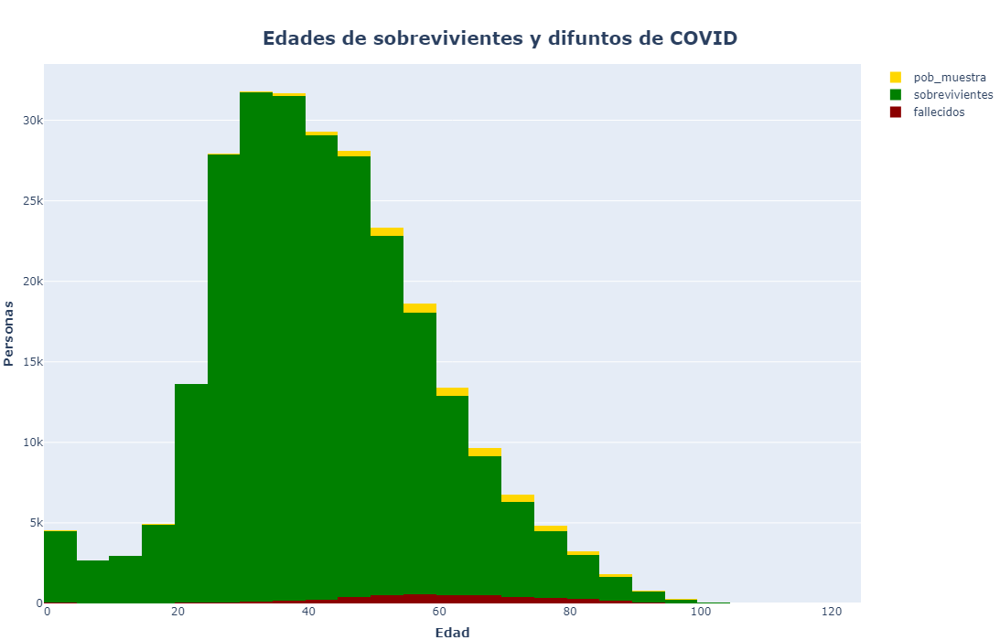

In [42]:
fig = go.Figure(layout = layout)
DIF_EDAD = COVID[["EDAD", "DIFUNTO"]]
SUP_EDAD = COVID[["EDAD", "DIFUNTO"]]

DIF_EDAD = DIF_EDAD[DIF_EDAD["DIFUNTO"]==1]
SUP_EDAD = SUP_EDAD[SUP_EDAD["DIFUNTO"]==0]
fig.add_trace(go.Histogram(x = COVID.EDAD, xbins=go.histogram.XBins(size=5), marker=go.histogram.Marker(color="gold"),name = 'pob_muestra'))
fig.add_trace(go.Histogram(x = SUP_EDAD.EDAD, xbins=go.histogram.XBins(size=5), marker=go.histogram.Marker(color="green"),name = 'sobrevivientes'))
fig.add_trace(go.Histogram(x = DIF_EDAD.EDAD, xbins=go.histogram.XBins(size=5), marker=go.histogram.Marker(color="darkred"),name = 'fallecidos'))

fig.update_xaxes(title_text="<b>Edad</b>")
fig.update_yaxes(title_text="<b>Personas</b>")
fig.update_layout(
    width=900,
    height=700,
     title={
   'text': "<b>Edades de sobrevivientes y difuntos de COVID</b>",
        'font': {
            'size': 20,
        },
        'x': 0.5,
        'y': 0.95,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    margin=dict(t=70, l=0, r=0, b=0),
    barmode='overlay'
)
fig.show()

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\4168116692.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\4168116692.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\4168116692.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

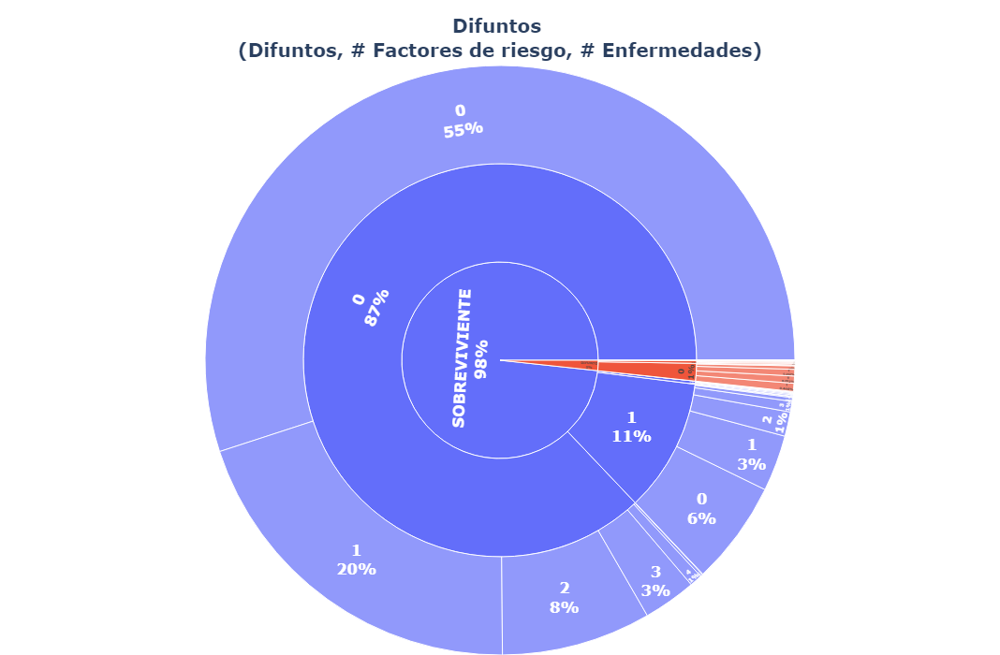

In [43]:
BDD_CANTIDAD_ENFERMEDADES = COVID[ enfermedades + ["DIFUNTO"] ]
mapa_cuenta_enfermedades = {1: 1, 2: 0, 97: 0, 98: 0, 99: 0}
for columna in BDD_CANTIDAD_ENFERMEDADES.columns[:-1]:
    BDD_CANTIDAD_ENFERMEDADES[columna] = BDD_CANTIDAD_ENFERMEDADES[columna].map(mapa_cuenta_enfermedades)
BDD_CANTIDAD_ENFERMEDADES["CANT_ENF"] = BDD_CANTIDAD_ENFERMEDADES.iloc[:,:-1].sum(axis = 1)

BDD_CANTIDAD_ENFERMEDADES.drop(columns=enfermedades, inplace=True)


BDD_CANTIDAD_FACTORES_RIESGO = COVID [factores_riesgo + ["DIFUNTO"] ]
mapa_cuenta_factores_riesgo = {1: 1, 2: 0, 97: 0, 98: 0, 99: 0}
for columna in BDD_CANTIDAD_FACTORES_RIESGO.columns[:-1]:
    BDD_CANTIDAD_FACTORES_RIESGO[columna] = BDD_CANTIDAD_FACTORES_RIESGO[columna].map(mapa_cuenta_factores_riesgo)
#Eastablecer la condición para mostrar los que no aplican o no se sabe
BDD_CANTIDAD_FACTORES_RIESGO["CANT_FR"] = BDD_CANTIDAD_FACTORES_RIESGO.iloc[:,:-1].sum(axis = 1)


BDD_CANTIDAD_FACTORES_RIESGO.drop(columns=factores_riesgo, inplace=True)

BDD_CANTIDAD_CONDICIONES = BDD_CANTIDAD_FACTORES_RIESGO
BDD_CANTIDAD_CONDICIONES["CANT_ENF"] = BDD_CANTIDAD_ENFERMEDADES["CANT_ENF"]

#BDD_CANTIDAD_CONDICIONES["CANT_ENF"] = BDD_CANTIDAD_CONDICIONES["CANT_ENF"].apply(lambda x: 1 if x > 0 else 0)
#BDD_CANTIDAD_CONDICIONES["CANT_FR"] = BDD_CANTIDAD_CONDICIONES["CANT_FR"].apply(lambda x: 1 if x > 0 else 0)

BDD_CANTIDAD_CONDICIONES.columns = list(range(len(BDD_CANTIDAD_CONDICIONES.columns)))
# Mapear los valores numéricos a texto para cada columna
mapa_parents = {1: 'DIFUNTO', 0: 'SOBREVIVIENTE'}
#mapa_labels = {1: 'Con FR', 0: 'Sin FR', 97: 'No aplica', 98:'Se ignora', 99: 'No especificado'}
#mapa_ids = {1:  'Con enfermedades', 0: 'Sin enfermedades', 97: 'No aplica', 98:'Se ignora', 99: 'No especificado'}

BDD_CANTIDAD_CONDICIONES[0] = BDD_CANTIDAD_CONDICIONES[0].map(mapa_parents)
#BDD_CANTIDAD_CONDICIONES[1] = BDD_CANTIDAD_CONDICIONES[1].map(mapa_labels)
#BDD_CANTIDAD_CONDICIONES[2] = BDD_CANTIDAD_CONDICIONES[2].map(mapa_ids)

BDD_CANTIDAD_CONDICIONES['count'] = 1
values = BDD_CANTIDAD_CONDICIONES.groupby([0,1,2]).size().reset_index(name='counts')

# Preparar listas para ids, labels, parents y values
ids = []
labels = []
parents = []
values_list = []

for i, filas in values.iterrows():
    col1 = filas[0]
    col2 = filas[1]
    col3 = filas[2]
    count = filas["counts"]

    if col1 not in ids:
        ids.append(col1)
        labels.append(col1)
        parents.append('')
        values_list.append(values[values[0] == col1]["counts"].sum())

    if f'{col1}-{col2}' not in ids:
        ids.append(f'{col1}-{col2}')
        labels.append(col2)
        parents.append(col1)
        values_list.append(values[(values[0] == col1) & (values[1] == col2)]["counts"].sum())

    ids.append(f'{col1}-{col2}-{col3}')
    labels.append(col3)
    parents.append(f'{col1}-{col2}')
    values_list.append(count)

fig = go.Figure()

fig.add_trace(go.Sunburst(
    ids=ids,
    labels=labels,
    parents=parents,
    values=values_list, 
    branchvalues='total', 
    textinfo = "label+percent entry",
    texttemplate="<b>%{label}</b><br><b>%{percentEntry}</b>",
    insidetextfont=dict(size=16)
))

fig.update_layout(
    width=700,
    height=700,
     title={
   'text': "<b>Difuntos <br>(Difuntos, # Factores de riesgo, # Enfermedades)</b>",
        'font': {
            'size': 20,
        },
        'x': 0.5,
        'y': 0.95,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    margin=dict(t=70, l=0, r=0, b=0),
)

fig.show()

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\542443139.py:23: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\542443139.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\542443139.py:25: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-d

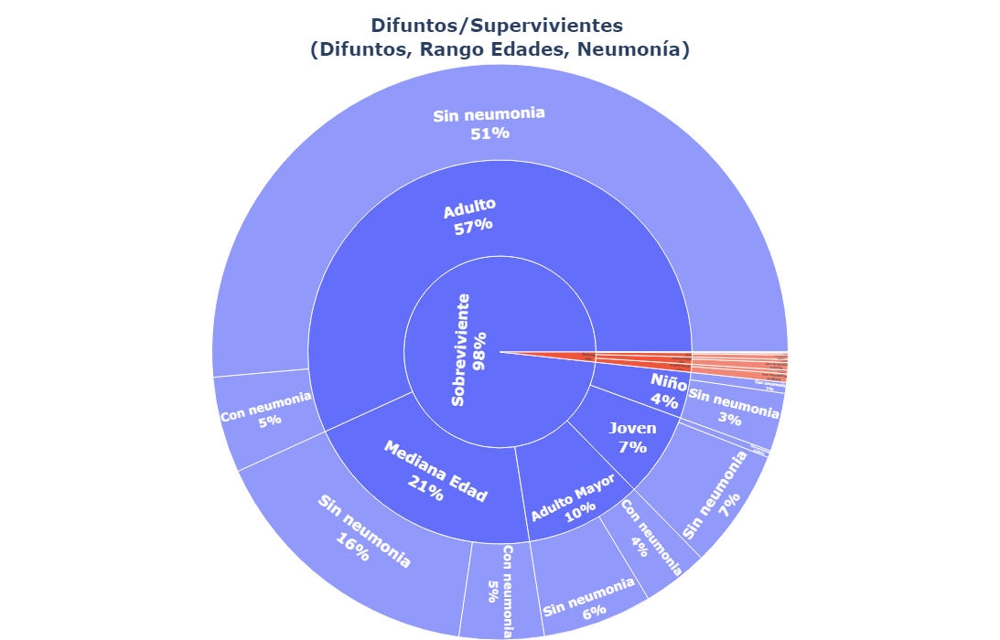

In [44]:
condiciones = [
    (COVID['EDAD'] >= 0 ) & (COVID['EDAD'] < 15),
    (COVID['EDAD'] >= 15) & (COVID['EDAD'] < 25),
    (COVID['EDAD'] >= 25) & (COVID['EDAD'] < 50),
    (COVID['EDAD'] >= 50) & (COVID['EDAD'] < 65),
    (COVID['EDAD'] >= 65) 
]

mapeo = [1, 2, 3, 4, 5]

COVID['RANGO_EDADES'] = np.select(condiciones, mapeo, default=np.nan)

SUNBR = COVID[["DIFUNTO", "RANGO_EDADES", "NEUMONIA"]]
nombres_columnas = SUNBR.columns
SUNBR.columns = list(range(len(SUNBR.columns)))

# Mapear los valores numéricos a texto para cada columna
mapa_parents = {1: 'Difunto', 0: 'Sobreviviente'}
mapa_labels = {1: 'Niño', 2: 'Joven', 3: 'Adulto', 4:'Mediana Edad', 5: 'Adulto Mayor'}
mapa_ids = {1: 'Con neumonia', 2: 'Sin neumonia', 97: 'No aplica', 98:'Se ignora', 99: 'No especificado'}


SUNBR[0] = SUNBR[0].map(mapa_parents)
SUNBR[1] = SUNBR[1].map(mapa_labels)
SUNBR[2] = SUNBR[2].map(mapa_ids)

SUNBR['count'] = 1
values = SUNBR.groupby([0,1,2]).size().reset_index(name='counts')

# Preparar listas para ids, labels, parents y values
ids = []
labels = []
parents = []
values_list = []

for i, filas in values.iterrows():
    col1 = filas[0]
    col2 = filas[1]
    col3 = filas[2]
    count = filas["counts"]

    if col1 not in ids:
        ids.append(col1)
        labels.append(col1)
        parents.append('')
        values_list.append(values[values[0] == col1]["counts"].sum())

    if f'{col1}-{col2}' not in ids:
        ids.append(f'{col1}-{col2}')
        labels.append(col2)
        parents.append(col1)
        values_list.append(values[(values[0] == col1) & (values[1] == col2)]["counts"].sum())

    ids.append(f'{col1}-{col2}-{col3}')
    labels.append(col3)
    parents.append(f'{col1}-{col2}')
    values_list.append(count)

fig = go.Figure()

fig.add_trace(go.Sunburst(
    ids=ids,
    labels=labels,
    parents=parents,
    values=values_list, 
    branchvalues='total', 
    textinfo = "label+percent entry",
    texttemplate="<b>%{label}</b><br><b>%{percentEntry}</b>",
    insidetextfont=dict(size=16)
))

fig.update_layout(
    width=700,
    height=700,
     title={
   'text': "<b>Difuntos/Supervivientes <br>(Difuntos, Rango Edades, Neumonía)</b>",
        'font': {
            'size': 20,
        },
        'x': 0.5,
        'y': 0.95,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    margin=dict(t=70, l=0, r=0, b=0),
)

fig.show()

In [45]:
COVID.info()

<class 'pandas.core.frame.DataFrame'>
Index: 260372 entries, 0 to 263006
Data columns (total 39 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   id                   260372 non-null  int64         
 1   FECHA_ARCHIVO        260372 non-null  object        
 2   ENTIDAD_UM           260372 non-null  int64         
 3   ENTIDAD_RES          260372 non-null  int64         
 4   RESULTADO            260372 non-null  int64         
 5   ENTIDAD_REGISTRO     260372 non-null  int64         
 6   ENTIDAD              260372 non-null  object        
 7   FECHA_ACTUALIZACION  260372 non-null  object        
 8   ORIGEN               260372 non-null  int64         
 9   SECTOR               260372 non-null  int64         
 10  SEXO                 260372 non-null  int64         
 11  MUNICIPIO_RES        260366 non-null  float64       
 12  TIPO_PACIENTE        260372 non-null  int64         
 13  FECHA_INGRESO      

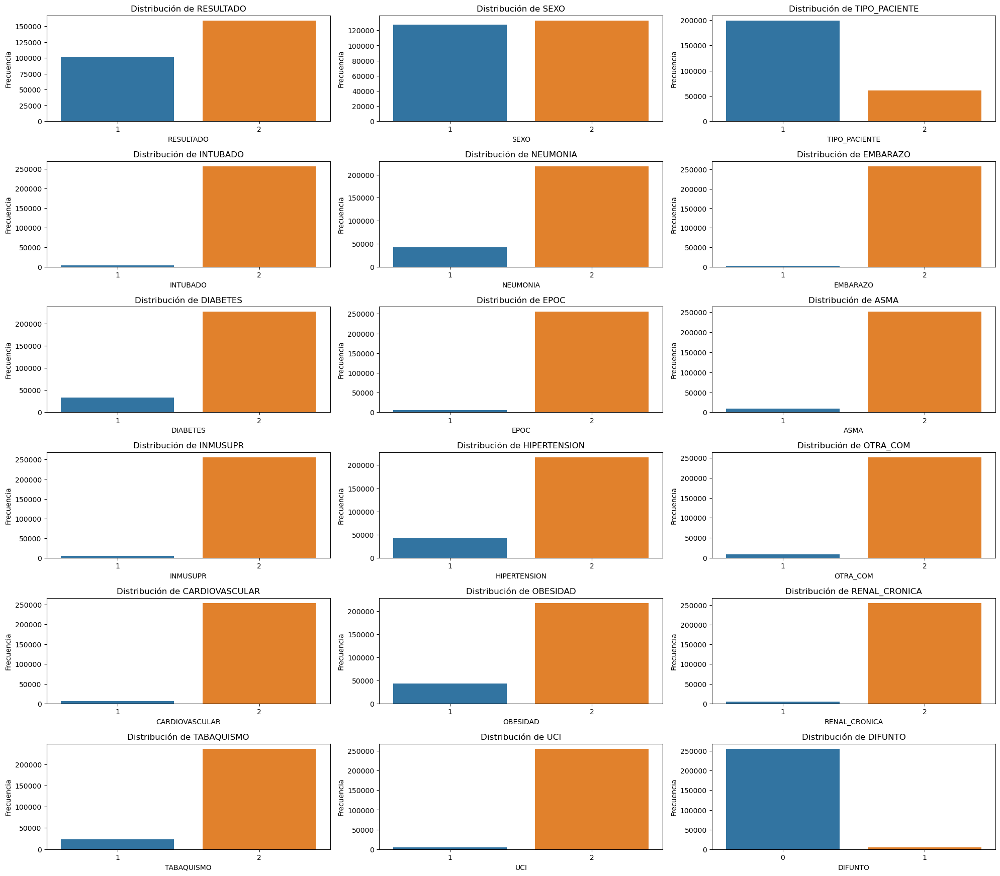

In [46]:
plt.figure(figsize=(20, 20))
DF_CATEGORIAS_ = COVID.drop(columns = ["EDAD", "RANGO_EDADES","FECHA_ARCHIVO", "ENTIDAD_UM","ENTIDAD_RES",
                                      "ENTIDAD_REGISTRO", "ENTIDAD", "FECHA_ACTUALIZACION", "ORIGEN", "SECTOR",
                                      "MUNICIPIO_RES","FECHA_INGRESO", "FECHA_SINTOMAS","FECHA_DEF","NACIONALIDAD",
                                      "HABLA_LENGUA_INDIG", "MIGRANTE", "PAIS_NACIONALIDAD", "PAIS_ORIGEN","RANGO_EDADES", "id", "OTRO_CASO"])
num_columns = len(DF_CATEGORIAS_.columns)

for i, column in enumerate(DF_CATEGORIAS_.columns, 1):
    plt.subplot(num_columns // 3 + 1, 3, i)
    sns.countplot(x=COVID[column])
    plt.title(f'Distribución de {column}')
    plt.xlabel(column)
    plt.ylabel('Frecuencia')

plt.tight_layout()
plt.show()

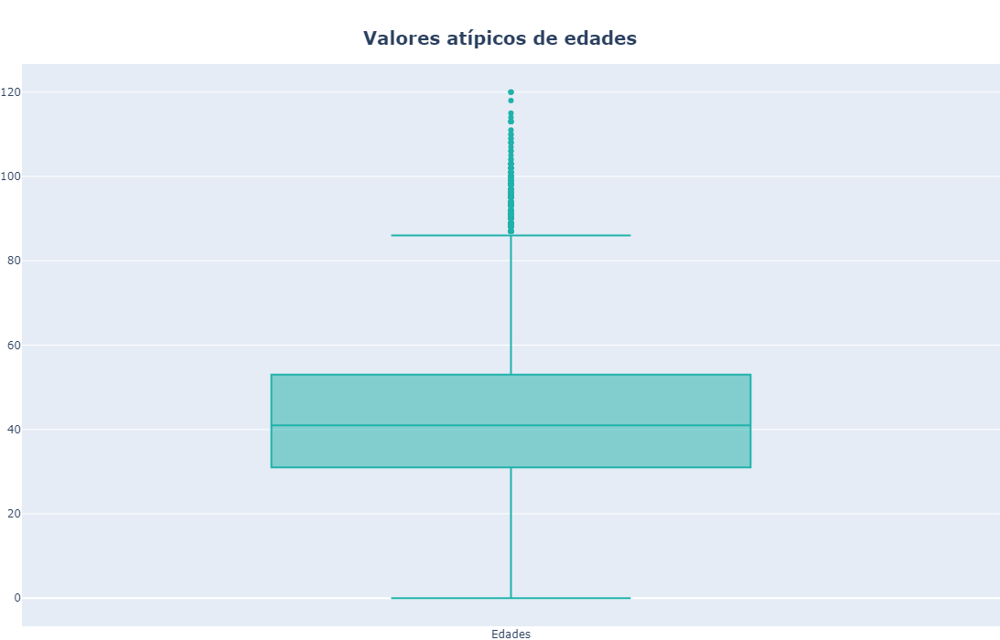

In [47]:
y0 = COVID["EDAD"]
fig = go.Figure()
fig.update_layout(
    width=700,
    height=700,
     title={
   'text': "<b>Valores atípicos de edades</b>",
        'font': {
            'size': 20,
        },
        'x': 0.5,
        'y': 0.95,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    margin=dict(t=70, l=0, r=0, b=0),
)
fig.add_trace(go.Box(y=y0, name= "Edades",marker_color = 'lightseagreen'))
fig.show()

In [48]:
# Prueba de chi cuadrada para determinar si existe una relación entre los pacientes difuntos y los pacientes con neumonía
filtro_intubados = COVID[["DIFUNTO","NEUMONIA"]]
filtro_intubados_filtrado = filtro_intubados[filtro_intubados["NEUMONIA"].isin([1,2])]
cuenta = filtro_intubados_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='NEUMONIA', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

NEUMONIA      1       2
DIFUNTO                
0         38671  217291
1          3125    1285

Chi-cuadrado: 9996.245878889957

p-value: 0.0

Grados de libertad: 1

Tabla esperada:

 [[ 41088.0883966 214873.9116034]
 [   707.9116034   3702.0883966]]

Valor de Cramér: 0.1959391977114293

EXISTE UNA ASOCIACIÓN PEQUEÑA ENTRE LAS VARIABLES


C:\Users\marie\AppData\Local\Temp\ipykernel_9108\2104117692.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.

C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [49]:
# Prueba de chi cuadrada para determinar si existe una relación entre los pacientes difuntos y los pacientes que pasaron por UCI
filtro_UCI = COVID[["DIFUNTO","UCI"]]
filtro_UCI_filtrado = filtro_UCI[filtro_UCI["UCI"].isin([1,2])]
cuenta = filtro_UCI_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='UCI', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

UCI         1       2
DIFUNTO              
0        3936  252026
1         616    3794

Chi-cuadrado: 3892.6409335458875

p-value: 0.0

Grados de libertad: 1

Tabla esperada:

 [[4.47490139e+03 2.51487099e+05]
 [7.70986128e+01 4.33290139e+03]]

Valor de Cramér: 0.1222714417237685

EXISTE UNA ASOCIACIÓN PEQUEÑA ENTRE LAS VARIABLES


C:\Users\marie\AppData\Local\Temp\ipykernel_9108\1412920006.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.

C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [50]:
#ASOCIACIÓN ENTRE DIABETES Y DIFUNTOS
filtro = COVID[["DIFUNTO","DIABETES"]]
filtro_filtrado = filtro[filtro["DIABETES"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='DIABETES', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

DIABETES      1       2
DIFUNTO                
0         31882  224080
1          1757    2653

Chi-cuadrado: 2887.529902676339

p-value: 0.0

Grados de libertad: 1

Tabla esperada:

 [[ 33069.24599419 222892.75400581]
 [   569.75400581   3840.24599419]]

Valor de Cramér: 0.10530914958345537

EXISTE UNA ASOCIACIÓN PEQUEÑA ENTRE LAS VARIABLES


C:\Users\marie\AppData\Local\Temp\ipykernel_9108\969779313.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.

C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [51]:
#ASOCIACIÓN ENTRE EPOC Y DIFUNTOS
filtro = COVID[["DIFUNTO","EPOC"]]
filtro_filtrado = filtro[filtro["EPOC"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='EPOC', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\2588873589.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.



EPOC        1       2
DIFUNTO              
0        4812  251150
1         317    4093

Chi-cuadrado: 629.8454934363551

p-value: 5.400389859057475e-139

Grados de libertad: 1

Tabla esperada:

 [[5.04212856e+03 2.50919871e+05]
 [8.68714378e+01 4.32312856e+03]]

Valor de Cramér: 0.04918355015024189

\LA ASOCIACIÓN ENTRE LAS VARIABLES ES SIGNIFICATIVA PERO MUY PEQUEÑA


C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [52]:
#ASOCIACIÓN ENTRE ASMA Y DIFUNTOS
filtro = COVID[["DIFUNTO","ASMA"]]
filtro_filtrado = filtro[filtro["ASMA"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='ASMA', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

ASMA        1       2
DIFUNTO              
0        9360  246602
1          98    4312

Chi-cuadrado: 25.079378618840312

p-value: 5.50180866430088e-07

Grados de libertad: 1

Tabla esperada:

 [[9.29780697e+03 2.46664193e+05]
 [1.60193032e+02 4.24980697e+03]]

Valor de Cramér: 0.009814343326566189

\LA ASOCIACIÓN ENTRE LAS VARIABLES ES SIGNIFICATIVA PERO MUY PEQUEÑA


C:\Users\marie\AppData\Local\Temp\ipykernel_9108\225607579.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.

C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [53]:
#ASOCIACIÓN ENTRE PACIENTES INMUNUSUPRIMIDOS Y DIFUNTOS
filtro = COVID[["DIFUNTO","INMUSUPR"]]
filtro_filtrado = filtro[filtro["INMUSUPR"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='INMUSUPR', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\916218646.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.

C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



INMUSUPR     1       2
DIFUNTO               
0         4781  251181
1          213    4197

Chi-cuadrado: 200.62282975482327

p-value: 1.5272760300836246e-45

Grados de libertad: 1

Tabla esperada:

 [[4.90941510e+03 2.51052585e+05]
 [8.45849016e+01 4.32541510e+03]]

Valor de Cramér: 0.027758310944746685

\LA ASOCIACIÓN ENTRE LAS VARIABLES ES SIGNIFICATIVA PERO MUY PEQUEÑA


In [54]:
#ASOCIACIÓN ENTRE PACIENTES HIPERTENSOS Y DIFUNTOS
filtro = COVID[["DIFUNTO","HIPERTENSION"]]
filtro_filtrado = filtro[filtro["HIPERTENSION"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='HIPERTENSION', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

HIPERTENSION      1       2
DIFUNTO                    
0             41945  214017
1              1898    2512

Chi-cuadrado: 2197.1237493368403

p-value: 0.0

Grados de libertad: 1

Tabla esperada:

 [[ 43100.41773309 212861.58226691]
 [   742.58226691   3667.41773309]]

Valor de Cramér: 0.09186077809521989

EXISTE UNA ASOCIACIÓN PEQUEÑA ENTRE LAS VARIABLES


C:\Users\marie\AppData\Local\Temp\ipykernel_9108\2520796255.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.

C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [55]:
#ASOCIACIÓN ENTRE PACIENTES CON ENFERMEDAD CARDIVASCULAR Y DIFUNTOS
filtro = COVID[["DIFUNTO","CARDIOVASCULAR"]]
filtro_filtrado = filtro[filtro["CARDIOVASCULAR"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='CARDIOVASCULAR', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\1734246797.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.



CARDIOVASCULAR     1       2
DIFUNTO                     
0               6393  249569
1                310    4100

Chi-cuadrado: 353.189652126218

p-value: 8.561631537358065e-79

Grados de libertad: 1

Tabla esperada:

 [[6.58946924e+03 2.49372531e+05]
 [1.13530756e+02 4.29646924e+03]]

Valor de Cramér: 0.03683043480293721

\LA ASOCIACIÓN ENTRE LAS VARIABLES ES SIGNIFICATIVA PERO MUY PEQUEÑA


C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [56]:
#ASOCIACIÓN ENTRE PACIENTES CON ENFERMEDAD OBESIDAD Y DIFUNTOS
filtro = COVID[["DIFUNTO","OBESIDAD"]]
filtro_filtrado = filtro[filtro["OBESIDAD"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='OBESIDAD', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

OBESIDAD      1       2
DIFUNTO                
0         42246  213716
1          1096    3314

Chi-cuadrado: 217.1322423059024

p-value: 3.818853064740729e-49

Grados de libertad: 1

Tabla esperada:

 [[ 42607.90332294 213354.09667706]
 [   734.09667706   3675.90332294]]

Valor de Cramér: 0.028877860832710895

\LA ASOCIACIÓN ENTRE LAS VARIABLES ES SIGNIFICATIVA PERO MUY PEQUEÑA


C:\Users\marie\AppData\Local\Temp\ipykernel_9108\3213523533.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.

C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [57]:
#ASOCIACIÓN ENTRE PACIENTES CON ENFERMEDAD RENAL CRÓNICA Y DIFUNTOS
filtro = COVID[["DIFUNTO","RENAL_CRONICA"]]
filtro_filtrado = filtro[filtro["RENAL_CRONICA"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='RENAL_CRONICA', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

RENAL_CRONICA     1       2
DIFUNTO                    
0              5274  250688
1               392    4018

Chi-cuadrado: 946.3802010369052

p-value: 8.12082211454035e-208

Grados de libertad: 1

Tabla esperada:

 [[5.57003323e+03 2.50391967e+05]
 [9.59667706e+01 4.31403323e+03]]

Valor de Cramér: 0.060288667257945246

\LA ASOCIACIÓN ENTRE LAS VARIABLES ES SIGNIFICATIVA PERO MUY PEQUEÑA


C:\Users\marie\AppData\Local\Temp\ipykernel_9108\4162419632.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.

C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [58]:
#ASOCIACIÓN ENTRE PACIENTES CON TABAQUISMO Y DIFUNTOS
filtro = COVID[["DIFUNTO","TABAQUISMO"]]
filtro_filtrado = filtro[filtro["TABAQUISMO"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='TABAQUISMO', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\2172381694.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.



TABAQUISMO      1       2
DIFUNTO                  
0           23067  232895
1             456    3954

Chi-cuadrado: 9.145971026712674

p-value: 0.002492663205401545

Grados de libertad: 1

Tabla esperada:

 [[ 23124.58377245 232837.41622755]
 [   398.41622755   4011.58377245]]

Valor de Cramér: 0.005926765867575549

\LA ASOCIACIÓN ENTRE LAS VARIABLES ES SIGNIFICATIVA PERO MUY PEQUEÑA


C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [59]:
#ASOCIACIÓN ENTRE PACIENTES INTUBADOS Y DIFUNTOS
filtro = COVID[["DIFUNTO","INTUBADO"]]
filtro_filtrado = filtro[filtro["INTUBADO"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='INTUBADO', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

INTUBADO     1       2
DIFUNTO               
0         2849  253113
1          847    3563

Chi-cuadrado: 10129.13936610514

p-value: 0.0

Grados de libertad: 1

Tabla esperada:

 [[3.63339972e+03 2.52328600e+05]
 [6.26002796e+01 4.34739972e+03]]

Valor de Cramér: 0.1972373385904949

EXISTE UNA ASOCIACIÓN PEQUEÑA ENTRE LAS VARIABLES


C:\Users\marie\AppData\Local\Temp\ipykernel_9108\3446727603.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.

C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [60]:
#ASOCIACIÓN ENTRE PACIENTES CON OTRAS CONMORBILIDADES Y DIFUNTOS
filtro = COVID[["DIFUNTO","OTRA_COM"]]
filtro_filtrado = filtro[filtro["OTRA_COM"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='OTRA_COM', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\2675410196.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.



OTRA_COM     1       2
DIFUNTO               
0         9208  246754
1          345    4065

Chi-cuadrado: 217.83906806349827

p-value: 2.677616062264582e-49

Grados de libertad: 1

Tabla esperada:

 [[9.39119792e+03 2.46570802e+05]
 [1.61802075e+02 4.24819792e+03]]

Valor de Cramér: 0.028924825372055485

\LA ASOCIACIÓN ENTRE LAS VARIABLES ES SIGNIFICATIVA PERO MUY PEQUEÑA


C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [61]:
#ASOCIACIÓN ENTRE PACIENTES EMBARAZADAS Y DIFUNTOS
filtro = COVID[["DIFUNTO","EMBARAZO"]]
filtro_filtrado = filtro[filtro["EMBARAZO"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='EMBARAZO', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

EMBARAZO     1       2
DIFUNTO               
0         2051  253911
1            8    4402

Chi-cuadrado: 20.45103166702676

p-value: 6.1176570481563216e-06

Grados de libertad: 1

Tabla esperada:

 [[2.02412609e+03 2.53937874e+05]
 [3.48739112e+01 4.37512609e+03]]

Valor de Cramér: 0.00886258617527488

\LA ASOCIACIÓN ENTRE LAS VARIABLES ES SIGNIFICATIVA PERO MUY PEQUEÑA


C:\Users\marie\AppData\Local\Temp\ipykernel_9108\719237142.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.

C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [62]:
#ASOCIACIÓN ENTRE PACIENTES SEXO Y DIFUNTOS
filtro = COVID[["DIFUNTO","SEXO"]]
filtro_filtrado = filtro[filtro["SEXO"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='SEXO', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\311873963.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.

C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



SEXO          1       2
DIFUNTO                
0        125808  130154
1          1561    2849

Chi-cuadrado: 327.66232891542273

p-value: 3.104135335427742e-73

Grados de libertad: 1

Tabla esperada:

 [[125211.71238843 130750.28761157]
 [  2157.28761157   2252.71238843]]

Valor de Cramér: 0.03547448647302991

\LA ASOCIACIÓN ENTRE LAS VARIABLES ES SIGNIFICATIVA PERO MUY PEQUEÑA


## **Remuestreo de datos (Subsampling con NEARMISS, Oversampling con Smote)**

In [63]:
#Función para determinar, mediante la prueba de Kolmorogov-Smirnov de dos muestras, si tienen la misma distribución
#de probabilidad o no, con cierto nivel de significancia estadística.
def KS_TEST(niv_significancia, dist1, dist2):

    test = ks_2samp(dist1,dist2)
    
    if(niv_significancia == 0.1):
        calpha = 1.22
    if(niv_significancia == 0.05):
        calpha = 1.36
    if(niv_significancia == 0.025):
        calpha = 1.48
    if(niv_significancia == 0.01):
        calpha = 1.63
        
    Dvalue = calpha*np.sqrt( ( (len(covid_remuestreado_difunto) + len(covid_difunto) ) /  (len(covid_remuestreado_difunto) * len(covid_difunto)) ) )
    print("RESULTADOS:", test)
    print("Valor crítico (D): ", Dvalue)

    valores_min = min(dist1.min(), dist2.min())
    valores_max = max(dist1.max(), dist2.max())
    
    if(len(dist1) < len(dist2)):
        dist2ws = np.linspace(valores_min, valores_max, len(dist1))
        dist1ws = dist1
    if(len(dist2) < len(dist1)):
        dist1ws = np.linspace(valores_min, valores_max, len(dist2))
        dist2ws = dist2
    if(len(dist2) == len(dist1)):
        dist1ws = dist1
        dist2ws = dist2
    distance_wassterstein = wasserstein_distance(dist1ws, dist2ws)

    print("DISTANCIA WASSTERSTEIN = ", distance_wassterstein)
    if (test[0] > Dvalue):
        print("Para el nivel de significancia ", niv_significancia, " las dos muestras provienen de distribuciones diferentes")
    else:
        print("Para el nivel de significancia ", niv_significancia, " las dos muestras provienen de la misma distribución")

In [64]:
# #Aplicar near miss 
X = COVID.drop(columns = ["DIFUNTO", "FECHA_ARCHIVO", "FECHA_DEF", "ENTIDAD", "ENTIDAD_UM", "ENTIDAD_RES", "ENTIDAD_REGISTRO",
                          "ORIGEN", "SECTOR","NACIONALIDAD","HABLA_LENGUA_INDIG","FECHA_ACTUALIZACION","FECHA_INGRESO",
                          "MIGRANTE","FECHA_SINTOMAS","PAIS_NACIONALIDAD","PAIS_ORIGEN", "MUNICIPIO_RES", "OTRO_CASO"], axis = 1)
Y = COVID["DIFUNTO"]

nm2 = NearMiss(sampling_strategy = 0.2,n_neighbors = 3)
X_resampled1, y_resampled1 = nm2.fit_resample(X, Y)
COVID_REMUESTREADO = pd.concat([pd.DataFrame(X_resampled1), pd.Series(y_resampled1, name='DIFUNTO')], axis=1)
COVID_REMUESTREADO

,id,RESULTADO,SEXO,TIPO_PACIENTE,INTUBADO,NEUMONIA,EDAD,EMBARAZO,DIABETES,EPOC,...,INMUSUPR,HIPERTENSION,OTRA_COM,CARDIOVASCULAR,OBESIDAD,RENAL_CRONICA,TABAQUISMO,UCI,RANGO_EDADES,DIFUNTO
0,33195,1,1,2,2,1,60,2,2,2,...,2,1,2,2,1,2,2,2,4.0,0
1,13708,2,1,1,2,2,49,2,2,2,...,2,2,2,2,2,2,2,2,3.0,0
2,4969,1,1,2,2,1,62,2,2,2,...,2,1,2,2,2,2,2,2,4.0,0
3,15085,2,2,1,2,2,61,2,2,2,...,2,2,2,2,1,2,2,2,4.0,0
4,33199,1,2,2,2,1,63,2,2,2,...,2,2,2,2,2,2,2,2,4.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26455,7054908,1,2,2,2,2,36,2,1,1,...,2,1,2,2,1,2,2,2,3.0,1
26456,7050226,1,2,2,2,2,77,2,1,2,...,2,1,2,1,2,2,2,2,5.0,1
26457,7043441,1,1,1,2,2,60,2,2,2,...,2,2,2,2,2,2,2,2,4.0,1
26458,7053721,1,1,2,2,1,53,2,1,1,...,2,2,2,2,1,2,2,2,4.0,1


C:\Users\marie\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\marie\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



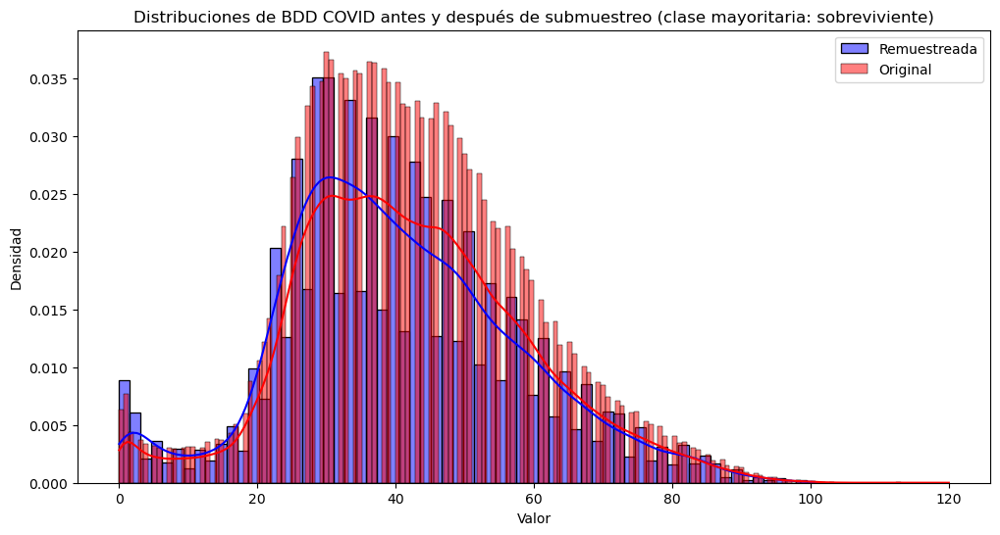

In [65]:
plt.figure(figsize=(12, 6))

covid_remuestreado_sobreviviente= COVID_REMUESTREADO[COVID_REMUESTREADO["DIFUNTO"] == 0]
covid_sobreviviente = COVID[COVID["DIFUNTO"] == 0]

sns.histplot(covid_remuestreado_sobreviviente["EDAD"], color='blue', kde=True, label='Remuestreada', stat="density")
sns.histplot(covid_sobreviviente["EDAD"], color='red', kde=True, label='Original', stat="density")
plt.title('Distribuciones de BDD COVID antes y después de submuestreo (clase mayoritaria: sobreviviente)')
plt.xlabel('Valor')
plt.ylabel('Densidad')
plt.legend()
plt.show()

In [66]:
print("CLASE SOBREVIVIENTE. DISTRIBUCION DE EDADES ORIGINAL")
mean = covid_sobreviviente["EDAD"].mean()
median = covid_sobreviviente["EDAD"].median()
mode = covid_sobreviviente["EDAD"].mode()
skew1 =covid_sobreviviente["EDAD"].skew()
kurt1 = covid_sobreviviente["EDAD"].kurt()
var1 = covid_sobreviviente["EDAD"].var()

print("La media es:", mean)
print("La mediana es:", median)
print("La moda es:", mode)
print("El sesgo es:", skew1)
print("La kurtosis es:", kurt1)
print("La varianza es:", var1)

CLASE SOBREVIVIENTE. DISTRIBUCION DE EDADES ORIGINAL
La media es: 42.255830943655695
La mediana es: 41.0
La moda es: 0    30
Name: EDAD, dtype: int64
El sesgo es: 0.26708570140048216
La kurtosis es: 0.21468398192738736
La varianza es: 279.96927821956115


In [67]:
print("CLASE SOBREVIVIENTE. DISTRIBUCION DE EDADES SUBMUESTREADA")
mean = covid_remuestreado_sobreviviente["EDAD"].mean()
median = covid_remuestreado_sobreviviente["EDAD"].median()
mode = covid_remuestreado_sobreviviente["EDAD"].mode()
skew2 =covid_remuestreado_sobreviviente["EDAD"].skew()
kurt2 = covid_remuestreado_sobreviviente["EDAD"].kurt()
var2 = covid_remuestreado_sobreviviente["EDAD"].var()


print("La media es:", mean)
print("La mediana es:", median)
print("La moda es:", mode)
print("El sesgo es:", skew2)
print("La kurtosis es:", kurt2)
print("La varianza es:", var2)

CLASE SOBREVIVIENTE. DISTRIBUCION DE EDADES SUBMUESTREADA
La media es: 40.468163265306124
La mediana es: 39.0
La moda es: 0    29
Name: EDAD, dtype: int64
El sesgo es: 0.30036775675466326
La kurtosis es: 0.1831934279667755
La varianza es: 294.3733570961154


In [68]:
X = COVID_REMUESTREADO.drop('DIFUNTO', axis=1) 
Y = COVID_REMUESTREADO['DIFUNTO']

indices_columnas_categoricas = [1,2,3,4,5,7,8,9,10,11,12,13,14,15,16,17,18,19]

smote = SMOTENC(categorical_features = indices_columnas_categoricas, sampling_strategy = 0.8,  k_neighbors=3) 
X_resampled, y_resampled = smote.fit_resample(X, Y)
COVID_REMUESTREADO_2 = pd.concat([pd.DataFrame(X_resampled, columns=X.columns), pd.DataFrame({'DIFUNTO': y_resampled})], axis=1)

C:\Users\marie\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

C:\Users\marie\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



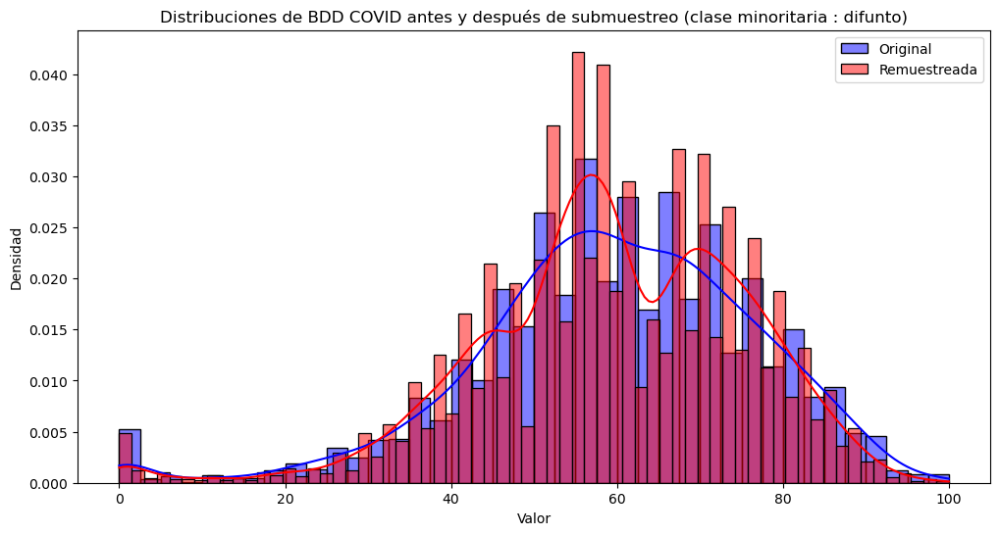

In [69]:
plt.figure(figsize=(12, 6))

covid_remuestreado_difunto = COVID_REMUESTREADO_2[COVID_REMUESTREADO_2["DIFUNTO"] == 1]
covid_difunto = COVID[COVID["DIFUNTO"] == 1]

sns.histplot(covid_difunto["EDAD"], color='blue', kde=True, label='Original', stat="density")
sns.histplot(covid_remuestreado_difunto["EDAD"], color='red', kde=True, label='Remuestreada', stat="density")
plt.title('Distribuciones de BDD COVID antes y después de submuestreo (clase minoritaria : difunto)')
plt.xlabel('Valor')
plt.ylabel('Densidad')
plt.legend()
plt.show()

In [70]:
print("CLASE DIFUNTOS. DISTRIBUCION DE EDADES ORIGINAL")
mean = covid_difunto["EDAD"].mean()
median = covid_difunto["EDAD"].median()
mode = covid_difunto["EDAD"].mode()
skew2 =covid_difunto["EDAD"].skew()
kurt2 = covid_difunto["EDAD"].kurt()
var2 = covid_difunto["EDAD"].var()

print("La media es:", mean)
print("La mediana es:", median)
print("La moda es:", mode)
print("El sesgo es:", skew2)
print("La kurtosis es:", kurt2)
print("La varianza es:", var2)

CLASE DIFUNTOS. DISTRIBUCION DE EDADES ORIGINAL
La media es: 59.50294784580499
La mediana es: 60.0
La moda es: 0    52
Name: EDAD, dtype: int64
El sesgo es: -0.6693446623785865
La kurtosis es: 1.0869541852440157
La varianza es: 287.8631121973245


In [71]:
print("CLASE DIFUNTOS. DISTRIBUCION DE EDADES REMUESTREADA")
mean = covid_remuestreado_difunto["EDAD"].mean()
median = covid_remuestreado_difunto["EDAD"].median()
mode = covid_remuestreado_difunto["EDAD"].mode()
skew3 =covid_remuestreado_difunto["EDAD"].skew()
kurt3 = covid_remuestreado_difunto["EDAD"].kurt()
var3 = covid_remuestreado_difunto["EDAD"].var()

print("La media es:", mean)
print("La mediana es:", median)
print("La moda es:", mode)
print("El sesgo es:", skew3)
print("La kurtosis es:", kurt3)
print("La varianza es:", var3)

CLASE DIFUNTOS. DISTRIBUCION DE EDADES REMUESTREADA
La media es: 59.41955782312925
La mediana es: 59.0
La moda es: 0    57
Name: EDAD, dtype: int64
El sesgo es: -0.6443729275254914
La kurtosis es: 0.9954031199016069
La varianza es: 258.1670079115053


In [72]:
KS_TEST(0.05, covid_remuestreado_sobreviviente["EDAD"],covid_sobreviviente["EDAD"])

RESULTADOS: KstestResult(statistic=0.056854054353058125, pvalue=1.7653090212561836e-57, statistic_location=36, statistic_sign=1)
Valor crítico (D):  0.02289679100985011
DISTANCIA WASSTERSTEIN =  22.24590079465351
Para el nivel de significancia  0.05  las dos muestras provienen de distribuciones diferentes


In [73]:
KS_TEST(0.05, covid_remuestreado_difunto["EDAD"],covid_difunto["EDAD"])

RESULTADOS: KstestResult(statistic=0.02511337868480723, pvalue=0.02295930292212008, statistic_location=61, statistic_sign=1)
Valor crítico (D):  0.02289679100985011
DISTANCIA WASSTERSTEIN =  13.714258147501837
Para el nivel de significancia  0.05  las dos muestras provienen de distribuciones diferentes


In [74]:
KS_TEST(0.05, covid_remuestreado_difunto["EDAD"],covid_remuestreado_sobreviviente["EDAD"])

RESULTADOS: KstestResult(statistic=0.4910430839002267, pvalue=0.0, statistic_location=50, statistic_sign=-1)
Valor crítico (D):  0.02289679100985011
DISTANCIA WASSTERSTEIN =  14.184310241850959
Para el nivel de significancia  0.05  las dos muestras provienen de distribuciones diferentes


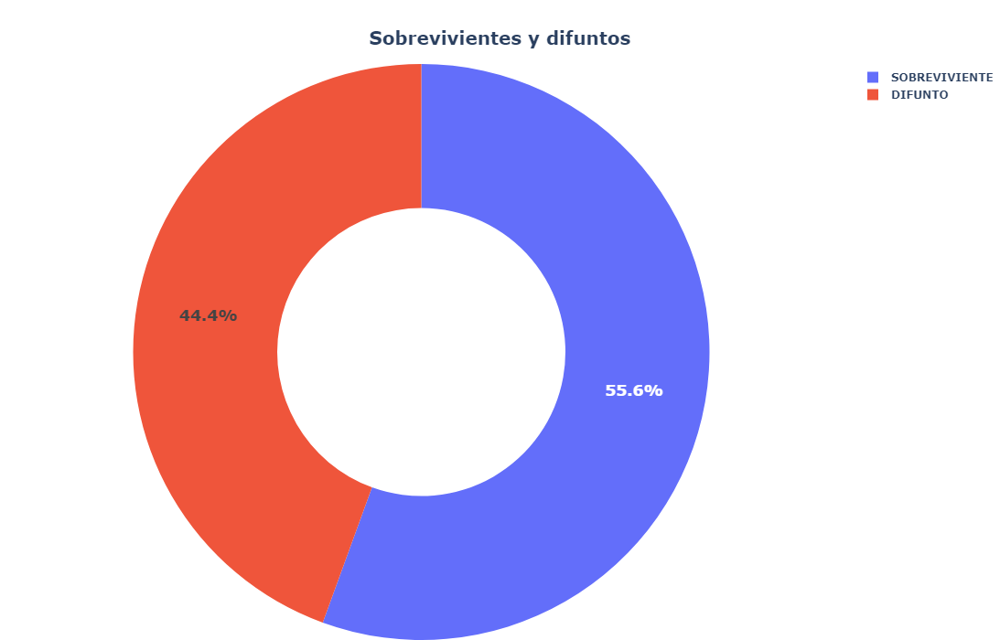

<Figure size 1400x800 with 0 Axes>

In [75]:
fig = plt.figure(figsize=(14,8))

fig = go.Figure(data=[go.Pie(labels=["<b>SOBREVIVIENTE</b>", "<b>DIFUNTO</b>"], values=COVID_REMUESTREADO_2["DIFUNTO"].value_counts(), hole=.5)])

fig.update_traces(hoverinfo="label+percent+value", texttemplate="<b>%{percent}</b>",insidetextfont=dict(size=17))
fig.update_layout(
    width=700, 
    height=700,
     title={
   'text': "<b>Sobrevivientes y difuntos</b>",
        'font': {
            'size': 20,
        },
        'x': 0.5,
        'y': 0.95,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    margin=dict(t=70, l=5, r=5, b=0),
)

fig.show()

In [76]:
conmorbilidades = ["NEUMONIA","DIABETES", "EPOC", "ASMA", "INMUSUPR", "HIPERTENSION", "OTRA_COM", "CARDIOVASCULAR", 
                   "OBESIDAD", "RENAL_CRONICA", "TABAQUISMO", "EMBARAZO"]
filtro_conmorbilidades = COVID_REMUESTREADO_2 [ conmorbilidades + [ "DIFUNTO" ] ]

In [77]:
ENFERMEDADES_FALLECIDOS = filtro_conmorbilidades[filtro_conmorbilidades["DIFUNTO"] == 1].apply(lambda x: x.value_counts().get(1, 0))
ENFERMEDADES_FALLECIDOS = pd.DataFrame(ENFERMEDADES_FALLECIDOS[:len(ENFERMEDADES_FALLECIDOS)-1])

ENFERMEDADES_SOBREVIVIENTES = filtro_conmorbilidades[filtro_conmorbilidades["DIFUNTO"] == 0].apply(lambda x: x.value_counts().get(1, 0))
ENFERMEDADES_SOBREVIVIENTES = pd.DataFrame(ENFERMEDADES_SOBREVIVIENTES[:len(ENFERMEDADES_SOBREVIVIENTES)-1])

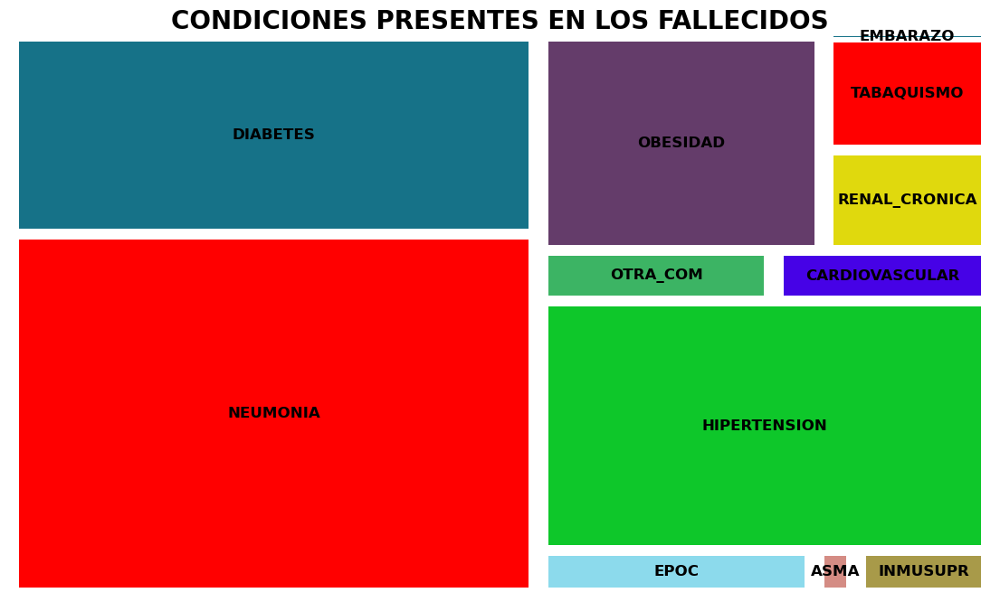

In [78]:
colors = ['red', '#167288', '#8cdaec',
          '#d48c84', '#a89a49', '#0ec72a', '#3cb464',
           '#4602e6','#643c6a','#e0d90d']

fig = plt.figure(figsize=(14,8))

squarify.plot(sizes=ENFERMEDADES_FALLECIDOS[0], 
              label=ENFERMEDADES_FALLECIDOS.index, 
              pad = 0.2, 
              text_kwargs = {'fontsize': 12, 'color': 'black', 'weight': 'bold'},
              color = colors)

plt.title("CONDICIONES PRESENTES EN LOS FALLECIDOS", fontsize = 20, weight = "bold")
plt.axis('off')
plt.show()

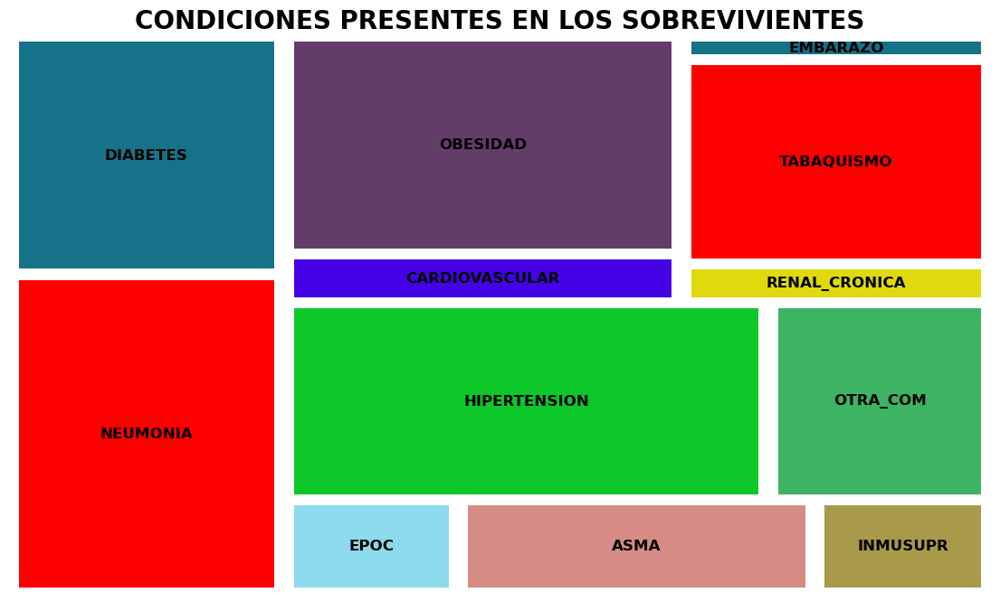

In [79]:
colors = ['red', '#167288', '#8cdaec',
          '#d48c84', '#a89a49', '#0ec72a', '#3cb464',
           '#4602e6','#643c6a','#e0d90d']

fig = plt.figure(figsize=(14,8))

squarify.plot(sizes=ENFERMEDADES_SOBREVIVIENTES[0], 
              label=ENFERMEDADES_SOBREVIVIENTES.index, 
              pad = 0.2, 
              text_kwargs = {'fontsize': 12, 'color': 'black', 'weight': 'bold'},
              color = colors)

plt.title("CONDICIONES PRESENTES EN LOS SOBREVIVIENTES", fontsize = 20, weight = "bold")
plt.axis('off')
plt.show()

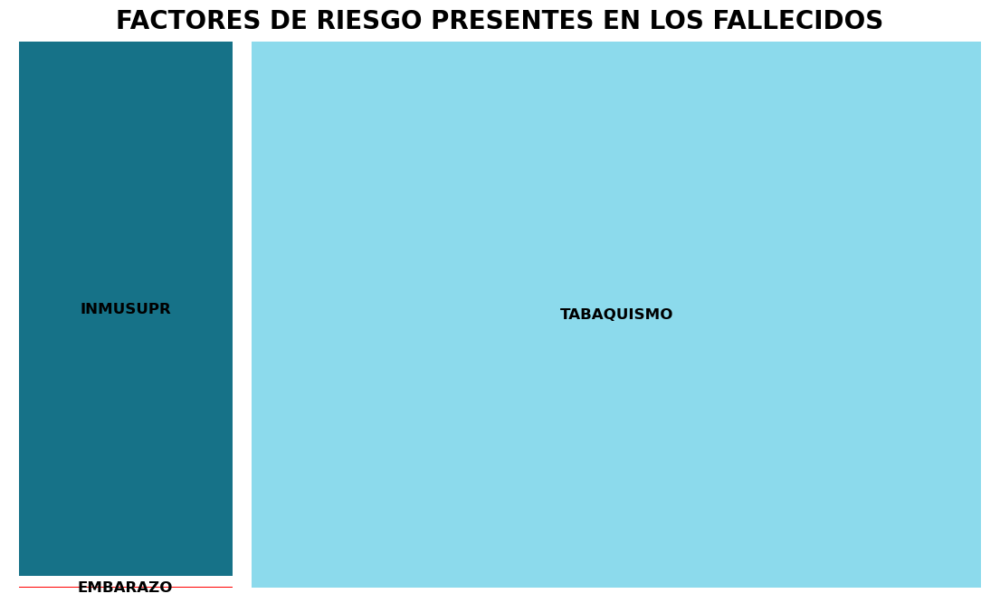

In [80]:
factores_riesgo =  ["EMBARAZO","INMUSUPR", "TABAQUISMO"]

filtro_factores_riesgo = COVID_REMUESTREADO_2 [ factores_riesgo + [ "DIFUNTO" ] ]

FACTORES_RIESGO_FALLECIDOS = filtro_factores_riesgo[filtro_factores_riesgo["DIFUNTO"] == 1].apply(lambda x: x.value_counts().get(1, 0))
FACTORES_RIESGO_FALLECIDOS = pd.DataFrame(FACTORES_RIESGO_FALLECIDOS[:len(FACTORES_RIESGO_FALLECIDOS)-1])

fig = plt.figure(figsize=(14,8))

squarify.plot(sizes=FACTORES_RIESGO_FALLECIDOS[0], 
              label=FACTORES_RIESGO_FALLECIDOS.index, 
              pad = 0.2, 
              text_kwargs = {'fontsize': 12, 'color': 'black', 'weight': 'bold'},
              color = colors)

plt.title("FACTORES DE RIESGO PRESENTES EN LOS FALLECIDOS", fontsize = 20, weight = "bold")
plt.axis('off')
plt.show()

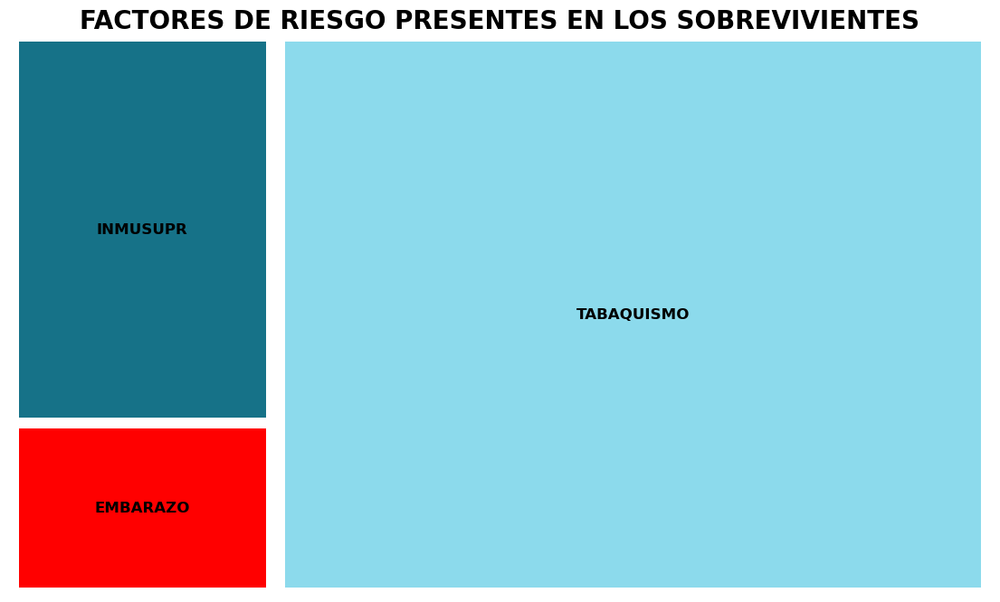

In [81]:
factores_riesgo =  ["EMBARAZO","INMUSUPR", "TABAQUISMO"]

filtro_factores_riesgo = COVID_REMUESTREADO_2 [ factores_riesgo + [ "DIFUNTO" ] ]

FACTORES_RIESGO_VIVOS = filtro_factores_riesgo[filtro_factores_riesgo["DIFUNTO"] == 0].apply(lambda x: x.value_counts().get(1, 0))
FACTORES_RIESGO_VIVOS = pd.DataFrame(FACTORES_RIESGO_VIVOS[:len(FACTORES_RIESGO_VIVOS)-1])

fig = plt.figure(figsize=(14,8))

squarify.plot(sizes=FACTORES_RIESGO_VIVOS[0], 
              label=FACTORES_RIESGO_VIVOS.index, 
              pad = 0.2, 
              text_kwargs = {'fontsize': 12, 'color': 'black', 'weight': 'bold'},
              color = colors)

plt.title("FACTORES DE RIESGO PRESENTES EN LOS SOBREVIVIENTES", fontsize = 20, weight = "bold")
plt.axis('off')
plt.show()

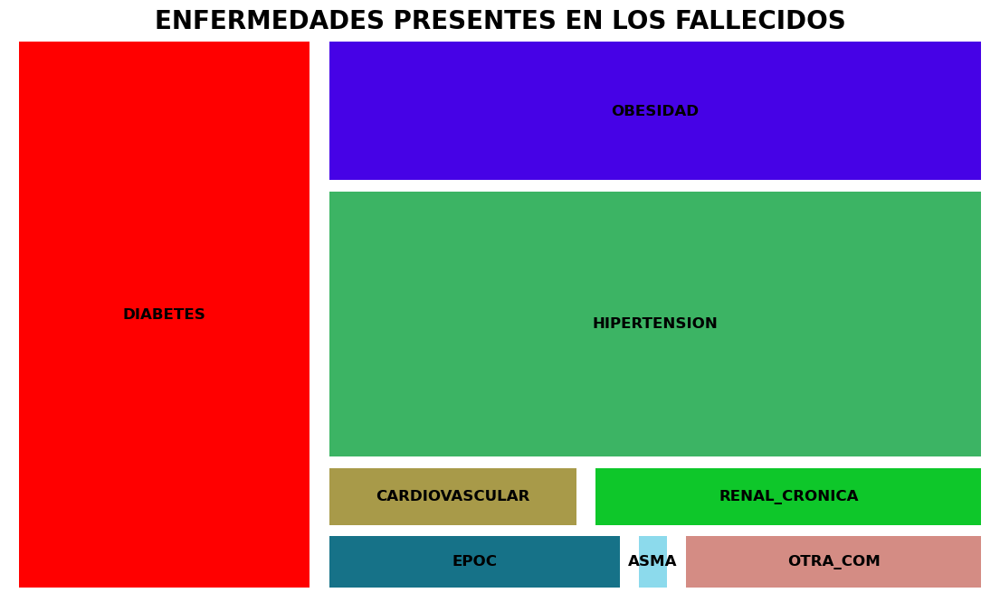

In [82]:
enfermedades =  ["DIABETES", "EPOC", "ASMA", "OTRA_COM", "CARDIOVASCULAR", "RENAL_CRONICA","HIPERTENSION", "OBESIDAD"]
filtro_enfermedades = COVID_REMUESTREADO_2 [ enfermedades + [ "DIFUNTO" ] ]

ENFERMEDADES_FALLECIDOS = filtro_enfermedades[filtro_enfermedades["DIFUNTO"] == 1].apply(lambda x: x.value_counts().get(1, 0))
ENFERMEDADES_FALLECIDOS = pd.DataFrame(ENFERMEDADES_FALLECIDOS[:len(ENFERMEDADES_FALLECIDOS)-1])

fig = plt.figure(figsize=(14,8))

squarify.plot(sizes=ENFERMEDADES_FALLECIDOS[0], 
              label=ENFERMEDADES_FALLECIDOS.index, 
              pad = 0.2, 
              text_kwargs = {'fontsize': 12, 'color': 'black', 'weight': 'bold'},
              color = colors)

plt.title("ENFERMEDADES PRESENTES EN LOS FALLECIDOS", fontsize = 20, weight = "bold")
plt.axis('off')
plt.show()

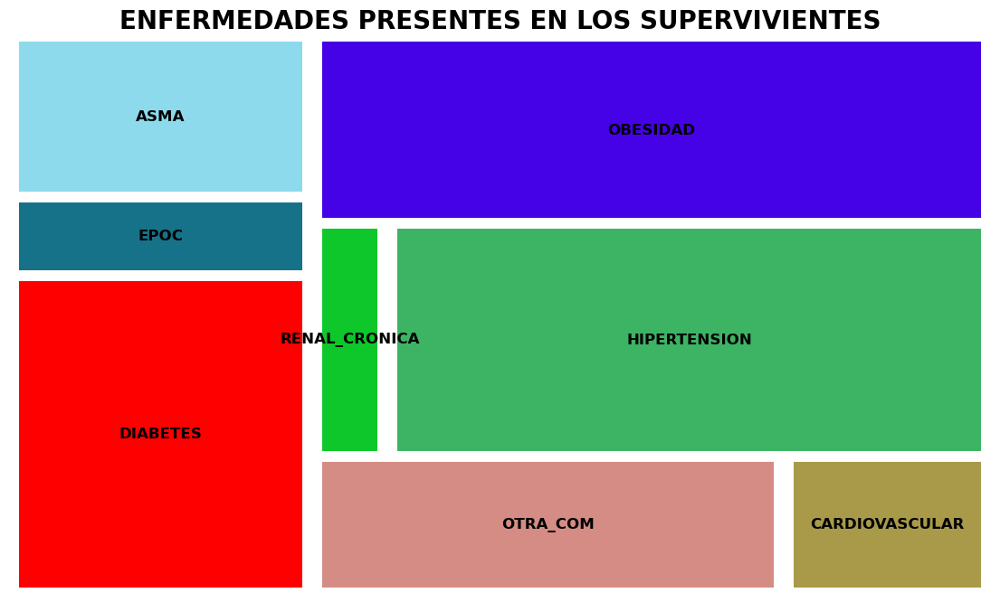

In [83]:
enfermedades =  ["DIABETES", "EPOC", "ASMA", "OTRA_COM", "CARDIOVASCULAR", "RENAL_CRONICA","HIPERTENSION", "OBESIDAD", ]
filtro_enfermedades = COVID_REMUESTREADO_2 [ enfermedades + [ "DIFUNTO" ] ]

ENFERMEDADES_VIVOS = filtro_enfermedades[filtro_enfermedades["DIFUNTO"] == 0].apply(lambda x: x.value_counts().get(1, 0))
ENFERMEDADES_VIVOS = pd.DataFrame(ENFERMEDADES_VIVOS[:len(ENFERMEDADES_VIVOS)-1])

fig = plt.figure(figsize=(14,8))

squarify.plot(sizes=ENFERMEDADES_VIVOS[0], 
              label=ENFERMEDADES_VIVOS.index, 
              pad = 0.2, 
              text_kwargs = {'fontsize': 12, 'color': 'black', 'weight': 'bold'},
              color = colors)

plt.title("ENFERMEDADES PRESENTES EN LOS SUPERVIVIENTES", fontsize = 20, weight = "bold")
plt.axis('off')
plt.show()

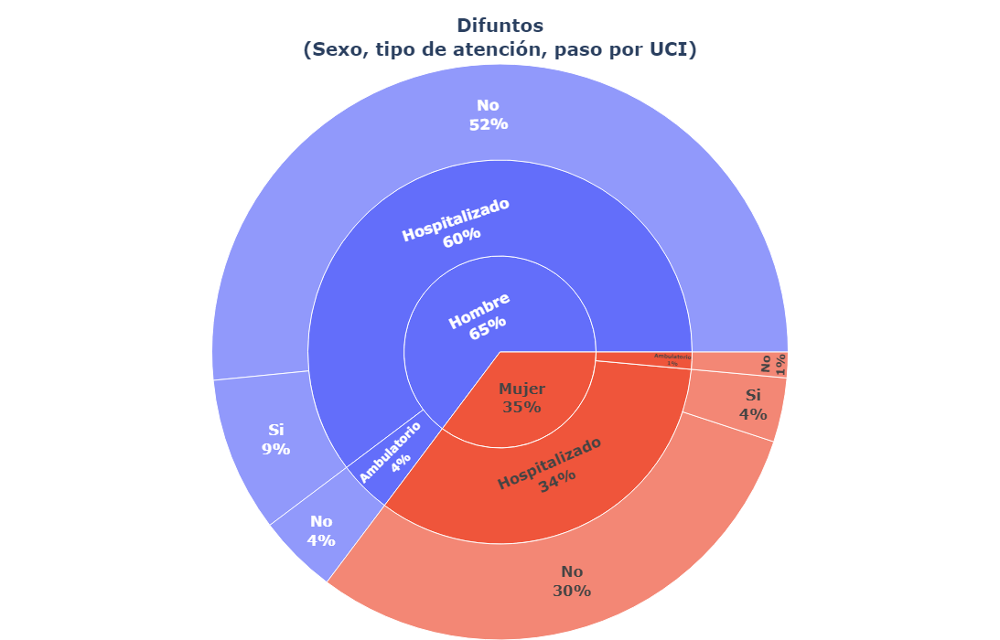

In [84]:
SUNBR = COVID_REMUESTREADO_2[["DIFUNTO", "SEXO", "TIPO_PACIENTE", "UCI"]]
SUNBR = SUNBR[SUNBR["DIFUNTO"] == 1]
SUNBR.drop(columns=["DIFUNTO"], inplace=True)
nombres_columnas = SUNBR.columns
SUNBR.columns = list(range(len(SUNBR.columns)))

# Mapear los valores numéricos a texto para cada columna
mapa_parents = {1: 'Mujer', 2: 'Hombre',  99: 'No especificado'}
mapa_labels = {1: 'Ambulatorio', 2: 'Hospitalizado', 99: 'No especificado'}
mapa_ids = {1: 'Si', 2: 'No', 97: 'No aplica', 98: 'Se ignora', 99: 'No especificado'}

SUNBR[0] = SUNBR[0].map(mapa_parents)
SUNBR[1] = SUNBR[1].map(mapa_labels)
SUNBR[2] = SUNBR[2].map(mapa_ids)

SUNBR['count'] = 1
values = SUNBR.groupby([0,1,2]).size().reset_index(name='counts')

# Preparar listas para ids, labels, parents y values
ids = []
labels = []
parents = []
values_list = []

for i, filas in values.iterrows():
    col1 = filas[0]
    col2 = filas[1]
    col3 = filas[2]
    count = filas["counts"]

    if col1 not in ids:
        ids.append(col1)
        labels.append(col1)
        parents.append('')
        values_list.append(values[values[0] == col1]["counts"].sum())

    if f'{col1}-{col2}' not in ids:
        ids.append(f'{col1}-{col2}')
        labels.append(col2)
        parents.append(col1)
        values_list.append(values[(values[0] == col1) & (values[1] == col2)]["counts"].sum())

    ids.append(f'{col1}-{col2}-{col3}')
    labels.append(col3)
    parents.append(f'{col1}-{col2}')
    values_list.append(count)

fig = go.Figure()

fig.add_trace(go.Sunburst(
    ids=ids,
    labels=labels,
    parents=parents,
    values=values_list, 
    branchvalues='total', 
    textinfo = "label+percent entry",
    texttemplate="<b>%{label}</b><br><b>%{percentEntry}</b>",
    insidetextfont=dict(size=16)
))

fig.update_layout(
    width=700,
    height=700,
     title={
   'text': "<b>Difuntos<br>(Sexo, tipo de atención, paso por UCI)</b>",
        'font': {
            'size': 20,
        },
        'x': 0.5,
        'y': 0.95,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    margin=dict(t=70, l=0, r=0, b=0),
)

fig.show()

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\3759314214.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\3759314214.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\3759314214.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

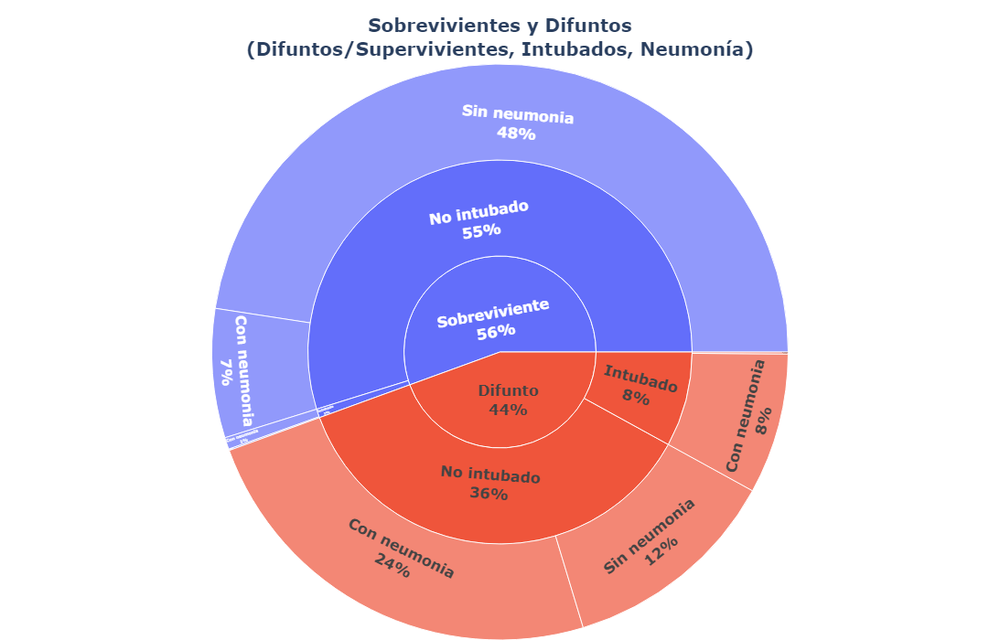

In [85]:
SUNBR = COVID_REMUESTREADO_2[["DIFUNTO", "INTUBADO", "NEUMONIA"]]
nombres_columnas = SUNBR.columns
SUNBR.columns = list(range(len(SUNBR.columns)))

# Mapear los valores numéricos a texto para cada columna
mapa_parents = {1: 'Difunto', 0: 'Sobreviviente'}
mapa_labels = {1: 'Intubado', 2: 'No intubado', 97: 'No aplica', 98:'Se ignora', 99: 'No especificado'}
mapa_ids = {1: 'Con neumonia', 2: 'Sin neumonia', 97: 'No aplica', 98:'Se ignora', 99: 'No especificado'}


SUNBR[0] = SUNBR[0].map(mapa_parents)
SUNBR[1] = SUNBR[1].map(mapa_labels)
SUNBR[2] = SUNBR[2].map(mapa_ids)

SUNBR['count'] = 1
values = SUNBR.groupby([0,1,2]).size().reset_index(name='counts')

# Preparar listas para ids, labels, parents y values
ids = []
labels = []
parents = []
values_list = []

for i, filas in values.iterrows():
    col1 = filas[0]
    col2 = filas[1]
    col3 = filas[2]
    count = filas["counts"]

    if col1 not in ids:
        ids.append(col1)
        labels.append(col1)
        parents.append('')
        values_list.append(values[values[0] == col1]["counts"].sum())

    if f'{col1}-{col2}' not in ids:
        ids.append(f'{col1}-{col2}')
        labels.append(col2)
        parents.append(col1)
        values_list.append(values[(values[0] == col1) & (values[1] == col2)]["counts"].sum())

    ids.append(f'{col1}-{col2}-{col3}')
    labels.append(col3)
    parents.append(f'{col1}-{col2}')
    values_list.append(count)

fig = go.Figure()

fig.add_trace(go.Sunburst(
    ids=ids,
    labels=labels,
    parents=parents,
    values=values_list, 
    branchvalues='total', 
    textinfo = "label+percent entry",
    texttemplate="<b>%{label}</b><br><b>%{percentEntry}</b>",
    insidetextfont=dict(size=16)
))

fig.update_layout(
    width=700,
    height=700,
     title={
   'text': "<b>Sobrevivientes y Difuntos<br>(Difuntos/Supervivientes, Intubados, Neumonía)</b>",
        'font': {
            'size': 20,
        },
        'x': 0.5,
        'y': 0.95,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    margin=dict(t=70, l=0, r=0, b=0),
)

fig.show()

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\1724388214.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\1724388214.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\1724388214.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

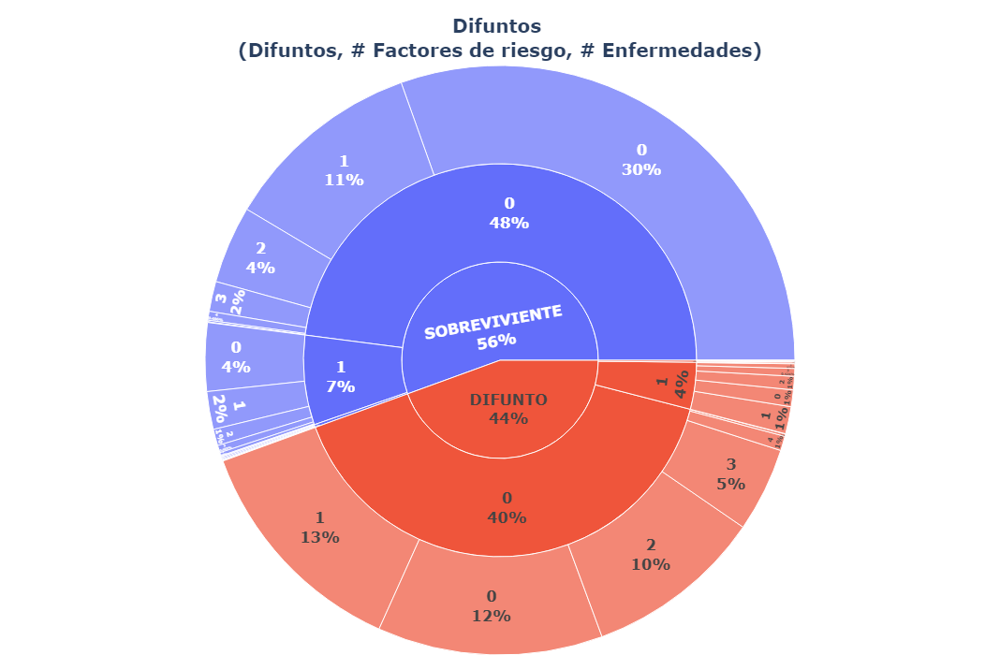

In [86]:
BDD_CANTIDAD_ENFERMEDADES = COVID_REMUESTREADO_2[ enfermedades + ["DIFUNTO"] ]

mapa_cuenta_enfermedades = {1: 1, 2: 0, 97: 0, 98: 0, 99: 0}

for columna in BDD_CANTIDAD_ENFERMEDADES.columns[:-1]:
    BDD_CANTIDAD_ENFERMEDADES[columna] = BDD_CANTIDAD_ENFERMEDADES[columna].map(mapa_cuenta_enfermedades)
BDD_CANTIDAD_ENFERMEDADES["CANT_ENF"] = BDD_CANTIDAD_ENFERMEDADES.iloc[:,:-1].sum(axis = 1)

BDD_CANTIDAD_ENFERMEDADES.drop(columns=enfermedades, inplace=True)


BDD_CANTIDAD_FACTORES_RIESGO = COVID_REMUESTREADO_2 [factores_riesgo + ["DIFUNTO"] ]
mapa_cuenta_factores_riesgo = {1: 1, 2: 0, 97: 0, 98: 0, 99: 0}
for columna in BDD_CANTIDAD_FACTORES_RIESGO.columns[:-1]:
    BDD_CANTIDAD_FACTORES_RIESGO[columna] = BDD_CANTIDAD_FACTORES_RIESGO[columna].map(mapa_cuenta_factores_riesgo)
#Eastablecer la condición para mostrar los que no aplican o no se sabe
BDD_CANTIDAD_FACTORES_RIESGO["CANT_FR"] = BDD_CANTIDAD_FACTORES_RIESGO.iloc[:,:-1].sum(axis = 1)


BDD_CANTIDAD_FACTORES_RIESGO.drop(columns=factores_riesgo, inplace=True)

BDD_CANTIDAD_CONDICIONES = BDD_CANTIDAD_FACTORES_RIESGO
BDD_CANTIDAD_CONDICIONES["CANT_ENF"] = BDD_CANTIDAD_ENFERMEDADES["CANT_ENF"]

#BDD_CANTIDAD_CONDICIONES["CANT_ENF"] = BDD_CANTIDAD_CONDICIONES["CANT_ENF"].apply(lambda x: 1 if x > 0 else 0)
#BDD_CANTIDAD_CONDICIONES["CANT_FR"] = BDD_CANTIDAD_CONDICIONES["CANT_FR"].apply(lambda x: 1 if x > 0 else 0)

BDD_CANTIDAD_CONDICIONES.columns = list(range(len(BDD_CANTIDAD_CONDICIONES.columns)))
# Mapear los valores numéricos a texto para cada columna
mapa_parents = {1: 'DIFUNTO', 0: 'SOBREVIVIENTE'}
#mapa_labels = {1: 'Con FR', 0: 'Sin FR', 97: 'No aplica', 98:'Se ignora', 99: 'No especificado'}
#mapa_ids = {1:  'Con enfermedades', 0: 'Sin enfermedades', 97: 'No aplica', 98:'Se ignora', 99: 'No especificado'}

BDD_CANTIDAD_CONDICIONES[0] = BDD_CANTIDAD_CONDICIONES[0].map(mapa_parents)
#BDD_CANTIDAD_CONDICIONES[1] = BDD_CANTIDAD_CONDICIONES[1].map(mapa_labels)
#BDD_CANTIDAD_CONDICIONES[2] = BDD_CANTIDAD_CONDICIONES[2].map(mapa_ids)

BDD_CANTIDAD_CONDICIONES['count'] = 1
values = BDD_CANTIDAD_CONDICIONES.groupby([0,1,2]).size().reset_index(name='counts')

# Preparar listas para ids, labels, parents y values
ids = []
labels = []
parents = []
values_list = []

for i, filas in values.iterrows():
    col1 = filas[0]
    col2 = filas[1]
    col3 = filas[2]
    count = filas["counts"]

    if col1 not in ids:
        ids.append(col1)
        labels.append(col1)
        parents.append('')
        values_list.append(values[values[0] == col1]["counts"].sum())

    if f'{col1}-{col2}' not in ids:
        ids.append(f'{col1}-{col2}')
        labels.append(col2)
        parents.append(col1)
        values_list.append(values[(values[0] == col1) & (values[1] == col2)]["counts"].sum())

    ids.append(f'{col1}-{col2}-{col3}')
    labels.append(col3)
    parents.append(f'{col1}-{col2}')
    values_list.append(count)

fig = go.Figure()

fig.add_trace(go.Sunburst(
    ids=ids,
    labels=labels,
    parents=parents,
    values=values_list, 
    branchvalues='total', 
    textinfo = "label+percent entry",
    texttemplate="<b>%{label}</b><br><b>%{percentEntry}</b>",
    insidetextfont=dict(size=16)
))

fig.update_layout(
    width=700,
    height=700,
     title={
   'text': "<b>Difuntos <br>(Difuntos, # Factores de riesgo, # Enfermedades)</b>",
        'font': {
            'size': 20,
        },
        'x': 0.5,
        'y': 0.95,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    margin=dict(t=70, l=0, r=0, b=0),
)
fig.show()

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\698932955.py:23: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\698932955.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\698932955.py:25: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-d

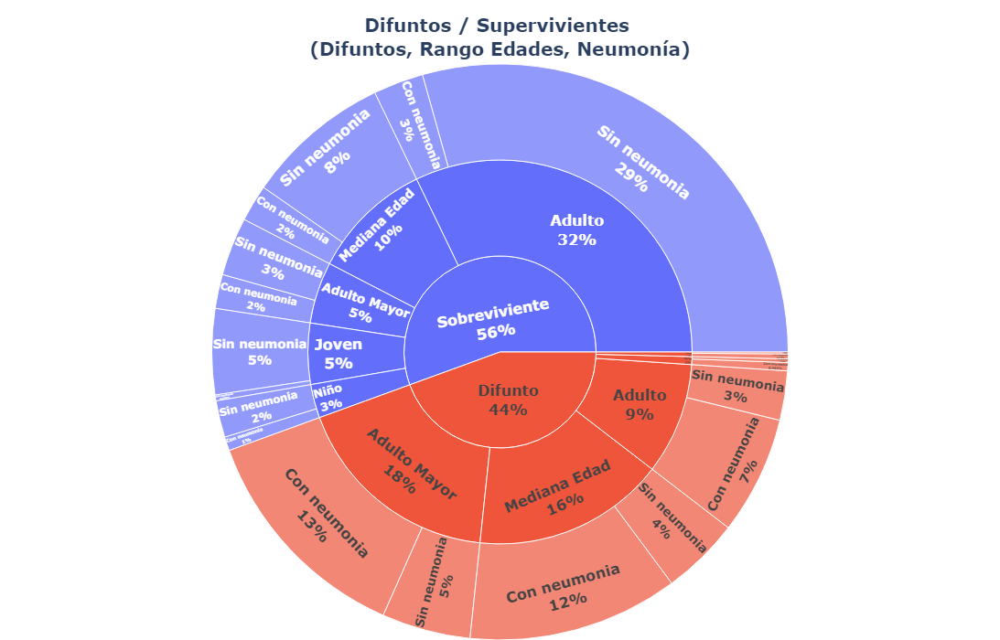

In [87]:
condiciones = [
    (COVID_REMUESTREADO_2['EDAD'] >= 0 ) & (COVID_REMUESTREADO_2['EDAD'] < 15),
    (COVID_REMUESTREADO_2['EDAD'] >= 15) & (COVID_REMUESTREADO_2['EDAD'] < 25),
    (COVID_REMUESTREADO_2['EDAD'] >= 25) & (COVID_REMUESTREADO_2['EDAD'] < 50),
    (COVID_REMUESTREADO_2['EDAD'] >= 50) & (COVID_REMUESTREADO_2['EDAD'] < 65),
    (COVID_REMUESTREADO_2['EDAD'] >= 65) 
]

mapeo = [1, 2, 3, 4, 5]

COVID_REMUESTREADO_2['RANGO_EDADES'] = np.select(condiciones, mapeo, default=np.nan)

SUNBR = COVID_REMUESTREADO_2[["DIFUNTO", "RANGO_EDADES", "NEUMONIA"]]
nombres_columnas = SUNBR.columns
SUNBR.columns = list(range(len(SUNBR.columns)))

# Mapear los valores numéricos a texto para cada columna
mapa_parents = {1: 'Difunto', 0: 'Sobreviviente'}
mapa_labels = {1: 'Niño', 2: 'Joven', 3: 'Adulto', 4:'Mediana Edad', 5: 'Adulto Mayor'}
mapa_ids = {1: 'Con neumonia', 2: 'Sin neumonia', 97: 'No aplica', 98:'Se ignora', 99: 'No especificado'}


SUNBR[0] = SUNBR[0].map(mapa_parents)
SUNBR[1] = SUNBR[1].map(mapa_labels)
SUNBR[2] = SUNBR[2].map(mapa_ids)

SUNBR['count'] = 1
values = SUNBR.groupby([0,1,2]).size().reset_index(name='counts')

# Preparar listas para ids, labels, parents y values
ids = []
labels = []
parents = []
values_list = []

for i, filas in values.iterrows():
    col1 = filas[0]
    col2 = filas[1]
    col3 = filas[2]
    count = filas["counts"]

    if col1 not in ids:
        ids.append(col1)
        labels.append(col1)
        parents.append('')
        values_list.append(values[values[0] == col1]["counts"].sum())

    if f'{col1}-{col2}' not in ids:
        ids.append(f'{col1}-{col2}')
        labels.append(col2)
        parents.append(col1)
        values_list.append(values[(values[0] == col1) & (values[1] == col2)]["counts"].sum())

    ids.append(f'{col1}-{col2}-{col3}')
    labels.append(col3)
    parents.append(f'{col1}-{col2}')
    values_list.append(count)

fig = go.Figure()

fig.add_trace(go.Sunburst(
    ids=ids,
    labels=labels,
    parents=parents,
    values=values_list, 
    branchvalues='total', 
    textinfo = "label+percent entry",
    texttemplate="<b>%{label}</b><br><b>%{percentEntry}</b>",
    insidetextfont=dict(size=16)
))

fig.update_layout(
    width=700,
    height=700,
     title={
   'text': "<b>Difuntos / Supervivientes <br>(Difuntos, Rango Edades, Neumonía)</b>",
        'font': {
            'size': 20,
        },
        'x': 0.5,
        'y': 0.95,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    margin=dict(t=70, l=0, r=0, b=0),
)

fig.show()

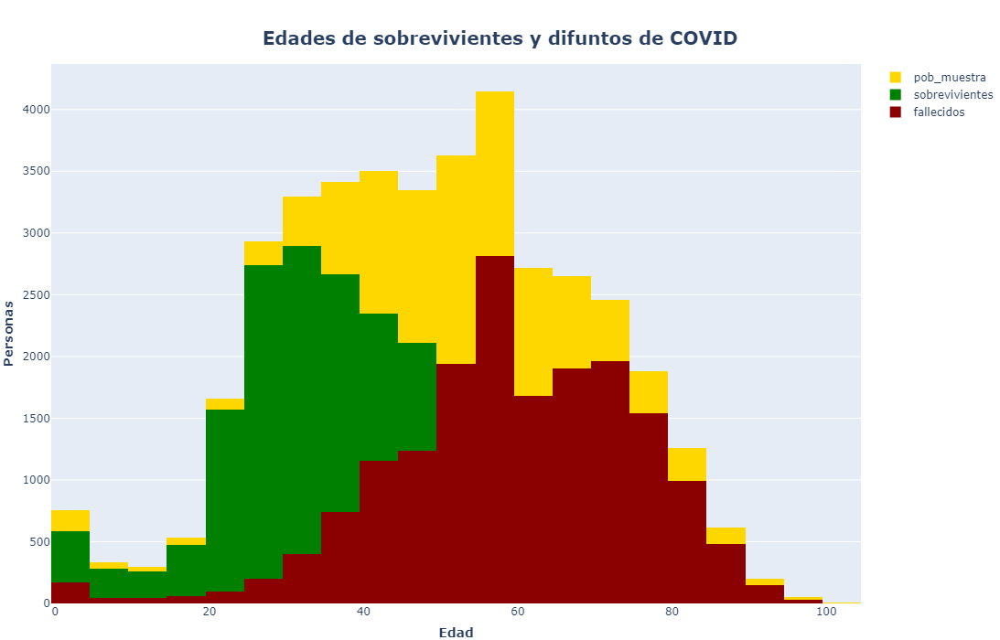

In [88]:
fig = go.Figure(layout = layout)
DIF_EDAD = COVID_REMUESTREADO_2[["EDAD", "DIFUNTO"]]
SUP_EDAD = COVID_REMUESTREADO_2[["EDAD", "DIFUNTO"]]

DIF_EDAD = DIF_EDAD[DIF_EDAD["DIFUNTO"]==1]
SUP_EDAD = SUP_EDAD[SUP_EDAD["DIFUNTO"]==0]
fig.add_trace(go.Histogram(x = COVID_REMUESTREADO_2.EDAD, xbins=go.histogram.XBins(size=5), marker=go.histogram.Marker(color="gold"),name = 'pob_muestra'))
fig.add_trace(go.Histogram(x = SUP_EDAD.EDAD, xbins=go.histogram.XBins(size=5), marker=go.histogram.Marker(color="green"),name = 'sobrevivientes'))
fig.add_trace(go.Histogram(x = DIF_EDAD.EDAD, xbins=go.histogram.XBins(size=5), marker=go.histogram.Marker(color="darkred"),name = 'fallecidos'))

fig.update_xaxes(title_text="<b>Edad</b>")
fig.update_yaxes(title_text="<b>Personas</b>")
fig.update_layout(
    width=900,
    height=700,
     title={
   'text': "<b>Edades de sobrevivientes y difuntos de COVID</b>",
        'font': {
            'size': 20,
        },
        'x': 0.5,
        'y': 0.95,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    margin=dict(t=70, l=0, r=0, b=0),
    barmode='overlay'
)
fig.show()

In [89]:
pd.set_option('display.max_columns', None)
COVID_REMUESTREADO_2.describe().T.drop(columns = ["count", "mean", "std"])

,min,25%,50%,75%,max
id,102.0,15794.5,31350.5,2982820.25,7276530.0
RESULTADO,1.0,1.0,2.0,2.00,2.0
SEXO,1.0,1.0,2.0,2.00,2.0
TIPO_PACIENTE,1.0,1.0,2.0,2.00,2.0
INTUBADO,1.0,2.0,2.0,2.00,2.0
NEUMONIA,1.0,1.0,2.0,2.00,2.0
EDAD,0.0,35.0,49.0,62.00,101.0
EMBARAZO,1.0,2.0,2.0,2.00,2.0
DIABETES,1.0,2.0,2.0,2.00,2.0
EPOC,1.0,2.0,2.0,2.00,2.0


In [90]:
df_COVID = COVID_REMUESTREADO_2.select_dtypes(include=['object', 'float64', 'int64'])
df_COVID = df_COVID.drop(columns =["id"])
df_COVID.head()
print("VALORES QUE PUEDEN TOMAR LAS VARIABLES DE LA BASE DE DATOS")
for col in df_COVID.columns:
  print(f"{col}: \n{df_COVID[col].unique()}\n")

VALORES QUE PUEDEN TOMAR LAS VARIABLES DE LA BASE DE DATOS
RESULTADO: 
[1 2]

SEXO: 
[1 2]

TIPO_PACIENTE: 
[2 1]

INTUBADO: 
[2 1]

NEUMONIA: 
[1 2]

EDAD: 
[ 60  49  62  61  63  40  48  41  38  52  59  46  47  36  66  42  35  56
  39  73  58  57  67  55  33  43  71  64  44  26  45  53  28  50  78  54
  30  24  37  34  25  51  76  69  68  29  22  79  74  70  65  31  20  77
  88  91  75  27  83  17  80  32  72  13  12  23  86  21  82   9  85  92
   8  18   4  93  84  90  81  16  15   5   2  19  87   3  14   1   7  99
  89  95  11  10   6   0  94  98 100  96 101  97]

EMBARAZO: 
[2 1]

DIABETES: 
[2 1]

EPOC: 
[2 1]

ASMA: 
[2 1]

INMUSUPR: 
[2 1]

HIPERTENSION: 
[1 2]

OTRA_COM: 
[2 1]

CARDIOVASCULAR: 
[2 1]

OBESIDAD: 
[1 2]

RENAL_CRONICA: 
[2 1]

TABAQUISMO: 
[2 1]

UCI: 
[2 1]

RANGO_EDADES: 
[4. 3. 5. 2. 1.]



In [91]:
#SE CORRIGEN LOS DATOS GENERADOS COMO "EMBARAZADOS HOMBRES" A "EMBARAZADAS MUJERES" POR ERRORES EN DATOS GENERADOS (2 datos erróneos generados)
FILTRO_EMBARAZO = COVID_REMUESTREADO_2[COVID_REMUESTREADO_2["EMBARAZO"] == 1]
FILTRO_EMBARAZO["SEXO"] = FILTRO_EMBARAZO["SEXO"].replace(2, 1)
COVID_REMUESTREADO_2.loc[COVID_REMUESTREADO_2["EMBARAZO"] == 1, "SEXO"] = FILTRO_EMBARAZO["SEXO"]

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\202852519.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [92]:
# Prueba de chi cuadrada para determinar si existe una relación entre los pacientes difuntos y los pacientes con neumonía
filtro_intubados = COVID_REMUESTREADO_2[["DIFUNTO","NEUMONIA"]]
filtro_intubados_filtrado = filtro_intubados[filtro_intubados["NEUMONIA"].isin([1,2])]
cuenta = filtro_intubados_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='NEUMONIA', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

NEUMONIA      1      2
DIFUNTO               
0          3136  18914
1         12701   4939

Chi-cuadrado: 13640.627807747273

p-value: 0.0

Grados de libertad: 1

Tabla esperada:

 [[ 8798.33333333 13251.66666667]
 [ 7038.66666667 10601.33333333]]

Valor de Cramér: 0.5862415961563349

EXISTE RELACIÓN ENTRE LAS VARIABLES


C:\Users\marie\AppData\Local\Temp\ipykernel_9108\1095400910.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.

C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [93]:
# Prueba de chi cuadrada para determinar si existe una relación entre los pacientes difuntos y los pacientes que pasaron por UCI
filtro_UCI = COVID_REMUESTREADO_2[["DIFUNTO","UCI"]]
filtro_UCI_filtrado = filtro_UCI[filtro_UCI["UCI"].isin([1,2])]
cuenta = filtro_UCI_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='UCI', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

UCI         1      2
DIFUNTO             
0         373  21677
1        2171  15469

Chi-cuadrado: 1839.2231777531783

p-value: 0.0

Grados de libertad: 1

Tabla esperada:

 [[ 1413.33333333 20636.66666667]
 [ 1130.66666667 16509.33333333]]

Valor de Cramér: 0.21526660728845975

EXISTE UNA ASOCIACIÓN PEQUEÑA ENTRE LAS VARIABLES


C:\Users\marie\AppData\Local\Temp\ipykernel_9108\1917413785.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.

C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [94]:
#ASOCIACIÓN ENTRE DIABETES Y DIFUNTOS
filtro = COVID_REMUESTREADO_2[["DIFUNTO","DIABETES"]]
filtro_filtrado = filtro[filtro["DIABETES"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='DIABETES', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

DIABETES     1      2
DIFUNTO              
0         2346  19704
1         7011  10629

Chi-cuadrado: 4606.089891975442

p-value: 0.0

Grados de libertad: 1

Tabla esperada:

 [[ 5198.33333333 16851.66666667]
 [ 4158.66666667 13481.33333333]]

Valor de Cramér: 0.34066354012139066

EXISTE RELACIÓN ENTRE LAS VARIABLES


C:\Users\marie\AppData\Local\Temp\ipykernel_9108\607093795.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.

C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [95]:
#ASOCIACIÓN ENTRE EPOC Y DIFUNTOS
filtro = COVID_REMUESTREADO_2[["DIFUNTO","EPOC"]]
filtro_filtrado = filtro[filtro["EPOC"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='EPOC', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

EPOC       1      2
DIFUNTO            
0        581  21469
1        786  16854

Chi-cuadrado: 97.15764412620554

p-value: 6.402163905625449e-23

Grados de libertad: 1

Tabla esperada:

 [[  759.44444444 21290.55555556]
 [  607.55555556 17032.44444444]]

Valor de Cramér: 0.0494763824914937

\LA ASOCIACIÓN ENTRE LAS VARIABLES ES SIGNIFICATIVA PERO MUY PEQUEÑA


C:\Users\marie\AppData\Local\Temp\ipykernel_9108\2296734883.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.

C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [96]:
#ASOCIACIÓN ENTRE ASMA Y DIFUNTOS
filtro = COVID_REMUESTREADO_2[["DIFUNTO","ASMA"]]
filtro_filtrado = filtro[filtro["ASMA"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='ASMA', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

ASMA        1      2
DIFUNTO             
0        1188  20862
1         119  17521

Chi-cuadrado: 682.1123015763225

p-value: 2.3204565475387814e-150

Grados de libertad: 1

Tabla esperada:

 [[  726.11111111 21323.88888889]
 [  580.88888889 17059.11111111]]

Valor de Cramér: 0.1310953814285817

EXISTE UNA ASOCIACIÓN PEQUEÑA ENTRE LAS VARIABLES


C:\Users\marie\AppData\Local\Temp\ipykernel_9108\531276922.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.

C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [97]:
#ASOCIACIÓN ENTRE PACIENTES INMUNUSUPRIMIDOS Y DIFUNTOS
filtro = COVID_REMUESTREADO_2[["DIFUNTO","INMUSUPR"]]
filtro_filtrado = filtro[filtro["INMUSUPR"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='INMUSUPR', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

INMUSUPR    1      2
DIFUNTO             
0         587  21463
1         385  17255

Chi-cuadrado: 9.235551778242677

p-value: 0.0023736086459841626

Grados de libertad: 1

Tabla esperada:

 [[  540. 21510.]
 [  432. 17208.]]

Valor de Cramér: 0.015254250512099323

\LA ASOCIACIÓN ENTRE LAS VARIABLES ES SIGNIFICATIVA PERO MUY PEQUEÑA


C:\Users\marie\AppData\Local\Temp\ipykernel_9108\1897224756.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.

C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [98]:
#ASOCIACIÓN ENTRE PACIENTES HIPERTENSOS Y DIFUNTOS
filtro = COVID_REMUESTREADO_2[["DIFUNTO","HIPERTENSION"]]
filtro_filtrado = filtro[filtro["HIPERTENSION"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='HIPERTENSION', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\300782429.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.



HIPERTENSION     1      2
DIFUNTO                  
0             3423  18627
1             7537  10103

Chi-cuadrado: 3626.695620851207

p-value: 0.0

Grados de libertad: 1

Tabla esperada:

 [[ 6088.88888889 15961.11111111]
 [ 4871.11111111 12768.88888889]]

Valor de Cramér: 0.3022838914693513

EXISTE RELACIÓN ENTRE LAS VARIABLES


C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [99]:
#ASOCIACIÓN ENTRE PACIENTES CON ENFERMEDAD CARDIVASCULAR Y DIFUNTOS
filtro = COVID_REMUESTREADO_2[["DIFUNTO","CARDIOVASCULAR"]]
filtro_filtrado = filtro[filtro["CARDIOVASCULAR"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='CARDIOVASCULAR', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

CARDIOVASCULAR    1      2
DIFUNTO                   
0               690  21360
1               736  16904

Chi-cuadrado: 30.483014111986858

p-value: 3.368025585693588e-08

Grados de libertad: 1

Tabla esperada:

 [[  792.22222222 21257.77777778]
 [  633.77777778 17006.22222222]]

Valor de Cramér: 0.027713310275742562

\LA ASOCIACIÓN ENTRE LAS VARIABLES ES SIGNIFICATIVA PERO MUY PEQUEÑA


C:\Users\marie\AppData\Local\Temp\ipykernel_9108\638847183.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.

C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [100]:
#ASOCIACIÓN ENTRE PACIENTES CON ENFERMEDAD OBESIDAD Y DIFUNTOS
filtro = COVID_REMUESTREADO_2[["DIFUNTO","OBESIDAD"]]
filtro_filtrado = filtro[filtro["OBESIDAD"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='OBESIDAD', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

OBESIDAD     1      2
DIFUNTO              
0         3101  18949
1         4078  13562

Chi-cuadrado: 541.6588680059466

p-value: 8.213916610501275e-120

Grados de libertad: 1

Tabla esperada:

 [[ 3988.33333333 18061.66666667]
 [ 3190.66666667 14449.33333333]]

Valor de Cramér: 0.11682139270289822

EXISTE UNA ASOCIACIÓN PEQUEÑA ENTRE LAS VARIABLES


C:\Users\marie\AppData\Local\Temp\ipykernel_9108\3981889474.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.

C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [101]:
#ASOCIACIÓN ENTRE PACIENTES CON ENFERMEDAD RENAL CRÓNICA Y DIFUNTOS
filtro = COVID_REMUESTREADO_2[["DIFUNTO","RENAL_CRONICA"]]
filtro_filtrado = filtro[filtro["RENAL_CRONICA"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='RENAL_CRONICA', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\268509621.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.



RENAL_CRONICA     1      2
DIFUNTO                   
0               427  21623
1              1118  16522

Chi-cuadrado: 506.27748407011063

p-value: 4.093863039893653e-112

Grados de libertad: 1

Tabla esperada:

 [[  858.33333333 21191.66666667]
 [  686.66666667 16953.33333333]]

Valor de Cramér: 0.11294155350976477

EXISTE UNA ASOCIACIÓN PEQUEÑA ENTRE LAS VARIABLES


C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [102]:
#ASOCIACIÓN ENTRE PACIENTES CON TABAQUISMO Y DIFUNTOS
filtro = COVID_REMUESTREADO_2[["DIFUNTO","TABAQUISMO"]]
filtro_filtrado = filtro[filtro["TABAQUISMO"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='TABAQUISMO', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

TABAQUISMO     1      2
DIFUNTO                
0           2267  19783
1           1263  16377

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\218601994.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.

C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)





Chi-cuadrado: 117.44633224483104

p-value: 2.292192601949719e-27

Grados de libertad: 1

Tabla esperada:

 [[ 1961.11111111 20088.88888889]
 [ 1568.88888889 16071.11111111]]

Valor de Cramér: 0.05439752993852038

\LA ASOCIACIÓN ENTRE LAS VARIABLES ES SIGNIFICATIVA PERO MUY PEQUEÑA


In [103]:
#ASOCIACIÓN ENTRE PACIENTES INTUBADOS Y DIFUNTOS
filtro = COVID_REMUESTREADO_2[["DIFUNTO","INTUBADO"]]
filtro_filtrado = filtro[filtro["INTUBADO"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='INTUBADO', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

INTUBADO     1      2
DIFUNTO              
0          295  21755
1         3176  14464

Chi-cuadrado: 3409.013871687439

p-value: 0.0

Grados de libertad: 1

Tabla esperada:

 [[ 1928.33333333 20121.66666667]
 [ 1542.66666667 16097.33333333]]

Valor de Cramér: 0.2930716671023259

EXISTE RELACIÓN ENTRE LAS VARIABLES


C:\Users\marie\AppData\Local\Temp\ipykernel_9108\3695982519.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.

C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [104]:
#ASOCIACIÓN ENTRE PACIENTES CON OTRAS CONMORBILIDADES Y DIFUNTOS
filtro = COVID_REMUESTREADO_2[["DIFUNTO","OTRA_COM"]]
filtro_filtrado = filtro[filtro["OTRA_COM"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='OTRA_COM', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\3574950561.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.



OTRA_COM     1      2
DIFUNTO              
0         1572  20478
1          797  16843

Chi-cuadrado: 118.58282346982087

p-value: 1.292432986553494e-27

Grados de libertad: 1

Tabla esperada:

 [[ 1316.11111111 20733.88888889]
 [ 1052.88888889 16587.11111111]]

Valor de Cramér: 0.05466009018519073

\LA ASOCIACIÓN ENTRE LAS VARIABLES ES SIGNIFICATIVA PERO MUY PEQUEÑA


C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



In [105]:
#ASOCIACIÓN ENTRE PACIENTES EMBARAZADAS Y DIFUNTOS
filtro = COVID_REMUESTREADO_2[["DIFUNTO","EMBARAZO"]]
filtro_filtrado = filtro[filtro["EMBARAZO"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='EMBARAZO', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

C:\Users\marie\AppData\Local\Temp\ipykernel_9108\1941648559.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.



EMBARAZO    1      2
DIFUNTO             
0         258  21792
1           8  17632

Chi-cuadrado: 184.53680157091063

p-value: 4.9535766062526605e-42

Grados de libertad: 1

Tabla esperada:

 [[  147.77777778 21902.22222222]
 [  118.22222222 17521.77777778]]


C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)




Valor de Cramér: 0.06818689978556074

\LA ASOCIACIÓN ENTRE LAS VARIABLES ES SIGNIFICATIVA PERO MUY PEQUEÑA


In [106]:
#ASOCIACIÓN ENTRE SEXO DEL PACIENTE Y DIFUNTOS
filtro = COVID_REMUESTREADO_2[["DIFUNTO","SEXO"]]
filtro_filtrado = filtro[filtro["SEXO"].isin([1,2])]
cuenta = filtro_filtrado.value_counts().reset_index(name='CUENTA')
contingency_table = pd.pivot_table(cuenta, values='CUENTA', index='DIFUNTO', columns='SEXO', aggfunc=sum, fill_value=0)
print(contingency_table)
prueba_chi_cuadrada(contingency_table)

SEXO         1      2
DIFUNTO              
0        11534  10516
1         6220  11420

Chi-cuadrado: 1151.3360218002383

p-value: 2.298910582523967e-252

Grados de libertad: 1

Tabla esperada:

 [[ 9863.33333333 12186.66666667]
 [ 7890.66666667  9749.33333333]]

Valor de Cramér: 0.1703179796882744

EXISTE UNA ASOCIACIÓN PEQUEÑA ENTRE LAS VARIABLES


C:\Users\marie\AppData\Local\Temp\ipykernel_9108\3121958699.py:5: FutureWarning:

The provided callable <built-in function sum> is currently using DataFrameGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.

C:\Users\marie\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning:

The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)



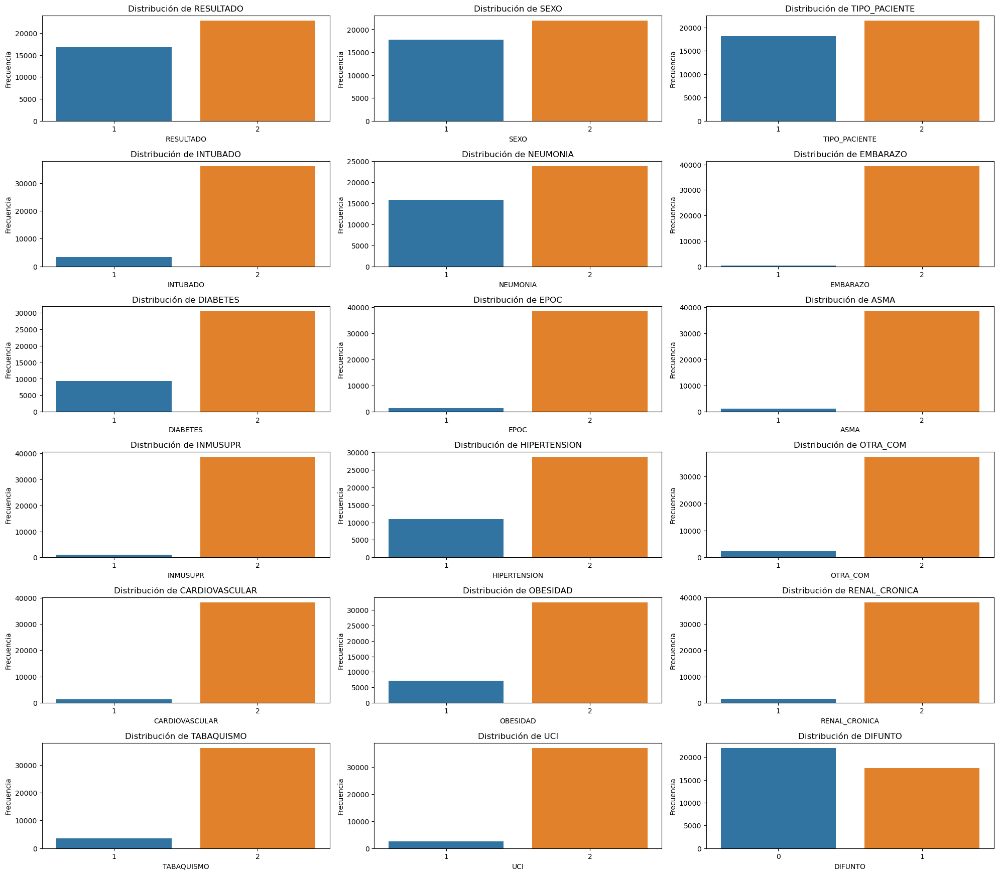

In [107]:
plt.figure(figsize=(20, 20))
DF_CATEGORIAS = COVID_REMUESTREADO_2.drop(columns = ["EDAD","id", "RANGO_EDADES"])
num_columns = len(DF_CATEGORIAS.columns)

for i, column in enumerate(DF_CATEGORIAS.columns, 1):
    plt.subplot(num_columns // 3 + 1, 3, i)
    sns.countplot(x=COVID_REMUESTREADO_2[column])
    plt.title(f'Distribución de {column}')
    plt.xlabel(column)
    plt.ylabel('Frecuencia')

plt.tight_layout()
plt.show()

C:\Users\marie\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


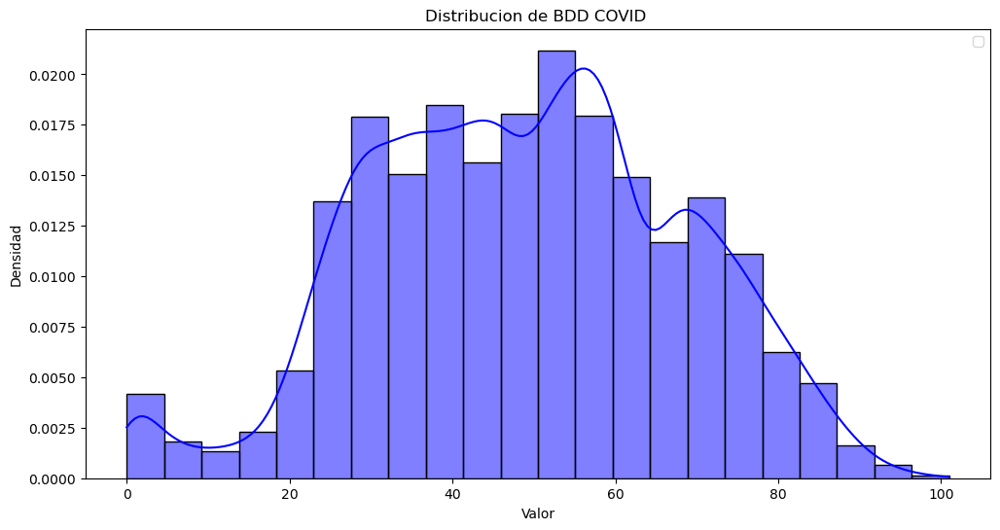

In [108]:
plt.figure(figsize=(12, 6))

sns.histplot(COVID_REMUESTREADO_2["EDAD"], color='blue', kde=True, stat="density", bins=22)
plt.title('Distribucion de BDD COVID ')
plt.xlabel('Valor')
plt.ylabel('Densidad')
plt.legend()
plt.show()

In [109]:
print("DISTRIBUCION DE EDADES REMUESTREADA")
mean = COVID_REMUESTREADO_2["EDAD"].mean()
median = COVID_REMUESTREADO_2["EDAD"].median()
mode = COVID_REMUESTREADO_2["EDAD"].mode()
skew2 =COVID_REMUESTREADO_2["EDAD"].skew()
kurt2 = COVID_REMUESTREADO_2["EDAD"].kurt()
var2 = COVID_REMUESTREADO_2["EDAD"].var()

print("La media es:", mean)
print("La mediana es:", median)
print("La moda es:", mode)
print("El sesgo es:", skew2)
print("La kurtosis es:", kurt2)
print("La varianza es:", var2)

DISTRIBUCION DE EDADES REMUESTREADA
La media es: 48.89100529100529
La mediana es: 49.0
La moda es: 0    55
Name: EDAD, dtype: int64
El sesgo es: -0.09484006575824612
La kurtosis es: -0.42062210142243917
La varianza es: 366.95730527069327


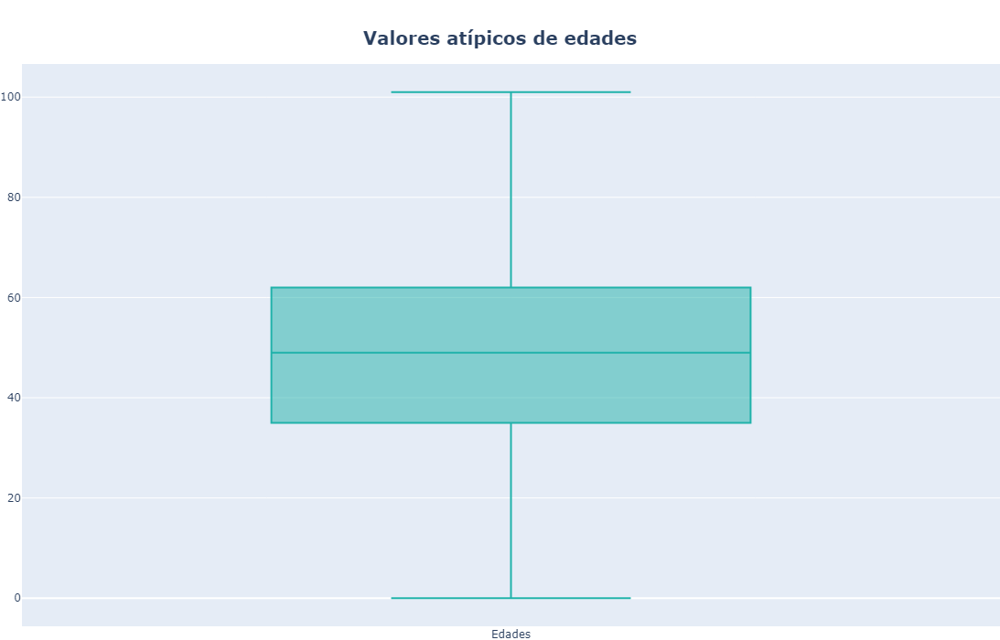

In [110]:
y0 = COVID_REMUESTREADO_2["EDAD"]
fig = go.Figure()
fig.update_layout(
    width=700,
    height=700,
     title={
   'text': "<b>Valores atípicos de edades</b>",
        'font': {
            'size': 20,
        },
        'x': 0.5,
        'y': 0.95,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    margin=dict(t=70, l=0, r=0, b=0),
)
fig.add_trace(go.Box(y=y0, name= "Edades",marker_color = 'lightseagreen'))
fig.show()

In [111]:
exclude_cols = ["id", "EDAD", "RANGO_EDADES", "DIFUNTO", "RESULTADO", "SEXO", "TIPO_PACIENTE"]
COVID_PRUEBA_RELACION_ENFERMEDADES= COVID_REMUESTREADO_2.copy()
columnas = [col for col in COVID_PRUEBA_RELACION_ENFERMEDADES.columns if col not in exclude_cols]
for columna in columnas:
    COVID_PRUEBA_RELACION_ENFERMEDADES[columna] = COVID_PRUEBA_RELACION_ENFERMEDADES[columna].replace(2,0)

## **Modelado de datos**

In [112]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split,  KFold, cross_validate,  RandomizedSearchCV, GridSearchCV, cross_val_score, KFold, cross_val_predict
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, ConfusionMatrixDisplay, make_scorer, precision_score, recall_score, fbeta_score

from scipy.stats import randint

from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn import linear_model

In [113]:
def clases_sup_dif_COVID(columna_dataframe, nc1, nc2):
    
    if columna_dataframe[nc1] == 1 and columna_dataframe[nc2] == 0:
        return "VIVO COVID CONFIRMADO"
    elif columna_dataframe[nc1] == 2 and columna_dataframe[nc2] == 0:
        return "VIVO COVID SOSPECHOSO"
    elif columna_dataframe[nc1] == 1 and columna_dataframe[nc2] == 1:
        return "MUERTO COVID CONFIRMADO"
    elif columna_dataframe[nc1] == 2 and columna_dataframe[nc2] == 1:
        return "MUERTO COVID SOSPECHOSO"

In [114]:
scoring = {
    'accuracy': make_scorer(accuracy_score),
    'precision': make_scorer(precision_score, average='weighted'),
    'recall': make_scorer(recall_score, average='weighted'),
    'f2_score': make_scorer(fbeta_score, beta=2, average='weighted')
}

In [115]:
scaler = MinMaxScaler()
COVID_BDD_PROCESADA = COVID_REMUESTREADO_2.copy()
X = COVID_BDD_PROCESADA[['EDAD']]
X_scaled = scaler.fit_transform(X)
COVID_BDD_PROCESADA['EDAD'] = X_scaled
COVID_BDD_PROCESADA

,id,RESULTADO,SEXO,TIPO_PACIENTE,INTUBADO,NEUMONIA,EDAD,EMBARAZO,DIABETES,EPOC,ASMA,INMUSUPR,HIPERTENSION,OTRA_COM,CARDIOVASCULAR,OBESIDAD,RENAL_CRONICA,TABAQUISMO,UCI,RANGO_EDADES,DIFUNTO
0,33195,1,1,2,2,1,0.594059,2,2,2,2,2,1,2,2,1,2,2,2,4.0,0
1,13708,2,1,1,2,2,0.485149,2,2,2,2,2,2,2,2,2,2,2,2,3.0,0
2,4969,1,1,2,2,1,0.613861,2,2,2,2,2,1,2,2,2,2,2,2,4.0,0
3,15085,2,2,1,2,2,0.603960,2,2,2,2,2,2,2,2,1,2,2,2,4.0,0
4,33199,1,2,2,2,1,0.623762,2,2,2,2,2,2,2,2,2,2,2,2,4.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39685,5265678,1,2,2,2,2,0.702970,2,2,2,2,2,1,2,2,2,2,2,2,5.0,1
39686,6758100,1,2,2,2,2,0.861386,2,2,1,2,2,1,2,2,2,2,1,2,5.0,1
39687,7092408,1,2,1,2,2,0.742574,2,2,2,2,2,2,2,2,2,2,2,2,5.0,1
39688,242873,2,2,2,2,2,0.455446,2,2,2,2,2,2,2,2,1,2,2,2,3.0,1


In [116]:
exclude_cols = ["id", "EDAD", "RANGO_EDADES", "DIFUNTO", "RESULTADO", "SEXO", "TIPO_PACIENTE"]
columnas = [col for col in COVID_BDD_PROCESADA.columns if col not in exclude_cols]
for columna in columnas:
    COVID_BDD_PROCESADA[columna] = COVID_BDD_PROCESADA[columna].replace(2,0)

COVID_BDD_PROCESADA['CONFIRMADOS_SOSPECHOSOS_COVID'] = COVID_BDD_PROCESADA.apply(lambda row: clases_sup_dif_COVID(row, 'RESULTADO', 'DIFUNTO'), axis=1)
COVID_BDD_PROCESADA

,id,RESULTADO,SEXO,TIPO_PACIENTE,INTUBADO,NEUMONIA,EDAD,EMBARAZO,DIABETES,EPOC,ASMA,INMUSUPR,HIPERTENSION,OTRA_COM,CARDIOVASCULAR,OBESIDAD,RENAL_CRONICA,TABAQUISMO,UCI,RANGO_EDADES,DIFUNTO,CONFIRMADOS_SOSPECHOSOS_COVID
0,33195,1,1,2,0,1,0.594059,0,0,0,0,0,1,0,0,1,0,0,0,4.0,0,VIVO COVID CONFIRMADO
1,13708,2,1,1,0,0,0.485149,0,0,0,0,0,0,0,0,0,0,0,0,3.0,0,VIVO COVID SOSPECHOSO
2,4969,1,1,2,0,1,0.613861,0,0,0,0,0,1,0,0,0,0,0,0,4.0,0,VIVO COVID CONFIRMADO
3,15085,2,2,1,0,0,0.603960,0,0,0,0,0,0,0,0,1,0,0,0,4.0,0,VIVO COVID SOSPECHOSO
4,33199,1,2,2,0,1,0.623762,0,0,0,0,0,0,0,0,0,0,0,0,4.0,0,VIVO COVID CONFIRMADO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39685,5265678,1,2,2,0,0,0.702970,0,0,0,0,0,1,0,0,0,0,0,0,5.0,1,MUERTO COVID CONFIRMADO
39686,6758100,1,2,2,0,0,0.861386,0,0,1,0,0,1,0,0,0,0,1,0,5.0,1,MUERTO COVID CONFIRMADO
39687,7092408,1,2,1,0,0,0.742574,0,0,0,0,0,0,0,0,0,0,0,0,5.0,1,MUERTO COVID CONFIRMADO
39688,242873,2,2,2,0,0,0.455446,0,0,0,0,0,0,0,0,1,0,0,0,3.0,1,MUERTO COVID SOSPECHOSO


In [117]:
exclude_cols = ["id", "EDAD", "RANGO_EDADES", "DIFUNTO", "CONFIRMADOS_SOSPECHOSOS_COVID","RESULTADO", "SEXO", "TIPO_PACIENTE","INTUBADO", "UCI"]#,"NEUMONIA", "EMBARAZO", "NEUMONIA","INMUSUPR","TABAQUISMO"]
columnas = [col for col in COVID_BDD_PROCESADA.columns if col not in exclude_cols]
COVID_BDD_PROCESADA["CANT_ENF"] = 0
for columna in columnas:
    COVID_BDD_PROCESADA["CANT_ENF"] += COVID_BDD_PROCESADA[columna]

#COVID_BDD_PROCESADA["Riesgo"] = COVID_BDD_PROCESADA["CANT_ENF"] * ( COVID_BDD_PROCESADA["TIPO_PACIENTE"] + 4*COVID_BDD_PROCESADA["INTUBADO"] + 3*COVID_BDD_PROCESADA["UCI"] + 5*COVID_BDD_PROCESADA["NEUMONIA"] )
COVID_BDD_PROCESADA

,id,RESULTADO,SEXO,TIPO_PACIENTE,INTUBADO,NEUMONIA,EDAD,EMBARAZO,DIABETES,EPOC,ASMA,INMUSUPR,HIPERTENSION,OTRA_COM,CARDIOVASCULAR,OBESIDAD,RENAL_CRONICA,TABAQUISMO,UCI,RANGO_EDADES,DIFUNTO,CONFIRMADOS_SOSPECHOSOS_COVID,CANT_ENF
0,33195,1,1,2,0,1,0.594059,0,0,0,0,0,1,0,0,1,0,0,0,4.0,0,VIVO COVID CONFIRMADO,3
1,13708,2,1,1,0,0,0.485149,0,0,0,0,0,0,0,0,0,0,0,0,3.0,0,VIVO COVID SOSPECHOSO,0
2,4969,1,1,2,0,1,0.613861,0,0,0,0,0,1,0,0,0,0,0,0,4.0,0,VIVO COVID CONFIRMADO,2
3,15085,2,2,1,0,0,0.603960,0,0,0,0,0,0,0,0,1,0,0,0,4.0,0,VIVO COVID SOSPECHOSO,1
4,33199,1,2,2,0,1,0.623762,0,0,0,0,0,0,0,0,0,0,0,0,4.0,0,VIVO COVID CONFIRMADO,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39685,5265678,1,2,2,0,0,0.702970,0,0,0,0,0,1,0,0,0,0,0,0,5.0,1,MUERTO COVID CONFIRMADO,1
39686,6758100,1,2,2,0,0,0.861386,0,0,1,0,0,1,0,0,0,0,1,0,5.0,1,MUERTO COVID CONFIRMADO,3
39687,7092408,1,2,1,0,0,0.742574,0,0,0,0,0,0,0,0,0,0,0,0,5.0,1,MUERTO COVID CONFIRMADO,0
39688,242873,2,2,2,0,0,0.455446,0,0,0,0,0,0,0,0,1,0,0,0,3.0,1,MUERTO COVID SOSPECHOSO,1


In [118]:
X = COVID_BDD_PROCESADA.drop(columns = ["DIFUNTO", "id","RANGO_EDADES","CONFIRMADOS_SOSPECHOSOS_COVID"])
Y = COVID_BDD_PROCESADA["CONFIRMADOS_SOSPECHOSOS_COVID"]

X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2)

## **Modelo de árbol de decisiones**

Exactitud del modelo: 0.88

Reporte de Clasificación:
                         precision    recall  f1-score   support

MUERTO COVID CONFIRMADO       0.89      0.94      0.92      2563
MUERTO COVID SOSPECHOSO       0.73      0.77      0.75      1062
  VIVO COVID CONFIRMADO       0.81      0.69      0.74       911
  VIVO COVID SOSPECHOSO       0.93      0.91      0.92      3402

               accuracy                           0.88      7938
              macro avg       0.84      0.83      0.83      7938
           weighted avg       0.88      0.88      0.88      7938



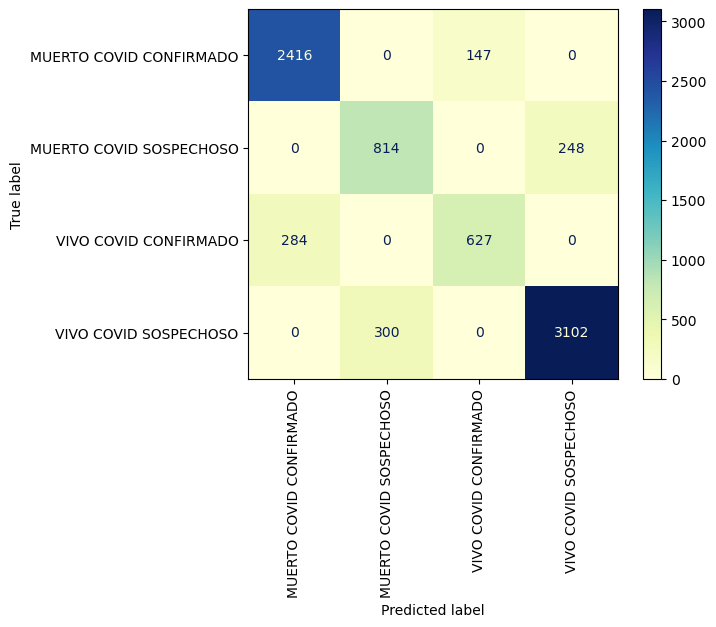

In [119]:
modelo1 = DecisionTreeClassifier(random_state = 42)
modelo1.fit(X_train, y_train)
y_pred = modelo1.predict(X_test)

# Calcular la precisión del modelo
accuracy = accuracy_score(y_test, y_pred)
print(f'Exactitud del modelo: {accuracy:.2f}')

# Mostrar métricas adicionales como el reporte de clasificación y la matriz de confusión
print("\nReporte de Clasificación:")
print(classification_report(y_test, y_pred))

cm = confusion_matrix(y_test, y_pred, labels = modelo1.classes_)

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=modelo1.classes_)
disp.plot(cmap='YlGnBu',xticks_rotation = 'vertical');

# **Optimización de hiperparámetros de árbol de decisiones**

In [120]:
# #Choosing the hyperparameters for our tree with randomized search
# #Hyperparameters space to be explored
# espacio_de_parametros = {
# "max_depth" : randint(1,25),
# "min_samples_split" : randint(3,70),
# "min_samples_leaf" : randint(3,70),
# }

In [121]:
#Choose the best tree that lead to best result in our space searched
# kfold = KFold(n_splits=5, shuffle=True)
# clf = RandomizedSearchCV(modelo1, espacio_de_parametros, cv=kfold, return_train_score=True, n_iter = 100, 
#                          scoring = 'accuracy')
# search = clf.fit(X, Y)
# results_RandomizedSearchCV = search.cv_results_
# indice_mejores_parametros = search.best_index_
# best_model = search.best_estimator_
# best_parameters = search.best_params_
# best_f1 = search.best_score_

# #Show parameters of best model
# results_RandomizedSearchCV['params'][indice_mejores_parametros]
# print('The best model was:', best_model)
# print('The best parameter values were:', best_parameters)
# print('The best f1-score was:', best_f1)

In [122]:
#Búsqueda de parámetros para árbol de decisión. Los parámetros comentados fueron los parámetros obtenidos mediante 
#random search, previo a la aplicación de este espacio de búsqueda.
# param_grid = {
#     'max_depth': [10, 12, 14], #10 #10 #14 #14 #14 #17
#     'min_samples_split': [18, 27, 32], #27 #32 #18 #12 #52 #50
#     'min_samples_leaf': [3, 10, 13], #10 #30 #13 #12 #3 #3
# }

In [123]:
# grid_search = GridSearchCV(estimator=modelo1, param_grid=param_grid, 
#                            cv=5, n_jobs=-1, verbose=2, scoring='accuracy')
# grid_search.fit(X_train, y_train)
# best_dtree_reg = grid_search.best_estimator_
# best_dtree_reg

Exactitud del modelo: 0.88

Reporte de Clasificación:
                         precision    recall  f1-score   support

MUERTO COVID CONFIRMADO       0.89      0.97      0.93      2563
MUERTO COVID SOSPECHOSO       0.72      0.84      0.77      1062
  VIVO COVID CONFIRMADO       0.88      0.66      0.75       911
  VIVO COVID SOSPECHOSO       0.95      0.90      0.92      3402

               accuracy                           0.88      7938
              macro avg       0.86      0.84      0.84      7938
           weighted avg       0.89      0.88      0.88      7938



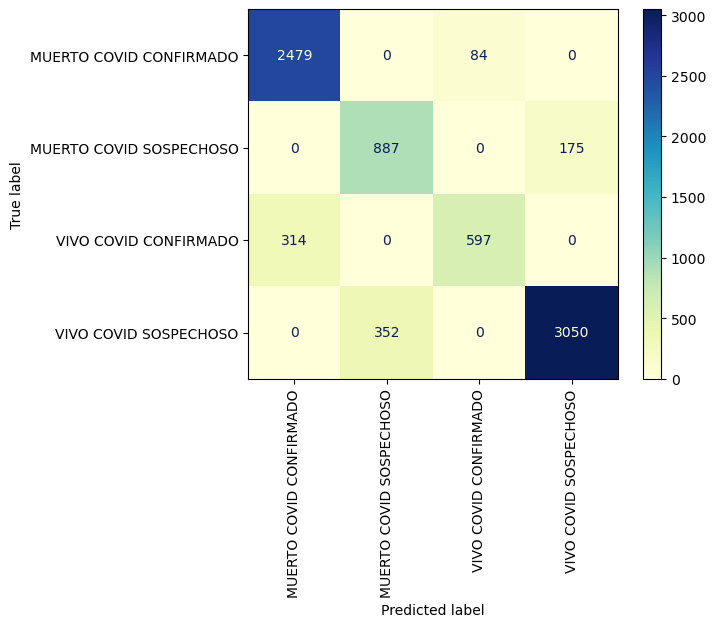

In [124]:
modelo1 = DecisionTreeClassifier(max_depth = 10, min_samples_leaf = 13, min_samples_split = 32, random_state=42)
                                
modelo1.fit(X_train, y_train)
y_pred = modelo1.predict(X_test)

# Calcular la precisión del modelo
accuracy = accuracy_score(y_test, y_pred)
print(f'Exactitud del modelo: {accuracy:.2f}')

# Mostrar métricas adicionales como el reporte de clasificación y la matriz de confusión
print("\nReporte de Clasificación:")
print(classification_report(y_test, y_pred))

cm = confusion_matrix(y_test, y_pred, labels = modelo1.classes_)

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=modelo1.classes_)
disp.plot(cmap='YlGnBu',xticks_rotation = 'vertical');

## **Modelo de bosques aleatorios**

Exactitud del modelo: 0.88

Reporte de Clasificación:
                         precision    recall  f1-score   support

MUERTO COVID CONFIRMADO       0.90      0.95      0.92      2563
MUERTO COVID SOSPECHOSO       0.76      0.76      0.76      1062
  VIVO COVID CONFIRMADO       0.82      0.69      0.75       911
  VIVO COVID SOSPECHOSO       0.93      0.93      0.93      3402

               accuracy                           0.88      7938
              macro avg       0.85      0.83      0.84      7938
           weighted avg       0.88      0.88      0.88      7938



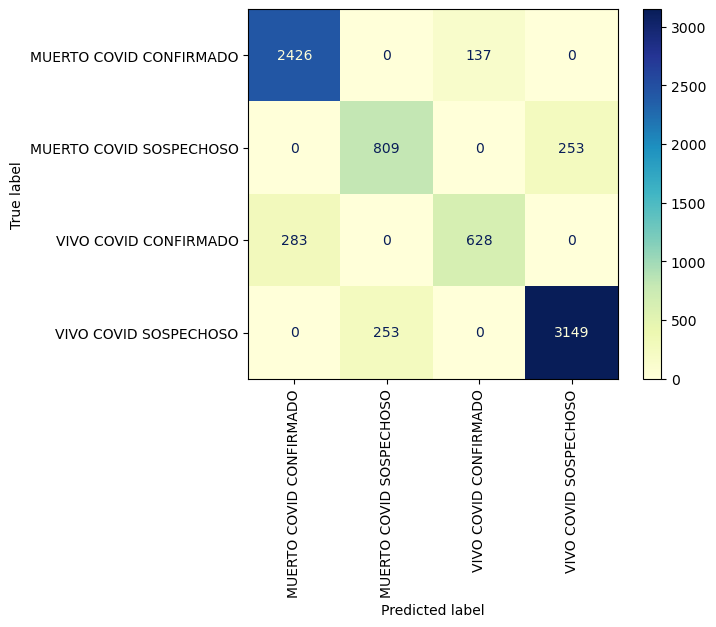

In [125]:
modelo2 = RandomForestClassifier(n_estimators = 100)
modelo2.fit(X_train, y_train)
y_pred = modelo2.predict(X_test)

# Calcular la precisión del modelo
accuracy = accuracy_score(y_test, y_pred)
print(f'Exactitud del modelo: {accuracy:.2f}')

# Mostrar métricas adicionales como el reporte de clasificación y la matriz de confusión
print("\nReporte de Clasificación:")
print(classification_report(y_test, y_pred))

cm = confusion_matrix(y_test, y_pred, labels = modelo2.classes_)

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=modelo2.classes_)
disp.plot(cmap='YlGnBu',xticks_rotation = 'vertical');

In [126]:
#Busqueda de hipeparámetros mediante búsqueda aleatoria para random forest.
# n_estimators = [int(x) for x in np.linspace(start = 100, stop = 1000, num = 10)]
# max_features = ['auto', 'sqrt']
# max_depth = [int(x) for x in np.linspace(2, 16, num = 10)]
# min_samples_split =  [12,14,32]
# min_samples_leaf = [4,10,13]
# bootstrap = [True, False]

# espacio_de_parametros = {
#                'n_estimators': n_estimators,
#                'max_features': max_features,
#                'max_depth': max_depth,
#                'min_samples_split': min_samples_split,
#                'min_samples_leaf': min_samples_leaf,
#                'bootstrap': bootstrap}
# espacio_de_parametros

In [127]:
# rf_random = RandomizedSearchCV(estimator = modelo2, param_distributions = espacio_de_parametros, cv = 5, verbose=2, random_state=42, n_jobs = -1)
# # Fit the random search model
# rf_random.fit(X_train, y_train)
# rf_random.best_params_

In [128]:
# #Grid Search para random Forest
# param_grid = {
#     'bootstrap': [False], #False #False #False
#     'max_depth': [12, 14, 13], #12 #14 #12 #12
#     'max_features': ["sqrt"], #sqrt #sqrt #sqrt
#     'min_samples_leaf': [3,4, 5], #4 #4 #4
#     'min_samples_split': [12, 14, 32], #14 #12 #32 #32
#     'n_estimators': [500] #500 #500 #500 #500
# }

In [129]:
# grid_search = GridSearchCV(estimator = modelo2, param_grid = param_grid, cv = 3, n_jobs = -1, verbose = 2)
# grid_search.fit(X_train, y_train)
# grid_search.best_params_

In [130]:
modelo2 = RandomForestClassifier(n_estimators = 500, min_samples_leaf = 3, min_samples_split = 12, max_features = 'sqrt', max_depth = 14 ,bootstrap = False, random_state=42 )
modelo2

RandomForestClassifier(bootstrap=False, max_depth=14, min_samples_leaf=3,
                       min_samples_split=12, n_estimators=500, random_state=42)

In [131]:
y_test.value_counts()

CONFIRMADOS_SOSPECHOSOS_COVID
VIVO COVID SOSPECHOSO      3402
MUERTO COVID CONFIRMADO    2563
MUERTO COVID SOSPECHOSO    1062
VIVO COVID CONFIRMADO       911
Name: count, dtype: int64

Exactitud del modelo: 0.90

Reporte de Clasificación:
                         precision    recall  f1-score   support

MUERTO COVID CONFIRMADO       0.89      0.98      0.93      2563
MUERTO COVID SOSPECHOSO       0.75      0.85      0.80      1062
  VIVO COVID CONFIRMADO       0.91      0.67      0.77       911
  VIVO COVID SOSPECHOSO       0.95      0.91      0.93      3402

               accuracy                           0.90      7938
              macro avg       0.88      0.85      0.86      7938
           weighted avg       0.90      0.90      0.90      7938



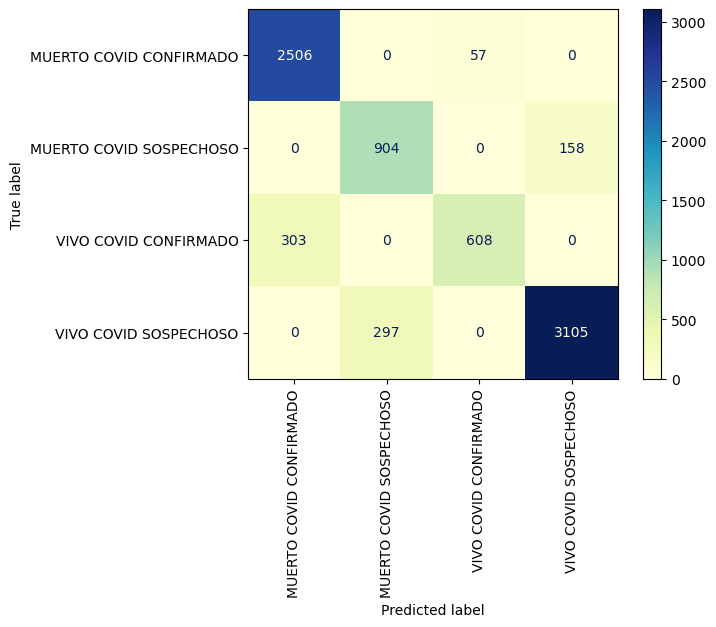

In [132]:
modelo2.fit(X_train, y_train)
y_pred = modelo2.predict(X_test)

# Calcular la precisión del modelo
accuracy = accuracy_score(y_test, y_pred)
print(f'Exactitud del modelo: {accuracy:.2f}')

print("\nReporte de Clasificación:")
print(classification_report(y_test, y_pred))

cm = confusion_matrix(y_test, y_pred, labels = modelo2.classes_)

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=modelo2.classes_)
disp.plot(cmap='YlGnBu',xticks_rotation = 'vertical');

## **Validación cruzada**

Resultados de Validación Cruzada para Árbol de Decisiones:
Accuracy: 0.8825648778029731
Precision: 0.8871751892230361
Recall: 0.8825648778029731
F2_score: 0.8814080587523356

Validación cruzada para modelo de árbol de decisiones
                         precision    recall  f1-score   support

MUERTO COVID CONFIRMADO       0.88      0.97      0.92     12281
MUERTO COVID SOSPECHOSO       0.72      0.83      0.77      5359
  VIVO COVID CONFIRMADO       0.88      0.65      0.75      4553
  VIVO COVID SOSPECHOSO       0.94      0.90      0.92     17497

               accuracy                           0.88     39690
              macro avg       0.86      0.84      0.84     39690
           weighted avg       0.89      0.88      0.88     39690



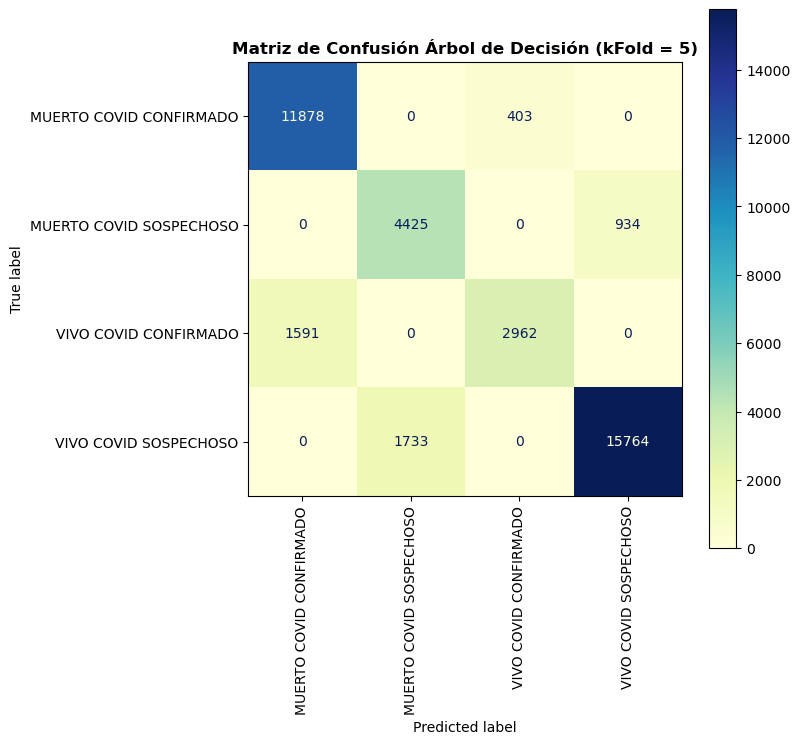

In [133]:
num_folds = 5
kf = KFold(n_splits=num_folds, shuffle=True, random_state=42)
cross_val_results_DT = cross_validate(modelo1, X, Y, cv=kf, scoring = scoring)

print("Resultados de Validación Cruzada para Árbol de Decisiones:")

for metric in scoring.keys():
    print(f'{metric.capitalize()}: {cross_val_results_DT["test_" + metric].mean()}')

print("\nValidación cruzada para modelo de árbol de decisiones")
y_pred_dt = cross_val_predict(modelo1, X, Y, cv=kf)
print(classification_report(Y, y_pred_dt))

cm = confusion_matrix(Y, y_pred_dt, labels = modelo1.classes_)
fig, ax = plt.subplots(figsize=(7, 7))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=modelo1.classes_)
disp.plot(cmap='YlGnBu',xticks_rotation = 'vertical', ax=ax);
ax.set_title('Matriz de Confusión Árbol de Decisión (kFold = 5)', weight="bold", fontsize = 12)
plt.show()

Resultados de Validación Cruzada para Bosque Aleatorio:
Accuracy: 0.8907533383723859
Precision: 0.8944916064026733
Recall: 0.8907533383723859
F2_score: 0.8893556246974631

Validación cruzada para modelo de bosques aleatorios
                         precision    recall  f1-score   support

MUERTO COVID CONFIRMADO       0.88      0.97      0.93     12281
MUERTO COVID SOSPECHOSO       0.75      0.83      0.79      5359
  VIVO COVID CONFIRMADO       0.90      0.65      0.75      4553
  VIVO COVID SOSPECHOSO       0.95      0.91      0.93     17497

               accuracy                           0.89     39690
              macro avg       0.87      0.84      0.85     39690
           weighted avg       0.89      0.89      0.89     39690



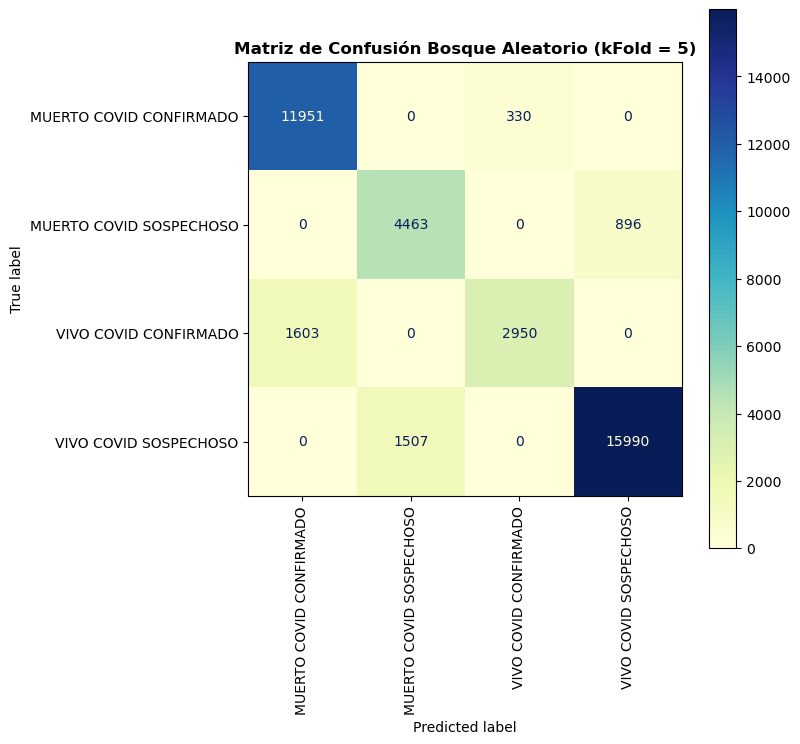

In [134]:
cross_val_results_RF = cross_validate(modelo2, X, Y, cv=kf, scoring = scoring)

print("Resultados de Validación Cruzada para Bosque Aleatorio:")

for metric in scoring.keys():
    print(f'{metric.capitalize()}: {cross_val_results_RF["test_" + metric].mean()}')

print("\nValidación cruzada para modelo de bosques aleatorios")
y_pred_rf = cross_val_predict(modelo2, X, Y, cv=kf)
print(classification_report(Y, y_pred_rf))

cm = confusion_matrix(Y, y_pred_rf, labels = modelo1.classes_)
fig, ax = plt.subplots(figsize=(7, 7))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=modelo1.classes_)
disp.plot(cmap='YlGnBu',xticks_rotation = 'vertical', ax=ax);
ax.set_title('Matriz de Confusión Bosque Aleatorio (kFold = 5)', weight="bold", fontsize = 12)
plt.show()

## **Analisis de errores**

In [135]:
Errores_DT = X.copy() 
Errores_DT["CLASIFICACION"] = Y
Errores_DT["Predichos"] = y_pred_dt
Errores_DT = Errores_DT[Errores_DT["CLASIFICACION"]!=y_pred_dt]
print("ERRORES ÁRBOL DE DECISIONES")
print("Cantidad de errores: ",len(Errores_DT))
Errores_DT.apply(lambda col: col.value_counts().reindex([0,1, 2], fill_value=0))

ERRORES ÁRBOL DE DECISIONES
Cantidad de errores:  4661


,RESULTADO,SEXO,TIPO_PACIENTE,INTUBADO,NEUMONIA,EDAD,EMBARAZO,DIABETES,EPOC,ASMA,INMUSUPR,HIPERTENSION,OTRA_COM,CARDIOVASCULAR,OBESIDAD,RENAL_CRONICA,TABAQUISMO,UCI,CANT_ENF,CLASIFICACION,Predichos
0,0,0,0,4356,2109,50,4648,3312,4320,4533,4424,3091,4236,4323,3683,4359,4152,4316,753,0,0
1,1994,1801,744,305,2552,1,13,1349,341,128,237,1570,425,338,978,302,509,345,1406,0,0
2,2667,2860,3917,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1095,0,0


In [136]:
Errores_DT["CANT_ENF"].value_counts()

CANT_ENF
1    1406
2    1095
3     804
0     753
4     371
5     169
6      42
7      16
8       4
9       1
Name: count, dtype: int64

C:\Users\marie\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


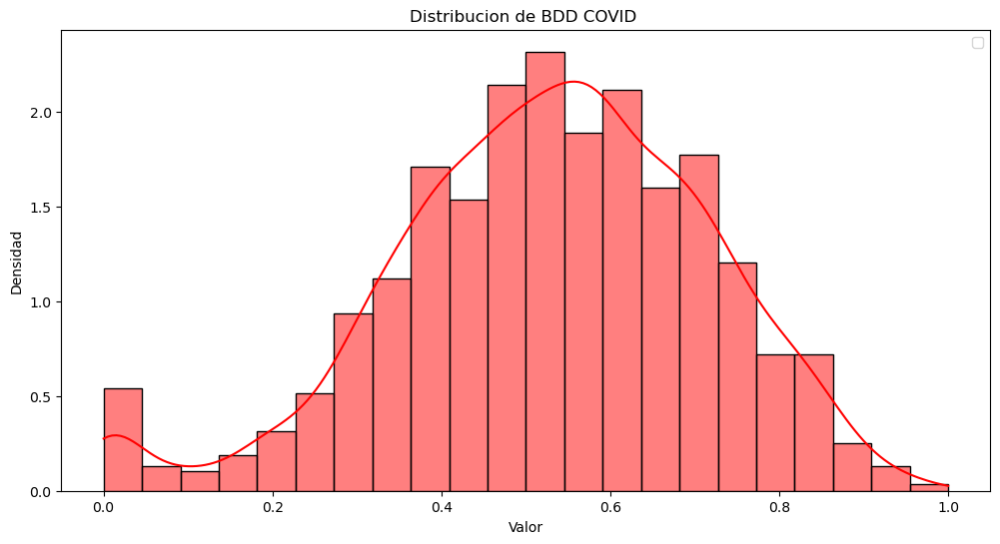

In [137]:
plt.figure(figsize=(12, 6))
sns.histplot(Errores_DT["EDAD"], color='red', kde=True, stat="density", bins=22)
plt.title('Distribucion de BDD COVID ')
plt.xlabel('Valor')
plt.ylabel('Densidad')
plt.legend()
plt.show()

In [138]:
Errores_DT.head()

,RESULTADO,SEXO,TIPO_PACIENTE,INTUBADO,NEUMONIA,EDAD,EMBARAZO,DIABETES,EPOC,ASMA,INMUSUPR,HIPERTENSION,OTRA_COM,CARDIOVASCULAR,OBESIDAD,RENAL_CRONICA,TABAQUISMO,UCI,CANT_ENF,CLASIFICACION,Predichos
0,1,1,2,0,1,0.594059,0,0,0,0,0,1,0,0,1,0,0,0,3,VIVO COVID CONFIRMADO,MUERTO COVID CONFIRMADO
2,1,1,2,0,1,0.613861,0,0,0,0,0,1,0,0,0,0,0,0,2,VIVO COVID CONFIRMADO,MUERTO COVID CONFIRMADO
4,1,2,2,0,1,0.623762,0,0,0,0,0,0,0,0,0,0,0,0,1,VIVO COVID CONFIRMADO,MUERTO COVID CONFIRMADO
6,1,2,2,1,1,0.603960,0,1,0,0,0,0,1,1,0,0,0,1,4,VIVO COVID CONFIRMADO,MUERTO COVID CONFIRMADO
7,1,1,2,0,1,0.475248,0,0,0,0,0,0,1,0,1,0,0,0,3,VIVO COVID CONFIRMADO,MUERTO COVID CONFIRMADO


In [139]:
Errores_DT[Errores_DT["Predichos"]== "VIVO COVID CONFIRMADO"]

,RESULTADO,SEXO,TIPO_PACIENTE,INTUBADO,NEUMONIA,EDAD,EMBARAZO,DIABETES,EPOC,ASMA,INMUSUPR,HIPERTENSION,OTRA_COM,CARDIOVASCULAR,OBESIDAD,RENAL_CRONICA,TABAQUISMO,UCI,CANT_ENF,CLASIFICACION,Predichos
22135,1,1,1,0,1,0.277228,0,1,0,0,0,0,0,0,0,0,0,0,2,MUERTO COVID CONFIRMADO,VIVO COVID CONFIRMADO
22178,1,1,2,0,1,0.267327,0,0,0,0,0,0,0,0,0,0,0,0,1,MUERTO COVID CONFIRMADO,VIVO COVID CONFIRMADO
22187,1,2,1,0,1,0.524752,0,1,0,0,0,0,0,0,0,0,0,0,2,MUERTO COVID CONFIRMADO,VIVO COVID CONFIRMADO
22227,1,2,1,0,0,0.742574,0,1,0,0,0,0,0,0,0,0,0,0,1,MUERTO COVID CONFIRMADO,VIVO COVID CONFIRMADO
22248,1,1,2,0,1,0.653465,0,0,0,0,0,1,0,0,1,0,0,1,3,MUERTO COVID CONFIRMADO,VIVO COVID CONFIRMADO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39515,1,2,1,0,0,0.613861,0,0,0,0,0,0,0,0,0,0,0,0,0,MUERTO COVID CONFIRMADO,VIVO COVID CONFIRMADO
39541,1,2,1,0,0,0.504950,0,0,0,0,0,1,0,0,0,0,0,0,1,MUERTO COVID CONFIRMADO,VIVO COVID CONFIRMADO
39633,1,1,1,0,0,0.554455,0,0,0,0,0,0,0,0,0,0,0,0,0,MUERTO COVID CONFIRMADO,VIVO COVID CONFIRMADO
39648,1,2,2,0,0,0.178218,0,0,0,0,0,0,0,0,0,0,0,0,0,MUERTO COVID CONFIRMADO,VIVO COVID CONFIRMADO


In [140]:
Errores_RF = X.copy() 
Errores_RF["CLASIFICACION"] = Y
Errores_RF["Predichos"] = y_pred_rf
Errores_RF = Errores_RF[Errores_RF["CLASIFICACION"]!=y_pred_rf]
print("ERRORES BOSQUE ALEATORIO")
print("Cantidad de errores: ",len(Errores_RF))
Errores_RF.apply(lambda col: col.value_counts().reindex([0,1, 2], fill_value=0))

ERRORES BOSQUE ALEATORIO
Cantidad de errores:  4336


,RESULTADO,SEXO,TIPO_PACIENTE,INTUBADO,NEUMONIA,EDAD,EMBARAZO,DIABETES,EPOC,ASMA,INMUSUPR,HIPERTENSION,OTRA_COM,CARDIOVASCULAR,OBESIDAD,RENAL_CRONICA,TABAQUISMO,UCI,CANT_ENF,CLASIFICACION,Predichos
0,0,0,0,4040,1894,50,4326,3102,4041,4245,4142,2940,3973,4063,3444,4093,3948,4026,753,0,0
1,1933,1730,691,296,2442,1,10,1234,295,91,194,1396,363,273,892,243,388,310,1319,0,0
2,2403,2606,3645,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1033,0,0


In [141]:
Errores_RF["CANT_ENF"].value_counts()

CANT_ENF
1    1319
2    1033
0     753
3     736
4     310
5     132
6      43
7      10
Name: count, dtype: int64

C:\Users\marie\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


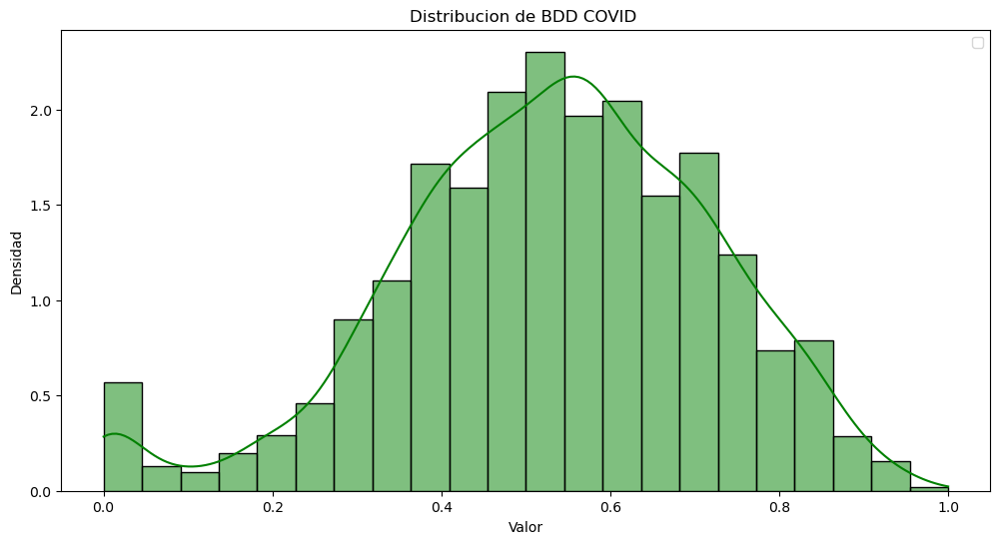

In [142]:
plt.figure(figsize=(12, 6))
sns.histplot(Errores_RF["EDAD"], color='green', kde=True, stat="density", bins=22)
plt.title('Distribucion de BDD COVID ')
plt.xlabel('Valor')
plt.ylabel('Densidad')
plt.legend()
plt.show()

In [143]:
Errores_RF

,RESULTADO,SEXO,TIPO_PACIENTE,INTUBADO,NEUMONIA,EDAD,EMBARAZO,DIABETES,EPOC,ASMA,INMUSUPR,HIPERTENSION,OTRA_COM,CARDIOVASCULAR,OBESIDAD,RENAL_CRONICA,TABAQUISMO,UCI,CANT_ENF,CLASIFICACION,Predichos
0,1,1,2,0,1,0.594059,0,0,0,0,0,1,0,0,1,0,0,0,3,VIVO COVID CONFIRMADO,MUERTO COVID CONFIRMADO
2,1,1,2,0,1,0.613861,0,0,0,0,0,1,0,0,0,0,0,0,2,VIVO COVID CONFIRMADO,MUERTO COVID CONFIRMADO
4,1,2,2,0,1,0.623762,0,0,0,0,0,0,0,0,0,0,0,0,1,VIVO COVID CONFIRMADO,MUERTO COVID CONFIRMADO
6,1,2,2,1,1,0.603960,0,1,0,0,0,0,1,1,0,0,0,1,4,VIVO COVID CONFIRMADO,MUERTO COVID CONFIRMADO
7,1,1,2,0,1,0.475248,0,0,0,0,0,0,1,0,1,0,0,0,3,VIVO COVID CONFIRMADO,MUERTO COVID CONFIRMADO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39625,2,2,2,0,0,0.277228,0,0,0,0,0,1,0,0,0,0,0,0,1,MUERTO COVID SOSPECHOSO,VIVO COVID SOSPECHOSO
39633,1,1,1,0,0,0.554455,0,0,0,0,0,0,0,0,0,0,0,0,0,MUERTO COVID CONFIRMADO,VIVO COVID CONFIRMADO
39639,2,2,1,0,0,0.346535,0,0,0,0,0,0,0,0,0,0,0,0,0,MUERTO COVID SOSPECHOSO,VIVO COVID SOSPECHOSO
39648,1,2,2,0,0,0.178218,0,0,0,0,0,0,0,0,0,0,0,0,0,MUERTO COVID CONFIRMADO,VIVO COVID CONFIRMADO


## **Comparación de modelos**

In [144]:
resultados = pd.DataFrame({
    'Decision Tree Accuracy': cross_val_results_DT['test_accuracy'],
    'Decision Tree Precision': cross_val_results_DT['test_precision'],
    'Decision Tree Recall': cross_val_results_DT['test_recall'],
    'Decision Tree F2 Score': cross_val_results_DT['test_f2_score'],
    'Random Forest Accuracy': cross_val_results_RF['test_accuracy'],
    'Random Forest Precision': cross_val_results_RF['test_precision'],
     'Random Forest Recall': cross_val_results_RF['test_recall'],
    'Random Forest F2 Score': cross_val_results_RF['test_f2_score'],
})

In [145]:
resultados

,Decision Tree Accuracy,Decision Tree Precision,Decision Tree Recall,Decision Tree F2 Score,Random Forest Accuracy,Random Forest Precision,Random Forest Recall,Random Forest F2 Score
0,0.881708,0.885313,0.881708,0.880753,0.889015,0.892705,0.889015,0.887786
1,0.884354,0.888338,0.884354,0.883320,0.892290,0.894339,0.892290,0.890865
2,0.884732,0.888521,0.884732,0.883931,0.893298,0.896302,0.893298,0.892052
3,0.878181,0.883130,0.878181,0.876371,0.889645,0.894376,0.889645,0.887781
4,0.883850,0.890573,0.883850,0.882665,0.889519,0.894736,0.889519,0.888294


In [146]:
resumen_desempeño = resultados.agg(['mean', 'std']).T
resumen_desempeño

,mean,std
Decision Tree Accuracy,0.882565,0.002716
Decision Tree Precision,0.887175,0.002938
Decision Tree Recall,0.882565,0.002716
Decision Tree F2 Score,0.881408,0.003058
Random Forest Accuracy,0.890753,0.001911
Random Forest Precision,0.894492,0.001281
Random Forest Recall,0.890753,0.001911
Random Forest F2 Score,0.889356,0.001976


In [147]:
medias = np.array(resumen_desempeño["mean"])
stdev = np.array(resumen_desempeño["std"])

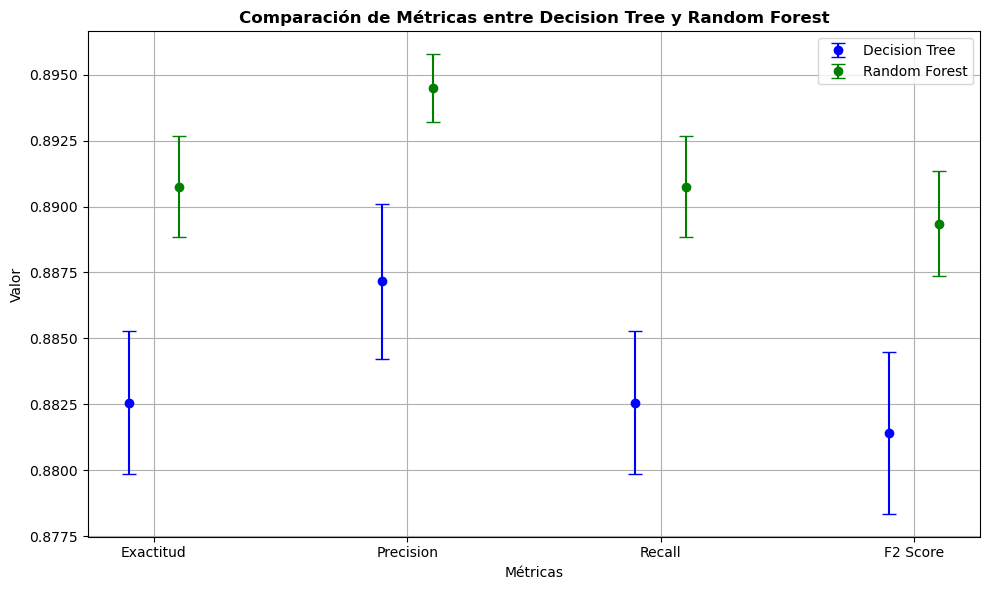

In [153]:
fig, ax = plt.subplots(figsize=(10, 6))
metricas = ['Exactitud', 'Precision', 'Recall', 'F2 Score']
modelos = ['Decision Tree', 'Random Forest']
width = 0.2 

colors = ['b', 'g', 'r', 'c']

medias = np.array(resumen_desempeño["mean"])
stdev = np.array(resumen_desempeño["std"])
x = np.arange(len(metricas))

for i, model in enumerate(modelos):
    start_idx = i * len(metricas)
    end_idx = start_idx + len(metricas)
    means_model = medias[start_idx:end_idx]
    stds_model = stdev[start_idx:end_idx]
    
    ax.errorbar(x + i*width, means_model, yerr=stds_model, fmt='o', capsize=5, label=model, color=colors[i])

ax.set_xlabel('Métricas')
ax.set_ylabel('Valor')
ax.set_title('Comparación de Métricas entre Decision Tree y Random Forest', weight = "bold")
ax.set_xticks(x + width/2)  
ax.set_xticklabels(metricas)
ax.legend()

plt.tight_layout()
plt.grid()
plt.show()

In [149]:
feature_importances = modelo1.feature_importances_

feature_importance_df = pd.DataFrame({
    'Características': X.columns,
    'Importancia en DT': feature_importances
})

feature_importance_df = feature_importance_df.sort_values(by='Importancia en DT', ascending=False)
feature_importance_df

,Características,Importancia en DT
0,RESULTADO,0.586118
2,TIPO_PACIENTE,0.309599
5,EDAD,0.047964
4,NEUMONIA,0.019120
3,INTUBADO,0.008543
18,CANT_ENF,0.006756
1,SEXO,0.005459
9,ASMA,0.003116
7,DIABETES,0.002948
16,TABAQUISMO,0.002153


In [150]:
feature_importances = modelo2.feature_importances_

feature_importance_df = pd.DataFrame({
    'Características': X.columns,
    'Importancia en RF': feature_importances
})

feature_importance_df = feature_importance_df.sort_values(by='Importancia en RF', ascending=False)
feature_importance_df

,Características,Importancia en RF
0,RESULTADO,0.547775
2,TIPO_PACIENTE,0.172552
5,EDAD,0.090015
4,NEUMONIA,0.082148
18,CANT_ENF,0.031178
7,DIABETES,0.016447
3,INTUBADO,0.012645
1,SEXO,0.008253
11,HIPERTENSION,0.007713
17,UCI,0.004841


In [151]:
#Cálculo de KPI. PFNC
pacientes_con_neumonia = COVID_REMUESTREADO_2[COVID_REMUESTREADO_2["NEUMONIA"] == 1]
cant_fallecidos_neumonia = (pacientes_con_neumonia["DIFUNTO"]==1).sum()
Casos_totales_neumonia = (COVID_REMUESTREADO_2["NEUMONIA"] == 1).sum()

PFNC = ( cant_fallecidos_neumonia / Casos_totales_neumonia) * 100
print("PFNC en remuestreo= ", PFNC, " %")

PFNC en remuestreo=  80.19826987434489  %


In [152]:
pacientes_con_neumonia_2 = COVID[COVID["NEUMONIA"] == 1]
cant_fallecidos_neumonia_2 = (pacientes_con_neumonia_2["DIFUNTO"]==1).sum()
Casos_totales_neumonia_2 = (COVID["NEUMONIA"] == 1).sum()

PFNC_2 = ( cant_fallecidos_neumonia_2 / Casos_totales_neumonia_2) * 100
print("PFNC en base de datos original= ", PFNC_2, " %")

PFNC en base de datos original=  7.476792037515552  %
